# **<span style="color:#287D8EFF">Sarcopenia Project</span>**

# <span style="color:#29AF7FFF">Table of Contents</span>

* [1. INTRODUCTION](#1)
* [2. IMPORTING MODULES, LOADING DATA & DATA REVIEW](#2)
* [3. DATA CLEANING](#3)
* [4. EXPLORATORY DATA ANALYSIS (EDA)](#4)
* [5. PREPROCESSING: ENCODING SPLITTING, & SCALING](#5)    
* [6. PHASE 1: PRE-SCREENING](#6)
* [7. PHASE 2: INTERMEDIATE SCREENING](#7)
* [8. PHASE 3: ADVANCED SCREENING](#8)
* [9. SUMMARY & CONCLUSION](#9)

# <span style="color:#29AF7FFF">1. Introduction</span>

<a id="0"></a>
<a href="#toc" class="btn btn-primary btn-sm" role="button" aria-pressed="true"
style="color:blue; background-color:#d9dddc" data-toggle="popover">Content</a>

## <span style="color:#287D8EFF">1.1 Information About the Project</span>
**Background Information**  
Sarcopenia is defined as the loss of muscle tissue as part of the aging process. This project will focus on the identification of risk for sarcopenia and ultimately aims to find a more efficient method for identifying and diagnosing sarcopenia.  

**Phase 1**  
Phase one of this project will focus on utilizing readily available data for patient self-testing to identify the need for further clinical testing and/or identification of the disease. This portion will utilize user derived data such as age, height, weight, and other common patient information. Utilizing this data, we will develop a machine learning model for self-testing and determining if the patient is at low risk, high risk, or inconclusive which will require further testing. 

**Phase 2**
If Phase 1 result is inconclusive, patient will proceed to phase 2 for intermediate screening to determine the need for clinical evaluation. This model will include the same variables as model 1, but with the addition of other readily available information such as medical diagnoses, medications, and lifestyle factors. Inconclusive results from phase 2 are passed to phase 3.     

**Phase 3**  
Phase 3 will utilize the best predictor variables from phase 2 as well as four commonly used clinical tests: MMSE (mini mental state exam), 5_CST (chair sit stant test), Gait Speed Test, and Grip Strength test. The mini-mental state exam is a cognitive function exam to determine if the patiet's cognitive capacity and if the patient presents with signs of dementia. The chair sit test has the patient cross their arms across their chest to sit and stand unassisted 5 times. The resulting time is the score, where times above 15 seconds are considered to be 'low_cst'. The gait speed test has the patient walk a predetermined distance for time. The resulting time is the gait speed score. The final test is the Grip Strength Test where a patients grip strength is tested using a device and if the grip strength is less than 31 the patient is determined to have 'low_grip_strength'. 

**Objective**  
Develop a multi-stage process for detection of sarcopenia without the need for high cost imaging and medical testing.



## 

## <span style="color:#287D8EFF">1.2 Description of the Dataset</span>
The dataset has 1303 samples with 39 features. The **target** variable is 'SARCOPENIA'. Data was gathered from various hospital databases and all identifying information has been removed to protect patient confidentiality.

## <span style="color:#287D8EFF">1.3 Description of the Columns</span>
**Target Variable**
* SARCOPENIA: where 1=Yes and 0=No

**Categorical Variables**
* Smoking: Does the patient smoke? 1=Yes and 0=No
* Alcohol: Does the patient consume alcohol? 1=Yes and 0=No
* DM: Diabetes Mellitus Status; 1=Yes and 0=No
* DM Drug: Medication used for DM
* Insulin: Does patient take insulin? 1=Yes and 0=No
* Hyperlipidemi: Does the patient have hyperlipidemia (high cholesterol)? 1=Yes and 0=No
* Dyslipidemia drugs: Medications used for Dyslipidemia
* KAH: Does patient have coronary artery disease? 1=Yes and 0=No
* Hipotiroidi: Does the patient have hypothyroidism? 1=Yes and 0=No
* ASTIM: Does patient have asthma? 1=Yes and 0=No
* KOAH: Does patient have COPD? 1=Yes and 0=No
* OP: Does patient have osteoperosis? 1=Yes and 0=No
* Other(s): Patient self-reporting the existence of other diagnoses.
* HT: Does the patient have Hypertension/High Blood Pressure? 1=Yes and 0=No
* Anti-HT drug type: medications used for HT
* Education: Highest level of education completed.
* Occupation: Patient occupation if applicable.
* Working Status: Patient working status.
* Exercise: Times per week patient exercises (0, 1-2/week, 3-4/week)
* LowCST: Did the patient score low on CST? 1=Yes and 0=No
* Low Grip Strength: Did the patient score low on grip strength test? 1=Yes and 0=No
* Gender: F = Female, M = Male

**Numerical Variables**
* MMSE: Mini-Mental State Exam Results
* Age: Patient Age
* Weight: Patient weight in kg
* Height: Patient height in cm
* Waist: Patient waist circumference in cm
* Hip: Patient hip circumference in cm
* Smoking (packet/year): number of packs smoked per annum
* DM duration: Duration of DM diganosis
* Dyslipidemia duration: Duration of Dyslipidemia diagnosis
* KAH duration: Duration of Coronary Artery Disease 
* HT Duration: Duration of hypertension diagnosis
* CST: Chair Sit Stand Test Results
* Gait Speed: Gaist Speed Test Results
* Grip Strength: Grip Strength Test Results
* STAR: **do not use** as this is the north star metric for final diagnosis represented by target variable.
* BMI: Body Mass Index calculated as a ratio of height and weight

# <span style="color:#29AF7FFF">2. Importing Required Packages and Data</span>

<a id="2"></a>
<a href="#toc" class="btn btn-primary btn-sm" role="button" aria-pressed="true"
style="color:blue; background-color:#d9dddc" data-toggle="popover">Content</a>

## <span style="color:#287D8EFF">2.1 Importing Required Packages</span>

In [283]:
import os
os.getcwd()

'C:\\Users\\plw40\\OneDrive\\Documents\\Magnimind\\Portfolio Projects'

In [284]:
os.chdir("C:\\Users\\plw40\\OneDrive\\Documents\\Magnimind\\Portfolio Projects")

In [285]:
# initial loading of packages
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
import warnings
warnings.filterwarnings('ignore')


# establishing format for floats
pd.set_option("display.float", "{:.2f}".format)

In [286]:
from sklearn.preprocessing import StandardScaler, OneHotEncoder, MinMaxScaler
from sklearn.model_selection import train_test_split, GridSearchCV, cross_val_score, KFold
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report
from sklearn.metrics import f1_score, roc_auc_score, ConfusionMatrixDisplay, precision_score, recall_score
from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier
from sklearn.neighbors import KNeighborsClassifier
import xgboost as xgb
from xgboost import XGBClassifier
import lightgbm as lgb
from lightgbm import LGBMClassifier
import pickle

In [287]:
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline

In [288]:
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint
from tensorflow.keras import metrics

## <span style="color:#287D8EFF">2.2 Loading and Viewing Data</span>

In [289]:
# loading dataset
pd.set_option('display.max_columns', None) # display all columns
original_data = pd.read_csv("Sarcopenia_DataSampled.csv")
original_data.head()

,MMSE,Age,Weight,Height,Waist,Hip,Smoking,Smoking (packet/year),Alcohol,DM,DM duration,İnsülin,DM drug,Hiperlipidemi,Dyslipidemia duration,Dyslipidemia drugs,KAH,KAH duration,Hipotiroidi,ASTIM,KOAH,OP,Other(s),HT,Anti-HT drug type,HT duration,Education,Occupation,Working Status,Exercise,LowCST,CST,Gait speed,Low grip strength,Grip strength,SARCOPENIA,STAR,BMI,Gender
0,NaN,64,66.00,155.00,89.00,104.00,0.00,0,0,0,0.00,0.00,NaN,0.00,0.00,NaN,0.00,0.00,0.00,0.00,0.00,NaN,NaN,0,NaN,0.00,High School,Officer,Retire,0,0.00,8.10,1.28,0.00,28.00,0.00,1.00,27.40,F
1,NaN,53,55.00,150.00,77.00,97.00,0.00,0,0,0,0.00,0.00,NaN,0.00,0.00,NaN,0.00,0.00,0.00,0.00,0.00,NaN,aritmi,0,NaN,0.00,NaN,NaN,NaN,NaN,0.00,8.00,1.47,1.00,16.00,0.00,1.84,24.40,F
2,24.00,56,56.00,150.00,112.00,125.00,0.00,0,0,0,0.00,0.00,NaN,0.00,0.00,NaN,0.00,0.00,0.00,0.00,0.00,NaN,NaN,1,ARB+DIURETIC,1.00,Illiterate,house wife,retired,0,0.00,11.70,0.80,0.00,23.00,0.00,1.48,36.00,F
3,NaN,58,75.00,160.00,113.00,NaN,0.00,0,0,1,2.00,0.00,Glicazide,0.00,0.00,NaN,0.00,0.00,0.00,0.00,0.00,NaN,NaN,1,CCB,2.00,illiterate,housewife,unemployed,0,1.00,18.00,1.34,0.00,23.00,0.00,1.12,29.30,F
4,30.00,55,72.00,157.00,98.00,104.00,1.00,4,0,0,0.00,0.00,NaN,0.00,0.00,NaN,0.00,0.00,0.00,NaN,0.00,1.00,NaN,0,NaN,0.00,ilkokul,ev hanımı,çalışmıyor,1-2/week,NaN,10.90,1.09,NaN,21.00,0.00,1.45,29.21,F


In [290]:
# create copy of original data before data manipulation
data = original_data.copy()

In [291]:
# print data information
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1303 entries, 0 to 1302
Data columns (total 39 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   MMSE                    812 non-null    float64
 1   Age                     1303 non-null   int64  
 2   Weight                  1302 non-null   float64
 3   Height                  1301 non-null   float64
 4   Waist                   1297 non-null   float64
 5   Hip                     1296 non-null   float64
 6   Smoking                 1302 non-null   float64
 7    Smoking (packet/year)  1301 non-null   object 
 8     Alcohol               1303 non-null   object 
 9   DM                      1303 non-null   int64  
 10  DM duration             1289 non-null   float64
 11  İnsülin                 1297 non-null   float64
 12   DM drug                379 non-null    object 
 13  Hiperlipidemi           1301 non-null   float64
 14  Dyslipidemia duration   1287 non-null   

In [292]:
data.columns

Index(['MMSE', 'Age', 'Weight ', 'Height ', 'Waist ', 'Hip', 'Smoking',
       ' Smoking (packet/year)', '  Alcohol', 'DM ', 'DM duration', 'İnsülin',
       ' DM drug', 'Hiperlipidemi', 'Dyslipidemia duration',
       'Dyslipidemia drugs ', 'KAH', 'KAH duration', 'Hipotiroidi', 'ASTIM',
       'KOAH', 'OP', 'Other(s)', 'HT', 'Anti-HT drug type', 'HT duration',
       'Education', 'Occupation', 'Working Status', 'Exercise', 'LowCST',
       'CST', 'Gait speed', 'Low grip strength', 'Grip strength', 'SARCOPENIA',
       'STAR', 'BMI', 'Gender'],
      dtype='object')

In [293]:
# creating list of numerical variables 
num_cols = ['MMSE', 'Age', 'Weight ', 'Height ', 'Waist ', 'Hip', ' Smoking (packet/year)', 'DM duration',
             'Dyslipidemia duration', 'KAH duration', 'HT duration', 'CST', 'Gait speed', 'Grip strength',
             'BMI']

# get summary statistics for numerical variables
data[num_cols].describe()

,MMSE,Age,Weight,Height,Waist,Hip,DM duration,Dyslipidemia duration,KAH duration,HT duration,CST,Gait speed,Grip strength,BMI
count,812.00,1303.00,1302.00,1301.00,1297.00,1296.00,1289.00,1287.00,1249.00,1261.00,1303.00,1300.00,1303.00,1301.00
mean,27.52,61.35,76.85,160.32,99.75,109.38,2.85,1.50,1.13,5.78,11.24,0.99,26.95,30.03
std,2.77,9.72,13.70,10.02,12.57,11.82,6.05,4.15,3.85,7.51,4.45,0.28,9.29,5.48
min,13.00,44.00,42.00,1.59,58.00,15.00,0.00,0.00,0.00,0.00,1.10,0.25,7.00,15.80
25%,27.00,53.00,68.00,155.00,92.00,102.00,0.00,0.00,0.00,0.00,8.80,0.78,20.00,26.30
50%,28.00,61.00,75.00,160.00,100.00,108.00,0.00,0.00,0.00,2.00,10.50,0.98,25.00,29.33
75%,30.00,68.00,85.00,166.00,108.00,116.00,2.00,0.00,0.00,10.00,12.60,1.17,32.00,32.90
max,30.00,92.00,150.00,192.00,152.00,191.00,40.00,34.00,40.00,55.00,50.00,2.41,77.00,57.10


**Initial Review of Numerical Data**  
After first look of the numerical features, it has been established that there are some missing values within the data. This will be further evaluated during data cleaning process. Some of the Duration features such as DM, KAH, and HT Duration have maximum values which are significantly higher than the mean values. This will be evaluated during outlier detection process. 

**Initial Review of Categorical Data**  
Some of the categorical columns are already one hot encoded where 1=yes and 0=no. Some columns, however, need to be cleaned to remove duplicate variables names. For example, under 'Working Status' there are multiple categories that are the same, but entered differently with uppercase and lowercase type fonts, different terms for the same meaning, etc. Each categorical column will be cleaned individually to minimize redundancies and normalize to lowercase. 

# <span style="color:#29AF7FFF">3. Data Cleaning</span>

<a id="3"></a>
<a href="#toc" class="btn btn-primary btn-sm" role="button" aria-pressed="true"
style="color:blue; background-color:#d9dddc" data-toggle="popover">Content</a>

## <span style="color:#287D8EFF">3.1 Edit Column Names</span>

In [294]:
# replace white space with _
data.columns = data.columns.str.lstrip(' ').str.rstrip(' ').str.replace(' ','_').str.lower()
data.columns

Index(['mmse', 'age', 'weight', 'height', 'waist', 'hip', 'smoking',
       'smoking_(packet/year)', 'alcohol', 'dm', 'dm_duration', 'i̇nsülin',
       'dm_drug', 'hiperlipidemi', 'dyslipidemia_duration',
       'dyslipidemia_drugs', 'kah', 'kah_duration', 'hipotiroidi', 'astim',
       'koah', 'op', 'other(s)', 'ht', 'anti-ht_drug_type', 'ht_duration',
       'education', 'occupation', 'working_status', 'exercise', 'lowcst',
       'cst', 'gait_speed', 'low_grip_strength', 'grip_strength', 'sarcopenia',
       'star', 'bmi', 'gender'],
      dtype='object')

In [295]:
# manually renaming remaining columns
data.rename(columns={'smoking_(packet/year)': 'smoking_packs_per_yr', 'i̇nsülin': 'insulin',
                     'other(s)':'other_conditions', 'anti-ht_drug_type': 'ht_drugs',
                     'lowcst':'low_cst'}, inplace=True)

data.columns

Index(['mmse', 'age', 'weight', 'height', 'waist', 'hip', 'smoking',
       'smoking_packs_per_yr', 'alcohol', 'dm', 'dm_duration', 'insulin',
       'dm_drug', 'hiperlipidemi', 'dyslipidemia_duration',
       'dyslipidemia_drugs', 'kah', 'kah_duration', 'hipotiroidi', 'astim',
       'koah', 'op', 'other_conditions', 'ht', 'ht_drugs', 'ht_duration',
       'education', 'occupation', 'working_status', 'exercise', 'low_cst',
       'cst', 'gait_speed', 'low_grip_strength', 'grip_strength', 'sarcopenia',
       'star', 'bmi', 'gender'],
      dtype='object')

## <span style="color:#287D8EFF">3.2 Cleaning Categorical Columns</span>

In [296]:
# checking values of 'smoking' column
data['smoking'].value_counts()

smoking
0.00    883
1.00    419
Name: count, dtype: int64

No unusual values found.

In [297]:
# checking values of 'alcohol' column
data['alcohol'].value_counts()

alcohol
0          1127
social       97
Social       45
Social       15
Regular      11
regular       5
social        3
Name: count, dtype: int64

'alcohol' column should have 3 values:  
* no
* social
* regular

In [298]:
# clean with string functions
data['alcohol'] = data['alcohol'].str.strip().str.lower()
data['alcohol'] = data['alcohol'].replace({
    '0': 'no'
})
data['alcohol'].value_counts()

alcohol
no         1127
social      160
regular      16
Name: count, dtype: int64

In [299]:
# checking dm column
data['dm'].value_counts()

dm
0    908
1    395
Name: count, dtype: int64

No unusual values found.

In [300]:
# checking dm_drug column
pd.set_option('display.max_rows', None)
data['dm_drug'] = data['dm_drug'].str.strip().str.lower()
data['dm_drug'].value_counts()

dm_drug
metformin                                                               132
metformın                                                                18
sitagliptin, metformin                                                   10
gliklazid                                                                 9
metformin, gliclazide                                                     9
metformin,gliklazid                                                       6
insülin                                                                   5
vildagliptin, metformin                                                   4
sitagliptin,metformin                                                     4
metformin, sitagliptin                                                    3
insulin                                                                   3
gliclazide, insulin                                                       3
glimepiride+ metformin/sitagliptin                                        2
vild

In [301]:
data['dm_drug'].dtype

dtype('O')

This column has a large number of different types of medications used to treat Diabetes. Since there are so many different medications, this column will be left as is for reference during EDA and a new column with binary encoding indicating whether or not the participant is taking medication will be added for predictive modeling. Where 1 = on meds and 0 = not on meds.

In [302]:
# check insulin column
data['insulin'].value_counts()

insulin
0.00    1218
1.00      79
Name: count, dtype: int64

In [303]:
# check hiperlipidemi column
data['hiperlipidemi'].value_counts()

hiperlipidemi
0.00    1035
1.00     266
Name: count, dtype: int64

In [304]:
# check dyslipidemia drugs column
data['dyslipidemia_drugs'] = data['dyslipidemia_drugs'].str.strip().str.lower()
data['dyslipidemia_drugs'].value_counts()

dyslipidemia_drugs
atorvastatin                 106
rosuvastatin                  30
atorvastatine                 21
simvastatin                   17
pitavastatin                  11
fenofibrate                   11
rosuvastatine                  6
fenofibrat                     5
simvastatin, fenofibrate       5
sinvastatin                    4
pitavastatine                  4
atorvastatin, fenofibrate      3
rosuvastatin, fenofibrate      3
atorvastatin 10 mg             1
sine terapia                   1
revostatin                     1
pravastatin                    1
rosuvastatim                   1
Name: count, dtype: int64

The main category of medication used for the management of dyslipidemia are statins. Within this column we have several generic branded statin medications. Since they are all statins, we can replace simply with 'statin'. The second medication listed here is fenofibrate which is sometimes misspelled. So, we will ensure that we have correct spelling here. The final entry is 'sine terapia' which translates to 'self-therapy' and will be removed. 

In [305]:
# create medication map dictionary
dys_meds_replacements = {
    r'atorvastatine|atorvastatin 10 mg': 'statin',
    r'rosuvastatim|rosuvastatine|rosuvastatim' : 'statin',
    r'simvastatin|sinvastatin': 'statin',
    r'pravastatine': 'statin',
    r'fenofibrat|fenofibrate': 'fenofibrate',
    r'sine terapia': 'none',
    r'pitavastatine|pitavastatin': 'statin'
}

# apply replacements
for pattern, replacement in dys_meds_replacements.items():
    data['dyslipidemia_drugs'] = data['dyslipidemia_drugs'].str.replace(pattern, replacement, regex=True)

data['dyslipidemia_drugs'].value_counts()

dyslipidemia_drugs
atorvastatin                  106
statin                         65
rosuvastatin                   30
fenofibratee                   11
statin, fenofibratee            5
fenofibrate                     5
atorvastatin, fenofibratee      3
rosuvastatin, fenofibratee      3
none                            1
revostatin                      1
pravastatin                     1
Name: count, dtype: int64

In [306]:
data['dyslipidemia_drugs'] = data['dyslipidemia_drugs'].str.replace('fenofibratee', 'fenofibrate')

In [307]:
data['dyslipidemia_drugs'].value_counts()

dyslipidemia_drugs
atorvastatin                 106
statin                        65
rosuvastatin                  30
fenofibrate                   16
statin, fenofibrate            5
atorvastatin, fenofibrate      3
rosuvastatin, fenofibrate      3
none                           1
revostatin                     1
pravastatin                    1
Name: count, dtype: int64

Dyslipidemia drugs will be maintained for reference during EDA, but a new binary encoded column will be added for predictive modeling. 

In [308]:
# check kah column
data['kah'].value_counts()

kah
0.00    1101
1.00     160
Name: count, dtype: int64

In [309]:
# check hipotiroidi column
data['hipotiroidi'].value_counts()

hipotiroidi
0.00    1105
1.00     166
Name: count, dtype: int64

In [310]:
# check astim column
data['astim'].value_counts()

astim
0.00    1115
1.00      65
Name: count, dtype: int64

In [311]:
# check koah column
data['koah'].value_counts()

koah
0.00    1207
1.00      18
Name: count, dtype: int64

In [312]:
# check op column
data['op'].value_counts()

op
0.00    210
1.00    145
Name: count, dtype: int64

In [313]:
# check other conditions column
pd.set_option('display.max_rows', None)
data['other_conditions'] = data['other_conditions'].str.strip().str.lower()
data['other_conditions'].value_counts()

other_conditions
bph                                                                                                         28
aritmi                                                                                                      15
depresyon                                                                                                   10
ra                                                                                                           7
depression                                                                                                   7
vertigo                                                                                                      7
chd                                                                                                          6
svo                                                                                                          6
venöz yetmezlik                                                                                

We will maintain this column as is for now to determine if there is another diagnosis that is highly correlated with the likelihood for sarcopenia. Other medical conditions may contribute to the likelihood for sarcopenia. For example, if a patient is known to have injuries or diseases that cause immobility, this could lead to a decrease in muscle mass. This will be evaluated during EDA. We will retain this for reference and add a new binary column to indicate the existence of other ailments. 

In [314]:
# check ht column
data['ht'].value_counts()

ht
1    827
0    476
Name: count, dtype: int64

In [315]:
# replace '+' with ', ' and lower
data['ht_drugs'] = data['ht_drugs'].str.strip().str.lower().str.replace('+', ', ')
data['ht_drugs'].value_counts()

ht_drugs
arb, diuretic                      113
ace                                110
ccb                                 81
ace, diuretic                       65
arb                                 60
b blocker                           56
ace, ccb                            45
arb, ccb                            33
arb, b blocker, diuretic            25
arb, ccb, diuretic                  24
arb, b blocker                      21
ace, b blocker, diuretic            18
b blocker, ccb                      16
ace, ccb, diuretic                  16
ace, b blocker                      15
diuretic                            12
ace, b blocker, ccb                  7
arb, b blocker, ccb, diuretic        6
ace, b blocker, ccb, diuretic        5
b blocker, diuretic                  5
arb, b blocker, ccb                  2
a blocker                            2
arb, alfa blocker                    1
arb, b blocker, ccb, di̇üreti̇c      1
b blocker, aldosteron                1
aldosteron, di̇ü

**'ht_drugs' background information**
While there are different medication names the main types of hypertension medications are:  
* Angiotensin II receptor blockers (ARBs) = 'arb'
* Diuretics = 'diuretic', 'di̇üreti̇c', 'di̇üreti̇k', 'aldosteron' (potassium-sparing diuretic)
* Angiotensin-converting enzyme (ACE) inhibitors = 'ace'
* Calcium channel blockers = 'ccb'
* Beta blockers = 'b blocker', 'a agonist'
* Alpha blockers = 'a blocker', 'alfa blocker', 'a bloker'

In [316]:
# create a dictionary for replacement
replacements = {
    r'di̇üreti̇c|di̇üreti̇k|aldosteron': 'diuretic',
    r'a agonist': 'b blocker',
    r'alfa blocker|a bloker': 'a blocker'
}

# apply replacements
for pattern, replacement in replacements.items():
    data['ht_drugs'] = data['ht_drugs'].str.replace(pattern, replacement, regex=True)

data['ht_drugs'].value_counts()

ht_drugs
arb, diuretic                    113
ace                              110
ccb                               81
ace, diuretic                     65
arb                               60
b blocker                         56
ace, ccb                          45
arb, ccb                          33
arb, b blocker, diuretic          25
arb, ccb, diuretic                24
arb, b blocker                    21
ace, b blocker, diuretic          18
b blocker, ccb                    16
ace, ccb, diuretic                16
ace, b blocker                    15
diuretic                          12
arb, b blocker, ccb, diuretic      7
ace, b blocker, ccb                7
b blocker, diuretic                6
ace, b blocker, ccb, diuretic      5
arb, b blocker, ccb                2
a blocker                          2
ccb, diuretic                      1
arb, diuretic, a blocker           1
ccb, a blocker                     1
b blocker, ccb, diuretic           1
ccb, b blocker               

The 'ht_drugs' column will be maintained for reference during EDA, but encoded for binary classification of those participants taking or not taking medication for the management of hypertension.

In [317]:
# check education column
data['education'] = data['education'].str.strip().str.lower()
data['education'].value_counts()

education
primary school      512
high school         224
university          182
illiterate          181
secondary school    154
highschool            7
housewife             4
lise                  3
ilkokul               3
none                  3
illeterate            2
i̇lliterate           2
üniversite            1
okur-yzar değil       1
ortaokul              1
middle school         1
ılliterate            1
worker                1
Name: count, dtype: int64

In [318]:
# clean education column with dictionary
edu_dict = {
    'highschool': 'high school',
    'housewife': np.nan,
    'lise': 'high school',
    'ilkokul': 'primary school',
    'none': np.nan,
    'illeterate': 'illiterate',
    'üniversite': 'university',
    'univeristy': 'university',
    'okur-yzar değil': 'illiterate',
    'ortaokul': 'secondary school',
    'middle school': 'secondary school',
    'ılliterate': 'illiterate',
    'worker': np.nan,
    'i̇lliterate': 'illiterate'
}

# replace with edu dict
data['education'] = data['education'].replace(edu_dict)

data['education'].value_counts()

education
primary school      515
high school         234
illiterate          187
university          183
secondary school    156
Name: count, dtype: int64

In [319]:
# checking occupation column
data['occupation'] = data['occupation'].str.strip().str.lower()
data['occupation'].value_counts()

occupation
housewife                                          268
house wife                                         264
worker                                             102
officer                                             42
emekli veya çalışmıyor                              37
teacher                                             30
ev hanımı                                           27
driver                                              24
nurse                                               23
maid                                                22
civil servant                                       19
secretary                                           15
farmer                                              13
evhanımı                                            12
soldier                                             12
official                                            10
doctor                                               9
employee                                             8

There are many different occupations among participants. If this becomes relevant in the analysis we will clean this column further. We can however use the working_status column to overwrite any occupations for those not working. So, once working status column is clean, we will use this column to edit values in the occupation column. If working status is not working/unemployed then occupation column will match that value. 

In [320]:
# checking working status
data['working_status'] = data['working_status'].str.strip().str.lower()
data['working_status'].value_counts()

working_status
retired                        622
unemployed                     180
working                         97
full-time/part-time work        87
evhanımı                        41
emekli veya çalışmıyor          39
çalışmıyor                      22
retired or not working          18
emekli                          17
full time                       15
full time/part-time work        13
not working                     12
full-time                       12
çalışıyor                       11
full/part time work              8
tam/kısmi zamanlı çalışıyor      6
abstinence                       5
full/part time                   3
çalişiyor                        2
retire                           2
retd                             1
#ref!                            1
none                             1
calısıyor                        1
part-time                        1
full time work                   1
part time work                   1
fulltime                         1
tam/k

We simply need to know if the patient is working or not working. This column will be one hot encoded where 0 = not working and 1 = working.

In [321]:
# creating dict to overwrite working_status
employment_status = {
    'retired': 0,
    'unemployed': 0,
    'working': 1,
    'full-time/part-time work': 1,
    'evhanımı': 0,
    'emekli veya çalışmıyor': 0,
    'çalışmıyor': 0,
    'retired or not working': 0,
    'emekli': 0,
    'full time': 1,
    'full time/part-time work': 1,
    'not working': 0,
    'full-time': 1,
    'çalışıyor': 0,
    'full/part time work': 1,
    'tam/kısmi zamanlı çalışıyor': 1,
    'abstinence': 0,
    'full/part time': 1,
    'çalişiyor': 1,
    'retire': 0,
    'retd': 0,
    '#ref!': np.nan,
    'none': np.nan,
    'calısıyor': 1,
    'part-time': 1,
    'full time work': 1,
    'part time work': 1,
    'fulltime': 1,
    'tam/kısmi zamnalı çalışıyor': 1,
    'ull-time/part-time work': 1,
    'actively working': 1
}

data['working_status'] = data['working_status'].replace(employment_status)
data['working_status'].value_counts()

working_status
0.00    970
1.00    251
Name: count, dtype: int64

In [322]:
# checking exercise column
data['exercise'].value_counts()

exercise
0           840
3-4/week    259
1-2/week    184
Name: count, dtype: int64

In [323]:
# checking low_cst
data['low_cst'].value_counts()

low_cst
0.00    759
1.00    354
Name: count, dtype: int64

In [324]:
# checking low grip strength
data['low_grip_strength'].value_counts()

low_grip_strength
0.00    909
1.00    257
Name: count, dtype: int64

In [325]:
# checking gender
data['gender'] = data['gender'].str.lower().str.strip()
data['gender'].value_counts()

gender
f    924
m    379
Name: count, dtype: int64

## <span style="color:#287D8EFF">3.3 Handling Duplicates, Missing Values, and Outliers</span>  

### <span style="color:#55c667ff">Duplicates</span>

In [326]:
# checking for duplicate entries
duplicates = data.duplicated()

count_duplicates = duplicates.sum()

print(f"There are: {count_duplicates} duplicate observations.")

There are: 0 duplicate observations.


### <span style="color:#55c667ff">Missing Values</span>

Anything with less than 10 missing values will simply be dropped. We will only impute values for those features with >10 missing values.

In [327]:
# which features have >10 missing values?
missing = data.isna().sum()
filtered_missing = missing[missing > 10]
print(filtered_missing)

mmse                      491
dm_duration                14
dm_drug                   924
dyslipidemia_duration      16
dyslipidemia_drugs       1072
kah                        42
kah_duration               54
hipotiroidi                32
astim                     123
koah                       78
op                        948
other_conditions         1018
ht_drugs                  553
ht_duration                42
education                  28
occupation                 66
working_status             82
exercise                   20
low_cst                   190
low_grip_strength         137
dtype: int64


In [328]:
# Creating a function to return information about missing values per feature
def describe(df, column):
    print('Column Name    : ', column)
    print('-'*40)
    print('Percent Missing   : ', round(df[column].isnull().sum()/df.shape[0]*100, 2), '%')
    print('Sum of Null  : ', df[column].isnull().sum())
    print('Unique Values : ', df[column].nunique())
    print('-'*40)
    print(df[column].value_counts(dropna = False))

In [329]:
describe(data, 'mmse')

Column Name    :  mmse
----------------------------------------
Percent Missing   :  37.68 %
Sum of Null  :  491
Unique Values :  18
----------------------------------------
mmse
NaN      491
30.00    208
29.00    165
28.00    143
27.00     95
26.00     61
25.00     41
24.00     30
23.00     21
22.00     11
21.00     10
20.00      8
19.00      6
17.00      4
18.00      3
16.00      3
14.00      1
15.00      1
13.00      1
Name: count, dtype: int64


Since there is over 1/3 missing data in this column, we can use a few different methods for imputing these values:
* Option 1: use mean to fill missing values.
* Option 2: use median to fill missing values.
* Option 3: use a groupby function to determine the mode (most common) response of other similar participants.  

In order to get more accurate representation of the participants and this scoring metric, a groupby function utilizing age, gender, and exercise will be used to find the most common result for those participants most similar to those missing a response. Any remaining missing values will then be filled by the median value.

In [330]:
# defining groupby fillna function
def grouping_fill3(g1, g2, g3, target):
    for group1 in list(data[g1].unique()):
        for group2 in list(data[g2].unique()):
            for group3 in list(data[g3].unique()):
                cond = (data[g1]==group1) & (data[g2]==group2) & (data[g3]==group3)
                mode = list(data[cond][target].mode())
                if mode != []:
                    data.loc[cond, target] = data.loc[cond, target].fillna(data[cond][target].mode()[0])
                else:
                    data.loc[cond, target] = data.loc[cond, target].fillna(data[target].mode()[0])

In [331]:
# applying the function to fill missing values
grouping_fill3('gender', 'age', 'exercise', 'mmse')

data['mmse'].isna().sum()

20

In [332]:
# filling missing values for mmse
mmse_median = data['mmse'].median()
data['mmse'].fillna(mmse_median, inplace=True)
describe(data, 'mmse')

Column Name    :  mmse
----------------------------------------
Percent Missing   :  0.0 %
Sum of Null  :  0
Unique Values :  18
----------------------------------------
mmse
30.00    367
28.00    248
29.00    246
27.00    170
26.00     79
25.00     50
24.00     44
23.00     33
22.00     13
16.00     13
21.00     12
20.00      8
17.00      8
19.00      6
18.00      3
14.00      1
15.00      1
13.00      1
Name: count, dtype: int64


In [333]:
# checking dm_duration column for missing values
describe(data, 'dm_duration')

Column Name    :  dm_duration
----------------------------------------
Percent Missing   :  1.07 %
Sum of Null  :  14
Unique Values :  34
----------------------------------------
dm_duration
0.00     909
10.00     66
15.00     40
5.00      32
1.00      29
20.00     27
2.00      26
6.00      24
3.00      24
4.00      15
NaN       14
8.00      14
7.00       8
11.00      7
30.00      7
12.00      6
25.00      6
14.00      6
0.25       5
9.00       4
0.50       4
22.00      4
16.00      4
26.00      3
13.00      3
18.00      3
0.10       3
40.00      2
27.00      2
33.00      1
0.20       1
0.01       1
0.15       1
34.00      1
32.00      1
Name: count, dtype: int64


First we need to check if patient is diagnosed with dm. If not, duration == 0 because patient does not require medication. If dm = 1 then we need to fillna for dm_duration with mode value of those people diagnosed with dm. 

In [334]:
# get mean dm_duration for those where dm ==1
mode_dm_duration = round(data.loc[data['dm'] == 1, 'dm_duration'].mode())

# fillna with 0 if dm == 0 else fill with mean_dm_duration
data['dm_duration'] = data.apply(
    lambda row: 0 if row['dm'] == 0 else (mode_dm_duration if pd.isna(row['dm_duration']) else row['dm_duration']),
    axis=1
)
data['dm_duration'].isna().sum()

0

In [335]:
# checking dm_drug column
describe(data, 'dm_drug')

Column Name    :  dm_drug
----------------------------------------
Percent Missing   :  70.91 %
Sum of Null  :  924
Unique Values :  167
----------------------------------------
dm_drug
NaN                                                                     924
metformin                                                               132
metformın                                                                18
sitagliptin, metformin                                                   10
gliklazid                                                                 9
metformin, gliclazide                                                     9
metformin,gliklazid                                                       6
insülin                                                                   5
vildagliptin, metformin                                                   4
sitagliptin,metformin                                                     4
gliclazide, insulin                                   

First step is to fillna with 'none' if 'dm' == 0, else fill with most common medication 'metformin'.

In [336]:
# fillna with 0 if dm == 0 else fill with 'metformin'
data['dm_drug'] = data.apply(
    lambda row: 'none' if row['dm'] == 0 else ('metformin' if pd.isna(row['dm_drug']) else row['dm_drug']),
    axis=1
)
data['dm_drug'].isna().sum()

0

In [337]:
# check dyslipidemia_duration column
describe(data, 'dyslipidemia_duration')

Column Name    :  dyslipidemia_duration
----------------------------------------
Percent Missing   :  1.23 %
Sum of Null  :  16
Unique Values :  29
----------------------------------------
dyslipidemia_duration
0.00     1034
10.00      37
5.00       32
2.00       25
15.00      24
1.00       19
NaN        16
7.00       15
3.00       14
6.00       13
20.00       9
8.00        9
0.50        7
12.00       7
4.00        7
11.00       6
0.10        4
13.00       4
0.25        3
30.00       3
9.00        3
25.00       3
0.20        2
0.01        1
0.60        1
0.15        1
0.33        1
34.00       1
32.00       1
0.70        1
Name: count, dtype: int64


In [338]:
# fillna with 0 (most common value)
data['dyslipidemia_duration'].fillna(0, inplace=True)
data['dyslipidemia_duration'].isna().sum()

0

In [339]:
# checking dyslipidemia_drugs column
describe(data, 'dyslipidemia_drugs')

Column Name    :  dyslipidemia_drugs
----------------------------------------
Percent Missing   :  82.27 %
Sum of Null  :  1072
Unique Values :  10
----------------------------------------
dyslipidemia_drugs
NaN                          1072
atorvastatin                  106
statin                         65
rosuvastatin                   30
fenofibrate                    16
statin, fenofibrate             5
atorvastatin, fenofibrate       3
rosuvastatin, fenofibrate       3
none                            1
revostatin                      1
pravastatin                     1
Name: count, dtype: int64


If 'dyslipidemia_duration' == 0 then 'dyslipidemia_drugs' == 0 else == 'atorvastatin' which is the most common medication for those taking dyslipidemia_drugs.

In [340]:
# conditional fillna
data['dyslipidemia_drugs'] = data.apply(
    lambda row: 'none' if row['dyslipidemia_duration'] == 0 else ('atorvastatin' if pd.isna(row['dyslipidemia_drugs']) else row['dyslipidemia_drugs']),
    axis=1
)
data['dyslipidemia_drugs'].isna().sum()

0

In [341]:
# checking kah column
describe(data, 'kah')

Column Name    :  kah
----------------------------------------
Percent Missing   :  3.22 %
Sum of Null  :  42
Unique Values :  2
----------------------------------------
kah
0.00    1101
1.00     160
NaN       42
Name: count, dtype: int64


If 'kah_duration' > 0 then 'kah' == 1 else 'kah' == 0. 

In [342]:
# conditional fill kah
# conditional fillna
data['kah'] = data.apply(
    lambda row: 1 if row['kah_duration'] > 0 else (0 if pd.isna(row['kah']) else row['kah']),
    axis=1
)
data['kah'].isna().sum()

0

In [343]:
# checking kah_duration column
describe(data, 'kah_duration')

Column Name    :  kah_duration
----------------------------------------
Percent Missing   :  4.14 %
Sum of Null  :  54
Unique Values :  29
----------------------------------------
kah_duration
0.00     1090
NaN        54
15.00      17
10.00      15
2.00       13
5.00       12
20.00      11
3.00       11
1.00       11
4.00       11
6.00       10
8.00        6
13.00       5
7.00        5
25.00       4
9.00        4
11.00       4
12.00       3
0.50        3
14.00       2
0.60        2
18.00       2
0.10        1
17.00       1
0.20        1
16.00       1
1.50        1
22.00       1
40.00       1
21.00       1
Name: count, dtype: int64


First fill with 0 if 'kah' == 0, then fill remaining with median 'kah_duration'.

In [344]:
# conditional fill na
# get mean kah_duration for those where kah ==1
median_kah_duration = data.loc[data['kah'] == 1, 'kah_duration'].median()

# fillna with 0 if kah == 0 else fill with mean_kah_duration
data['kah_duration'] = data.apply(
    lambda row: 0 if row['kah'] == 0 else (median_kah_duration if pd.isna(row['kah_duration']) else row['kah_duration']),
    axis=1
)
data['kah_duration'].isna().sum()

0

In [345]:
# checking 'hipotiroidi' column
describe(data, 'hipotiroidi')

Column Name    :  hipotiroidi
----------------------------------------
Percent Missing   :  2.46 %
Sum of Null  :  32
Unique Values :  2
----------------------------------------
hipotiroidi
0.00    1105
1.00     166
NaN       32
Name: count, dtype: int64


In [346]:
# zero fill as that is the most common response
data['hipotiroidi'].fillna(0, inplace=True)
data['hipotiroidi'].isna().sum()

0

In [347]:
# checking astim column
describe(data, 'astim')

Column Name    :  astim
----------------------------------------
Percent Missing   :  9.44 %
Sum of Null  :  123
Unique Values :  2
----------------------------------------
astim
0.00    1115
NaN      123
1.00      65
Name: count, dtype: int64


In [348]:
# zero fillna for 'astim'
data['astim'].fillna(0, inplace=True)
data['astim'].isna().sum()

0

In [349]:
# checking 'koah' column
describe(data, 'koah')

Column Name    :  koah
----------------------------------------
Percent Missing   :  5.99 %
Sum of Null  :  78
Unique Values :  2
----------------------------------------
koah
0.00    1207
NaN       78
1.00      18
Name: count, dtype: int64


The 'koah' column represents whether or not patient has been diagnosed with COPD. COPD is often related to heart disease and hypertension. So, these columns will be used to fill missing values. Using the grouping fill method gender, ht, and kah, will be used to fill the missing values.

In [350]:
# apply grouping fill function
grouping_fill3('gender', 'ht', 'kah', 'koah')

data['koah'].isna().sum()

0

In [351]:
# checking op column
describe(data, 'op')

Column Name    :  op
----------------------------------------
Percent Missing   :  72.76 %
Sum of Null  :  948
Unique Values :  2
----------------------------------------
op
NaN     948
0.00    210
1.00    145
Name: count, dtype: int64


In [352]:
# fill with 0
data['op'].fillna(0, inplace=True)
data['op'].isna().sum()

0

In [353]:
# checking 'other_conditions' column
describe(data, 'other_conditions')

Column Name    :  other_conditions
----------------------------------------
Percent Missing   :  78.13 %
Sum of Null  :  1018
Unique Values :  160
----------------------------------------
other_conditions
NaN                                                                                                         1018
bph                                                                                                           28
aritmi                                                                                                        15
depresyon                                                                                                     10
vertigo                                                                                                        7
depression                                                                                                     7
ra                                                                                                             7
svo 

If values are missing from 'other_conditions' we assume that is because the patient has no other illnesses to report. These will be filled as 'none'. 

In [354]:
# fill missing values 'other_conditions'
data['other_conditions'].fillna('none', inplace=True)

In [355]:
data['other_conditions'].isna().sum()

0

In [356]:
# checking 'ht_drugs' 
describe(data, 'ht_drugs')

Column Name    :  ht_drugs
----------------------------------------
Percent Missing   :  42.44 %
Sum of Null  :  553
Unique Values :  33
----------------------------------------
ht_drugs
NaN                              553
arb, diuretic                    113
ace                              110
ccb                               81
ace, diuretic                     65
arb                               60
b blocker                         56
ace, ccb                          45
arb, ccb                          33
arb, b blocker, diuretic          25
arb, ccb, diuretic                24
arb, b blocker                    21
ace, b blocker, diuretic          18
b blocker, ccb                    16
ace, ccb, diuretic                16
ace, b blocker                    15
diuretic                          12
arb, b blocker, ccb, diuretic      7
ace, b blocker, ccb                7
b blocker, diuretic                6
ace, b blocker, ccb, diuretic      5
arb, b blocker, ccb                2

In [357]:
# if 'ht' == 0, 'ht_drugs' == 'none', else == 'arb, diuretic'
data['ht_drugs'] = data.apply(
    lambda row: 'none' if row['ht'] == 0 else ('arb, diuretic' if pd.isna(row['ht_drugs']) else row['ht_drugs']),
    axis=1
)
data['ht_drugs'].isna().sum()

0

In [358]:
# checking ht_duration column
describe(data, 'ht_duration')

Column Name    :  ht_duration
----------------------------------------
Percent Missing   :  3.22 %
Sum of Null  :  42
Unique Values :  44
----------------------------------------
ht_duration
0.00     476
10.00    135
5.00      77
20.00     68
15.00     64
2.00      63
1.00      58
4.00      45
3.00      43
NaN       42
6.00      38
7.00      25
12.00     18
9.00      18
8.00      18
30.00     14
0.50      12
13.00     11
25.00      9
14.00      8
0.10       7
11.00      7
16.00      5
1.50       4
17.00      4
27.00      3
40.00      3
18.00      3
0.15       3
22.00      2
0.65       2
21.00      2
23.00      2
0.25       2
35.00      2
19.00      1
0.20       1
50.00      1
0.17       1
55.00      1
0.60       1
0.02       1
34.00      1
32.00      1
26.00      1
Name: count, dtype: int64


If 'ht' == 0 then 'ht_duration' == 0. Fill remaining with median().

In [359]:
# conditional fill
median_ht_duration = data['ht_duration'].median()

data['ht_duration'] = data.apply(
    lambda row: 0 if row['ht'] == 0 else (median_ht_duration if pd.isna(row['ht_duration']) else row['ht_duration']),
    axis=1
)

data['ht_duration'].isna().sum()

0

In [360]:
# checking education column
describe(data, 'education')

Column Name    :  education
----------------------------------------
Percent Missing   :  2.15 %
Sum of Null  :  28
Unique Values :  5
----------------------------------------
education
primary school      515
high school         234
illiterate          187
university          183
secondary school    156
NaN                  28
Name: count, dtype: int64


In [361]:
# fillna with 'primary school' as this is the most frequent response
data['education'].fillna('primary school', inplace=True)
data['education'].isna().sum()

0

In [362]:
# checking occupation column
describe(data, 'occupation')

Column Name    :  occupation
----------------------------------------
Percent Missing   :  5.07 %
Sum of Null  :  66
Unique Values :  206
----------------------------------------
occupation
housewife                                          268
house wife                                         264
worker                                             102
NaN                                                 66
officer                                             42
emekli veya çalışmıyor                              37
teacher                                             30
ev hanımı                                           27
driver                                              24
nurse                                               23
maid                                                22
civil servant                                       19
secretary                                           15
farmer                                              13
evhanımı                                

In [363]:
# fillna as 'unknown'
data['occupation'].fillna('unknown', inplace=True)
data['occupation'].isna().sum()

0

In [364]:
# check working_status column
describe(data, 'working_status')

Column Name    :  working_status
----------------------------------------
Percent Missing   :  6.29 %
Sum of Null  :  82
Unique Values :  2
----------------------------------------
working_status
0.00    970
1.00    251
NaN      82
Name: count, dtype: int64


In [365]:
# fillna with 0
data['working_status'].fillna(0, inplace=True)

In [366]:
# check exercise column
describe(data, 'exercise')

Column Name    :  exercise
----------------------------------------
Percent Missing   :  1.53 %
Sum of Null  :  20
Unique Values :  3
----------------------------------------
exercise
0           840
3-4/week    259
1-2/week    184
NaN          20
Name: count, dtype: int64


In [367]:
# fillna with 0
data['exercise'].fillna('0', inplace=True)

In [368]:
# checking low_cst column
describe(data, 'low_cst')

Column Name    :  low_cst
----------------------------------------
Percent Missing   :  14.58 %
Sum of Null  :  190
Unique Values :  2
----------------------------------------
low_cst
0.00    759
1.00    354
NaN     190
Name: count, dtype: int64


We can use the 'cst' column to determine whether the 'low_cst' should be 0 or 1. We can subset the two columns based on condition of 'low_cst' == 1. Then determine the 'cst' values associated with 'low_cst'. To determine the criteria for the label.

In [369]:
# subset to determine what qualifies as a low cst score
cst_subset = data[data['low_cst']==1]

min_cst = cst_subset['cst'].min()
max_cst = cst_subset['cst'].max()

print('min cst for low_cst: ', min_cst)
print('max cst for low_cst: ', max_cst)

min cst for low_cst:  11.0
max cst for low_cst:  50.0


Based on these results if 'cst' >=11 then 'low_cst' ==1 else 'low_cst' == 0.

In [370]:
# conditionally filling missing values in low_cst
data['low_cst'] = np.where(
    pd.isna(data['low_cst']),
    np.where(data['cst'] >= 11, 1, 0),
    data['low_cst']
)

data['low_cst'].value_counts(dropna=False)

low_cst
0.00    861
1.00    442
Name: count, dtype: int64

In [371]:
# checking low grip strength column
describe(data, 'low_grip_strength')

Column Name    :  low_grip_strength
----------------------------------------
Percent Missing   :  10.51 %
Sum of Null  :  137
Unique Values :  2
----------------------------------------
low_grip_strength
0.00    909
1.00    257
NaN     137
Name: count, dtype: int64


We can fill this column in the same way we did with low_cst. Checking the 'grip_strength' column where 'low_grip_strength' == 1. Determine the thresholds and then fill the missing values.

In [372]:
# subset to determine what qualifies as a low grip strength
grip_subset = data[data['low_grip_strength']==1]

min_grip = grip_subset['grip_strength'].min()
max_grip = grip_subset['grip_strength'].max()

print('min grip strength for low_grip_strength: ', min_grip)
print('max grip strength for low_grip_strength: ', max_grip)

min grip strength for low_grip_strength:  7.0
max grip strength for low_grip_strength:  31.0


In [373]:
data['grip_strength'].describe()

count   1303.00
mean      26.95
std        9.29
min        7.00
25%       20.00
50%       25.00
75%       32.00
max       77.00
Name: grip_strength, dtype: float64

In [374]:
# conditionally filling missing values in low_grip_strength
data['low_grip_strength'] = np.where(
    pd.isna(data['low_grip_strength']),
    np.where(data['grip_strength'] <= 31, 1, 0),
    data['low_grip_strength']
)

data['low_grip_strength'].value_counts(dropna=False)

low_grip_strength
0.00    939
1.00    364
Name: count, dtype: int64

Now that we have cleaned all columns with more than 10 missing values, we will check all missing values to make sure there are not anymore variables missing more than 10 entries. Then drop the remaining rows that have missing values in them from the dataframe.

In [375]:
# final check for missing values
data.isna().sum()

mmse                     0
age                      0
weight                   1
height                   2
waist                    6
hip                      7
smoking                  1
smoking_packs_per_yr     2
alcohol                  0
dm                       0
dm_duration              0
insulin                  6
dm_drug                  0
hiperlipidemi            2
dyslipidemia_duration    0
dyslipidemia_drugs       0
kah                      0
kah_duration             0
hipotiroidi              0
astim                    0
koah                     0
op                       0
other_conditions         0
ht                       0
ht_drugs                 0
ht_duration              0
education                0
occupation               0
working_status           0
exercise                 0
low_cst                  0
cst                      0
gait_speed               3
low_grip_strength        0
grip_strength            0
sarcopenia               1
star                     8
b

In [376]:
# final drop of missing value rows
print('Data shape before dropna: ', data.shape)
data.dropna(inplace=True)
print('Data shape after dropna: ', data.shape)

Data shape before dropna:  (1303, 39)
Data shape after dropna:  (1276, 39)


### <span style="color:#55c667ff">Outliers</span>  
In order to detect outliers in numerical data, we can look at some summary statistics as well as visualize using boxplots. This will be done for each of the numerical features.

In [377]:
# defining function to create boxplots 
def create_boxplot(data, column, title, xlabel):
    # create plot
    boxplot = sns.boxplot(x=column, data=data)

    # calculate values for annotation
    median = data[column].median()
    q1 = data[column].quantile(0.25)    
    q3 = data[column].quantile(0.75)
    min_value = data[column].min()
    max_value = data[column].max()

    # custimize plot with annotations
    plt.text(median, -0.2, f"Median: {median:.2f}", horizontalalignment="center", color='black', weight='bold')
    plt.text(q1, -0.15, f"Q1: {q1:.2f}", horizontalalignment="center", color='orange', weight='bold')
    plt.text(q3, -0.1, f"Q3: {q3:.2f}", horizontalalignment="center", color='red', weight='bold')
    plt.text(min_value, -0.3, f"Min: {min_value:.2f}", horizontalalignment="center")
    plt.text(max_value, -0.3, f"Max: {max_value:.2f}", horizontalalignment="center")

    # add title and xlabel
    plt.title(title)
    plt.xlabel(xlabel)
    plt.show()

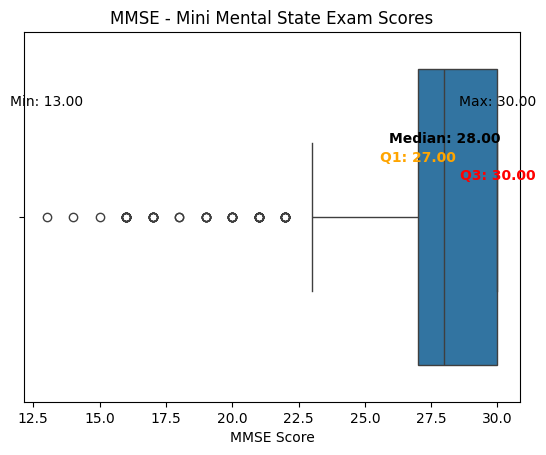

In [378]:
create_boxplot(data, 'mmse', 'MMSE - Mini Mental State Exam Scores', 'MMSE Score')

MMSE scores (Mini-Mental State Exam Scores) range in value from 0-30. Those people scoring <=24 are considered to have cognitive impairment. Although we have datapoints well outside of the normal values for the majority of patients in this dataset, these are considered valid and are an indication cognitive impairment.

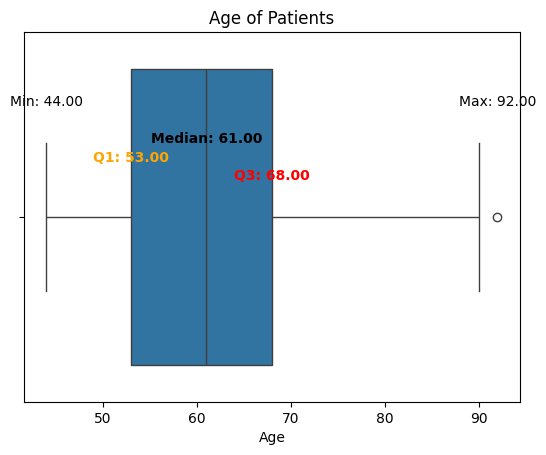

In [379]:
create_boxplot(data, 'age', 'Age of Patients', 'Age')

In [380]:
over_eighty = (data['age']>80).sum()
print('Patients over 80: ', over_eighty)

Patients over 80:  41


There are not many patients over age 80, but to get a better understanding of if these ages will impact the analysis, we can look at the distribution of age of those with and without a sarcopenia diagnosis. If the majority of those patients over 80 have sarcopenia we can likely determine that age is a good indicator of diagnosis. If all patients over 80 have sarcopenia then we could consider these patients outliers and remove them from the data before modeling for prediction. 

<Axes: xlabel='age', ylabel='Count'>

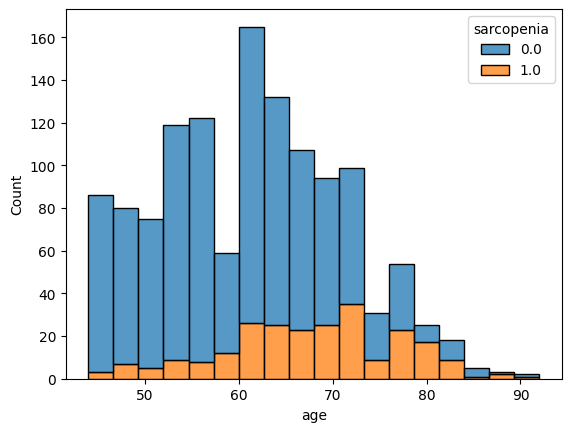

In [381]:
sns.histplot(data=data, x='age', hue='sarcopenia', multiple='stack', kde=False)

Although there are not many patients over age 80, the age does not seem to indicate that the patient will absolutely have sarcopenia. Therefore, these ages are valid and will be left in the dataset. 

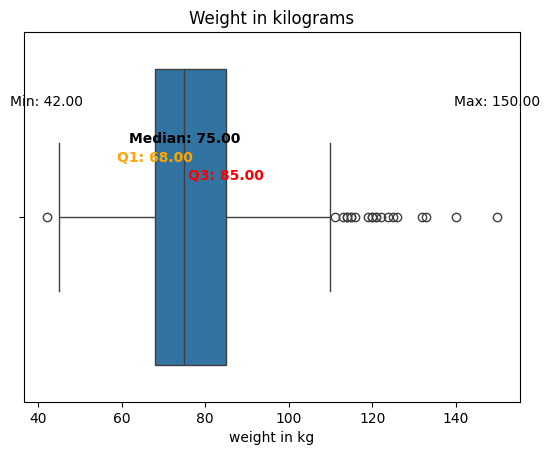

In [382]:
create_boxplot(data, 'weight', 'Weight in kilograms', 'weight in kg')

Although we have some weights outside of the normal range, these values are valid and are likely an indication of obesity. These values will remain as valid. 

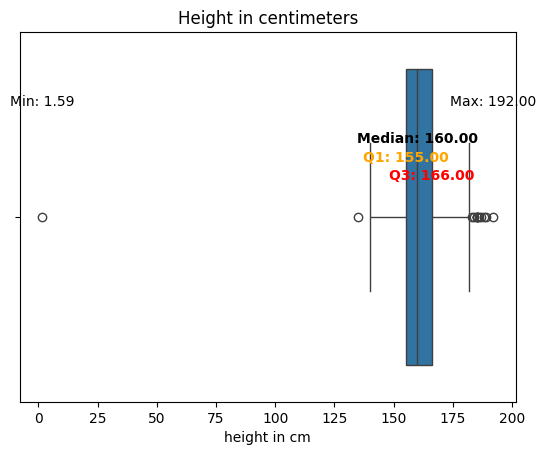

In [383]:
create_boxplot(data, 'height', 'Height in centimeters', 'height in cm')

Higher values here are not considered outliers. However, 1.59 centimeters is not a valid height for an adult human. For this reason, any value <125 will be removed as invalid. 

In [384]:
print('Shape of data before removing height outliers: ', data.shape)
data = data[data['height']>125]
print('Shape of data after removel of height outliers: ', data.shape)

Shape of data before removing height outliers:  (1276, 39)
Shape of data after removel of height outliers:  (1275, 39)


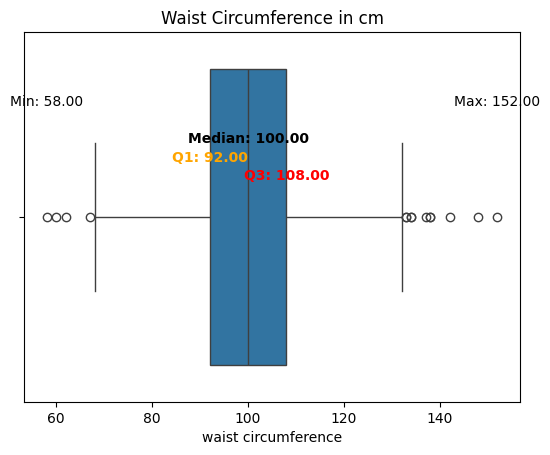

In [385]:
create_boxplot(data, 'waist', 'Waist Circumference in cm', 'waist circumference')

There are no true outliers here. Those data points outside of normal range here would be considered underweight and obesity indicators depending on the patient's height. This would ultimately be determined by BMI. With higher BMI indicating obesity and lower BMI indicating underweight.

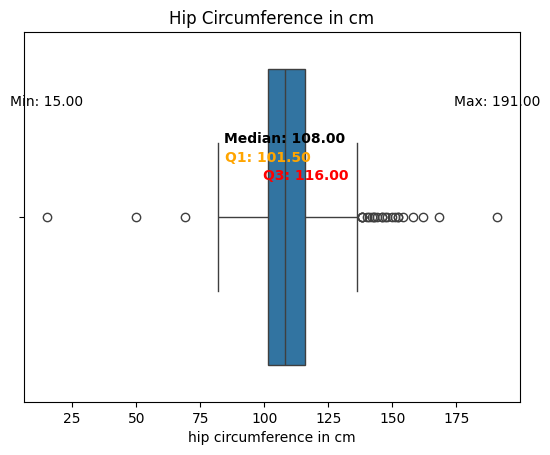

In [386]:
create_boxplot(data, 'hip', 'Hip Circumference in cm', 'hip circumference in cm')

According to research of adult waist circumference, values of <78 should be removed as invalid. 

In [387]:
print('Shape of data before removing hip circumference outliers: ', data.shape)
data = data[data['hip']>= 78]
print('Shape of data after removel of hip circumference outliers: ', data.shape)

Shape of data before removing hip circumference outliers:  (1275, 39)
Shape of data after removel of hip circumference outliers:  (1272, 39)


In [388]:
data['smoking_packs_per_yr'].value_counts()

smoking_packs_per_yr
0                                860
20                                55
30                                44
10                                37
40                                31
5                                 28
15                                25
50                                22
25                                15
60                                12
45                                12
2                                 10
35                                 9
12                                 7
1                                  7
70                                 6
80                                 5
7                                  5
4                                  4
6                                  4
7.5                                4
3                                  4
100                                4
2.5                                3
8                                  3
13                                 3
32               

We have nonnumeric values in the smoking packs per year column that need to be removed. This will be done using regular expressions.

In [389]:
# some values in the 'smoking_packs_per_yr' column have non-numerical data and need to be removed
data['smoking_packs_per_yr'] = data['smoking_packs_per_yr'].str.extract('(\d+\.?\d*)').astype(float)

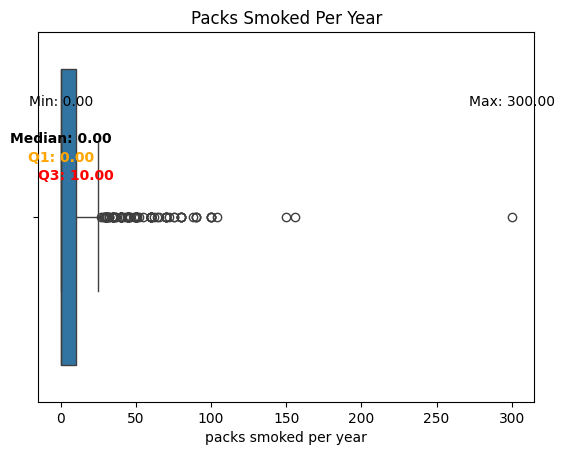

In [390]:
create_boxplot(data, 'smoking_packs_per_yr', 'Packs Smoked Per Year', 'packs smoked per year')

Although 300 is an extreme value, it is still not considered an invalid value. As this individual is smoking < 1 pack per day each year.

In [391]:
# checking for invalid entries under smoking
invalid_entries = data[(data['smoking'] == 0) & (data['smoking_packs_per_yr'] > 0)]

# checking for missing values in smoking_packs_per_yr
missing_values = data[(data['smoking'] == 1) & (data['smoking_packs_per_yr'] == 0)]

# view results
print("Invalid Entries (Non-smokers with non-zero packs per year):")
print(invalid_entries)

print("\nMissing Values (Smokers with zero packs per year):")
print(missing_values)

Invalid Entries (Non-smokers with non-zero packs per year):
     mmse  age  weight  height  waist    hip  smoking  smoking_packs_per_yr  \
565 28.00   63   96.00  156.00 108.00 131.00     0.00                 20.00   

    alcohol  dm dm_duration  insulin dm_drug  hiperlipidemi  \
565      no   0           0     0.00    none           0.00   

     dyslipidemia_duration dyslipidemia_drugs  kah  kah_duration  hipotiroidi  \
565                   0.00               none 0.00          0.00         0.00   

     astim  koah   op other_conditions  ht                  ht_drugs  \
565   1.00  0.00 0.00    gastrit,anemi   1  arb, b blocker, diuretic   

     ht_duration       education occupation  working_status exercise  low_cst  \
565        15.00  primary school  housewife            0.00        0     1.00   

      cst  gait_speed  low_grip_strength  grip_strength  sarcopenia  star  \
565 20.40        0.75               0.00          26.00        1.00  0.78   

      bmi gender  
565 39.50

We have one invalid entry at index 565 where a non-smoker has listed 20 packs smoked per year. The smoking status should be updated to reflect this patient as a smoker.

In [392]:
# update patient at index 565 to reflect correct smoking status
data.loc[565, 'smoking'] = 1

In [393]:
data['dm_duration'] = data['dm_duration'].astype(float)

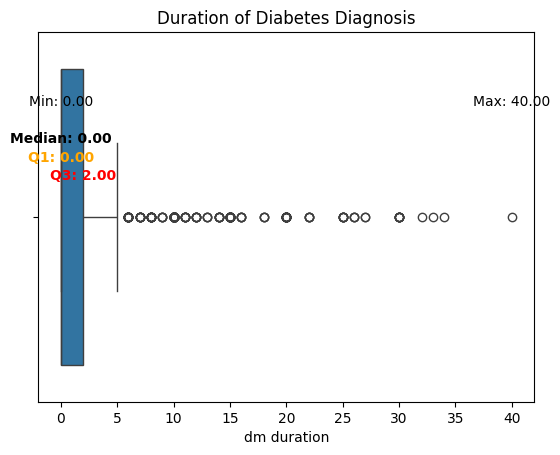

In [394]:
create_boxplot(data, 'dm_duration', 'Duration of Diabetes Diagnosis', 'dm duration')

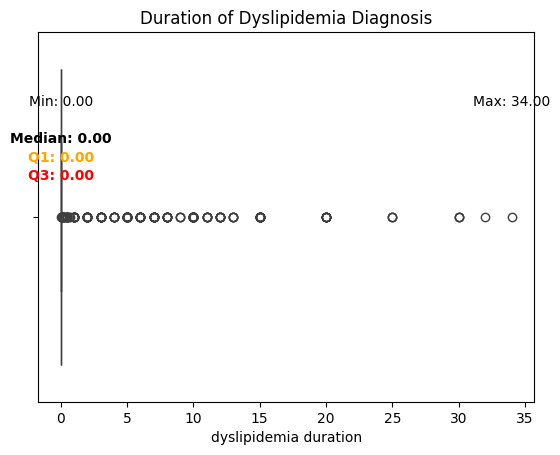

In [395]:
create_boxplot(data, 'dyslipidemia_duration', 'Duration of Dyslipidemia Diagnosis','dyslipidemia duration')

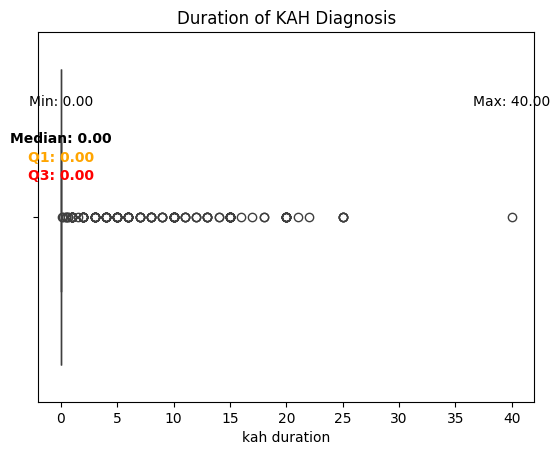

In [396]:
create_boxplot(data, 'kah_duration', 'Duration of KAH Diagnosis', 'kah duration')

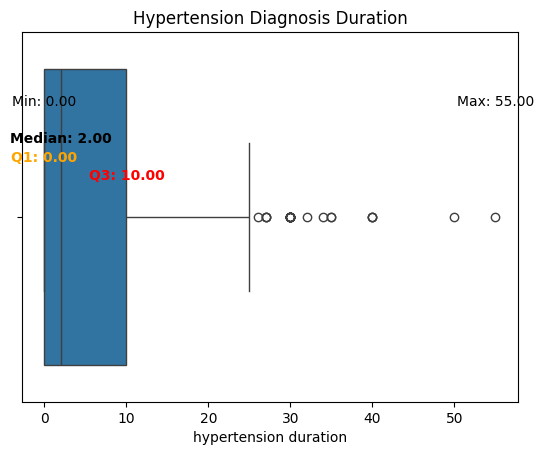

In [397]:
create_boxplot(data, 'ht_duration', 'Hypertension Diagnosis Duration', 'hypertension duration')

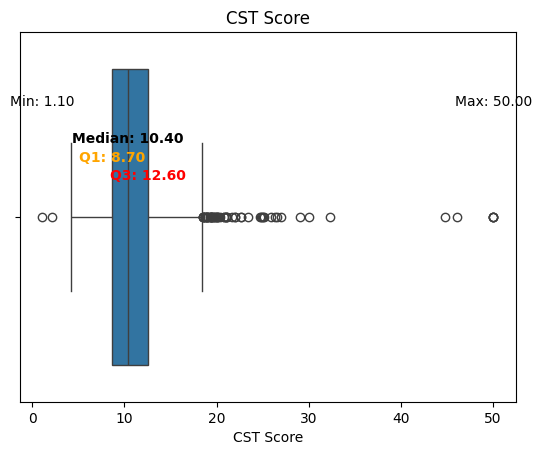

In [398]:
create_boxplot(data, 'cst', 'CST Score', 'CST Score')

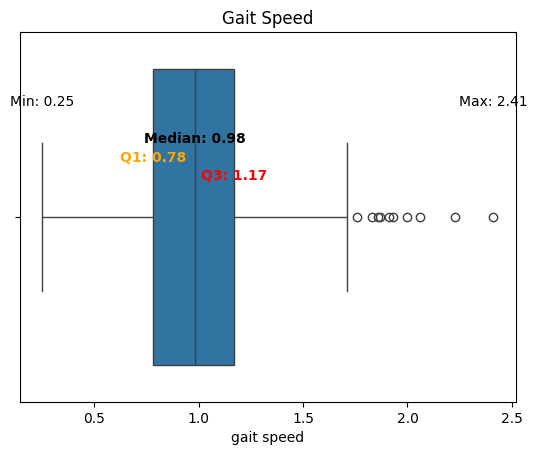

In [399]:
create_boxplot(data, 'gait_speed', 'Gait Speed', 'gait speed')

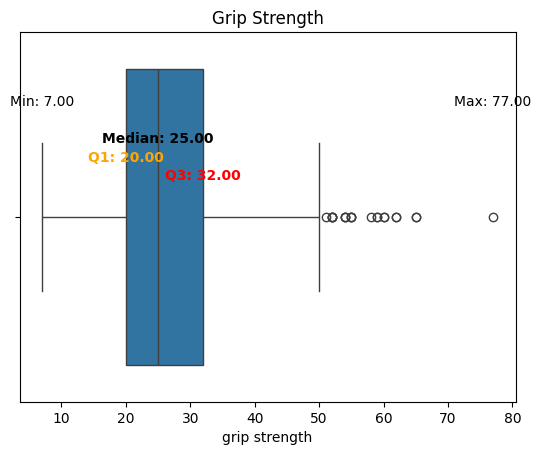

In [400]:
create_boxplot(data, 'grip_strength', 'Grip Strength', 'grip strength')

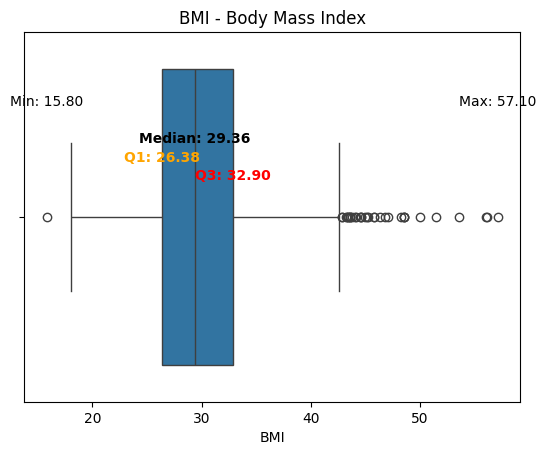

In [401]:
create_boxplot(data, 'bmi', 'BMI - Body Mass Index', 'BMI')

# <span style="color:#29AF7FFF">4. Exploratory Data Analysis</span>

<a id="4"></a>
<a href="#toc" class="btn btn-primary btn-sm" role="button" aria-pressed="true"
style="color:blue; background-color:#d9dddc" data-toggle="popover">Content</a>
## <span style="color:#287D8EFF">4.1 Exploratory Data Analysis</span>  

In [402]:
from ydata_profiling import ProfileReport

We will use the ProfileReport for a clean and concise data exploration using just one simple line of code.

In [403]:
profile = ProfileReport(data, title="Profiling Report")

In [404]:
profile.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

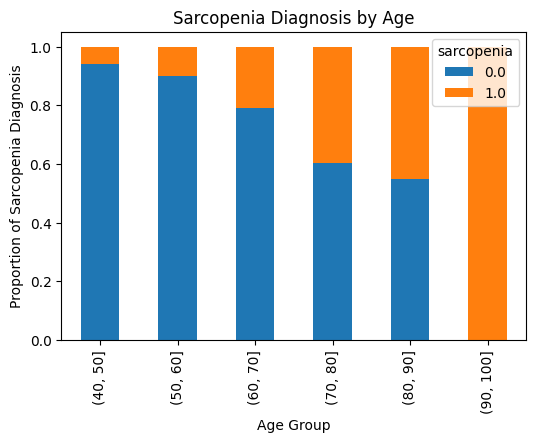

In [405]:
# sarcopenia diagnosis by age
data['age_bin'] = pd.cut(data['age'], bins=[40,50,60,70,80,90,100])
age_grouped = data.groupby('age_bin')['sarcopenia'].value_counts(normalize=True).unstack()
age_grouped.plot(kind='bar', stacked=True, figsize=(6, 4))
plt.xlabel('Age Group')
plt.ylabel('Proportion of Sarcopenia Diagnosis')
plt.title('Sarcopenia Diagnosis by Age')
plt.xticks(rotation=90)
plt.show()

Looking at the barchart, as age increases so does the likelihood of sarcopenia. Age will likely be a key indicator for diagnosis.

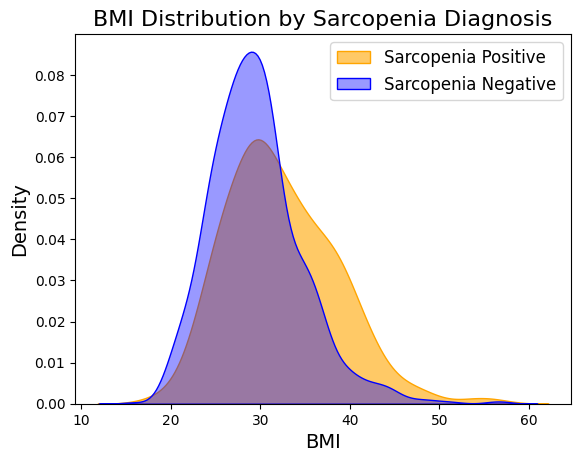

In [406]:
# visualizing sarcopenia diagnosis based on bmi
bmi_sarc_pos = data[data['sarcopenia'] == 1]['bmi']
bmi_sarc_neg = data[data['sarcopenia'] == 0]['bmi']

# create plot
sns.kdeplot(bmi_sarc_pos, label='Sarcopenia Positive', shade=True, color='orange', alpha=0.6)
sns.kdeplot(bmi_sarc_neg, label='Sarcopenia Negative', shade=True, color='blue', alpha=0.4)
plt.title('BMI Distribution by Sarcopenia Diagnosis', fontsize=16)
plt.xlabel('BMI', fontsize=14)
plt.ylabel('Density', fontsize=14)
plt.legend(fontsize=12)
plt.show()

While the majority of patients fall between 20~33 BMI, those with BMI > 33 are much more likely to have sarcopenia.

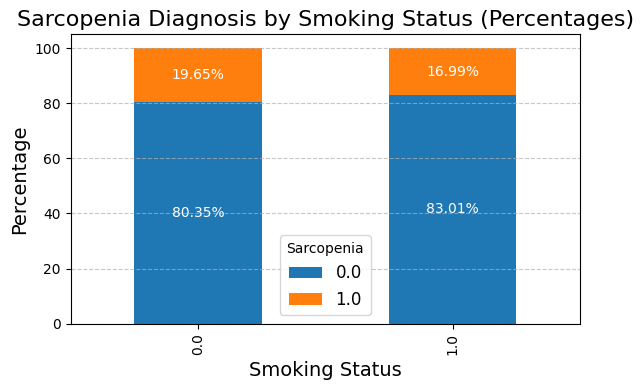

In [407]:
# visualizing sarcopenia diagnosis based on smoking
smoking_grouped = data.groupby(['smoking', 'sarcopenia']).size().reset_index(name='count')
smoking_pivot = smoking_grouped.pivot(index='smoking', columns='sarcopenia', values='count')
pivot_table_percent = smoking_pivot.div(smoking_pivot.sum(axis=1), axis=0) * 100
# create plot
ax = pivot_table_percent.plot(kind='bar', stacked=True,figsize=(6, 4))

# annotate percentages
for i, bar_group in enumerate(ax.containers):
    for bar in bar_group:
        height = bar.get_height()
        if height > 0:  
            ax.text(
                bar.get_x() + bar.get_width() / 2,  
                bar.get_y() + height / 2,          
                f'{height:.2f}%',                  
                ha='center', va='center', fontsize=10, color='white'
            )
# customize plot
plt.title('Sarcopenia Diagnosis by Smoking Status (Percentages)', fontsize=16)
plt.xlabel('Smoking Status', fontsize=14)
plt.ylabel('Percentage', fontsize=14)
plt.legend(title='Sarcopenia', fontsize=12)
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()

Those patients that smoke appear to only be slightly more likely to have sarcopenia. Though it is likely that how much the person smokes will also be an indicator, as those who smoke heavily are also more likely to live more sedentary lives. 

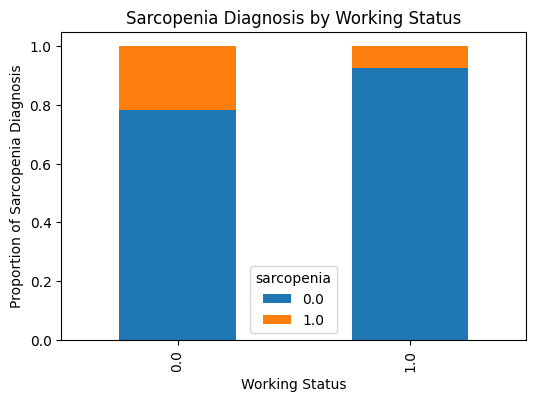

In [408]:
# visualizing sarcopenia diagnosis by working_status
working_grouped = data.groupby('working_status')['sarcopenia'].value_counts(normalize=True).unstack()
working_grouped.plot(kind='bar', stacked=True, figsize=(6, 4))
plt.xlabel('Working Status')
plt.ylabel('Proportion of Sarcopenia Diagnosis')
plt.title('Sarcopenia Diagnosis by Working Status')
plt.xticks(rotation=90)
plt.show()

Here we can see that those patients not working are more likely to have sarcopenia. Those people who work are more likely to have more active lives as they are required to perform activities of daily living that those who do not work aren't. Some jobs are more physically demanding than others, but the simple act of having to get ready and go to work each day means those working are likely more active in general leading to maintenance of muscle mass. 

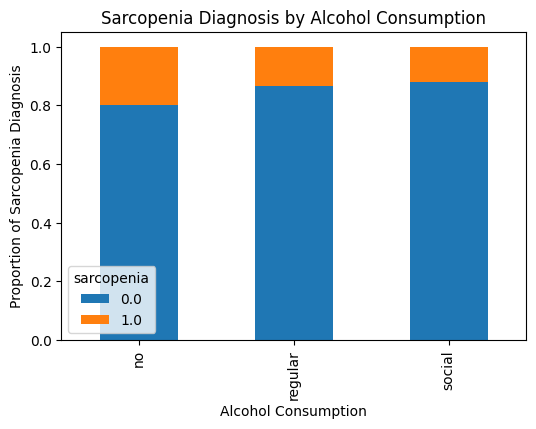

In [409]:
# sarcopenia diagnosis by alcohol consumption
alcohol_grouped = data.groupby('alcohol')['sarcopenia'].value_counts(normalize=True).unstack()
alcohol_grouped.plot(kind='bar', stacked=True, figsize=(6, 4))
plt.xlabel('Alcohol Consumption')
plt.ylabel('Proportion of Sarcopenia Diagnosis')
plt.title('Sarcopenia Diagnosis by Alcohol Consumption')
plt.xticks(rotation=90)
plt.show()

It is difficult to determine how much alcohol consumption contributes to sarcopenia diagnosis. While it first appears those patients who do not consume alcohol socially or regularly are more likely to have sarcopnia, it is imporant to keep the distribution of patients in each category in mind. For that reason no definitive statements can be made about the contribution of alcohol consumption towards sarcopenia diagnosis. 

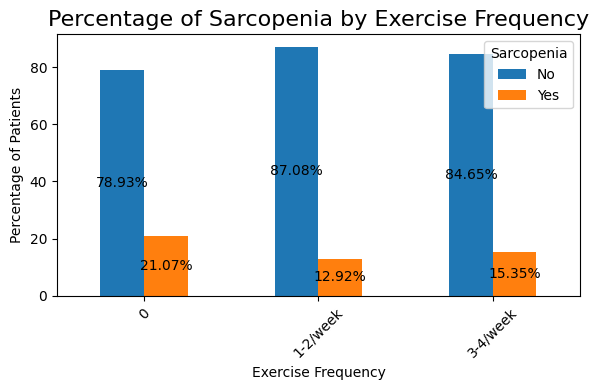

In [410]:
# visualizing sarcopenia diagnosis by exercise frequency
exercise_grouped = data.groupby(['exercise', 'sarcopenia']).size().reset_index(name='count')
exercise_pivot = exercise_grouped.pivot(index='exercise', columns='sarcopenia', values='count')
exercise_pivot_percent = exercise_pivot.div(exercise_pivot.sum(axis=1), axis=0) * 100
ax = exercise_pivot_percent.plot(kind='bar', figsize=(6,4))

# annotate
for container in ax.containers:
    ax.bar_label(container, fmt='%.2f%%', label_type='center', fontsize=10)

# customize
plt.title('Percentage of Sarcopenia by Exercise Frequency', fontsize=16)
plt.xlabel('Exercise Frequency', fontsize=10)
plt.ylabel('Percentage of Patients', fontsize=10)
plt.legend(title='Sarcopenia', labels=['No', 'Yes'], fontsize=10)
plt.xticks(rotation=45)

# Show the plot
plt.tight_layout()
plt.show()


Sarcopenia diagnosis by exercise frequency returns interesting results. First, we would expect that those reporting no exercise would have a higher likelihood of sarcopenia, which is confirmed. However, we also see the second highest likelihood is those patients reporting 3-4 days of exercise per week. Though we don't know if perhaps those exercising more frequently are doing so because of their diagnosis in an attempt to regain some of their musculature.

### <span style="color:#55c667ff">EDA Notes:</span> 

**Highly Correlated Variables:**  
There are some highly correlated variables which is to be expected as the variables are related to each other as follows:
BMI, Waist, Hip, and Weight: These are all bodily measures. BMI = weight (kg) / [height (m)]2.

Each diagnosis of illness is associated with the corresponding diagnosis duration and drugs/medication management column.

Gender is highly correlated with height and grip strength with males tending to have higher values in each.

This will be considered in modeling as highly correlated variables can impact the results.

**One hot encoding:**  
All medication columns will be one hot encoded for modeling where 1= yes patient is taking medication to manage the illness or 0 = not taking medication.

**Other notes:**  
MMSE - Mini Mental State Exam is scored on a scale of 0-30 to determine cognitive function in elder adults.
* Normal cognitive function - >= 25
* Mild cognitive impairment - 18-24
* Moderate dementia - 13-17
* Severe dementia - <= 12

# <span style="color:#29AF7FFF">5. Preprocessing: Encoding, Train/Test Split, Scaling</span>

<a id="5"></a>
<a href="#toc" class="btn btn-primary btn-sm" role="button" aria-pressed="true"
style="color:blue; background-color:#d9dddc" data-toggle="popover">Content</a>
## <span style="color:#287D8EFF">5.1 Encoding Categorical Data</span>  

### <span style="color:#55c667ff">Adding Binary Columns for Medications/Conditions:</span>

In [411]:
# adding binary column for diabetes medication
data['dm_meds'] = data['dm_drug'].apply(lambda x: 0 if x.strip().lower() == 'none' else 1)
data['dm_meds'].value_counts()

dm_meds
0    889
1    383
Name: count, dtype: int64

In [412]:
# adding binary column for dyslipidemia medication
data['dyslipidemia_meds'] = data['dyslipidemia_drugs'].apply(lambda x: 0 if x.strip().lower() == 'none' else 1)
data['dyslipidemia_meds'].value_counts()

dyslipidemia_meds
0    1024
1     248
Name: count, dtype: int64

In [413]:
# adding binary column for hypertenion medication
data['ht_meds'] = data['ht_drugs'].apply(lambda x: 0 if x.strip().lower() == 'none' else 1)
data['ht_meds'].value_counts()

ht_meds
1    807
0    465
Name: count, dtype: int64

In [414]:
# adding binary column indicating whether patient has additional not previously mentioned illnesses
data['additional_illness'] = data['other_conditions'].apply(lambda x: 0 if x.strip().lower() == 'none' else 1)
data['additional_illness'].value_counts()

additional_illness
0    994
1    278
Name: count, dtype: int64

In [415]:
# adding patient_id column for tracking results
data['patient_id'] = range(len(data))

Lastly in order to track education by level completed these will be changed to numerical rank:  
* 0 == illiterate
* 1 == primary school
* 2 == secondary school
* 3 == high school
* 4 == university

In [416]:
data['education'].value_counts()

education
primary school      529
high school         228
illiterate          183
university          178
secondary school    154
Name: count, dtype: int64

In [417]:
# changing education columns to level of education
edu_rank = {
    'illiterate': 0,
    'primary school': 1, 
    'secondary school': 2,
    'high school': 3,
    'university': 4
}

data['education'] = data['education'].map(edu_rank)
data['education'].value_counts()

education
1    529
3    228
0    183
4    178
2    154
Name: count, dtype: int64

Since a binary representation of the 'drug' columns has been created, we need to remove these from the data before beginning the modeling process as they provide redundant information. In addition, we have columns indicating the existence of illness along with columns indicating the duration of that illness. We only need the duration column not the diagnosis column as they both indicate the existense of illness. So, 'dm', 'hiperlipidemia', 'kah', and 'ht' will be replaced by their associated duration column. Similarly, the smoking and 'smoking_packs_per_yr' columns contain the same information. So, 'smoking' should be removed. We have also indicated where 'cst' and 'grip_strength' are classified as being low which is an indicator of sarcopenia, and the actual score columns will be removed. Finally, 'star', 'other_conditions', and 'occupation' will be removed as they are not usable in analysis. A new dataframe will be created called 'comprehensive' as it will contain the most comprehensive information for modeling. For the multi-step approach, we will start with determining risk probability for patients filtering out those that are least likely to have or develop sarcopenia and those who are returned as high probability for sarcopenia. From there pass on those who would be deemed to have inconclusive results to phase 2. 

In [418]:
data.columns

Index(['mmse', 'age', 'weight', 'height', 'waist', 'hip', 'smoking',
       'smoking_packs_per_yr', 'alcohol', 'dm', 'dm_duration', 'insulin',
       'dm_drug', 'hiperlipidemi', 'dyslipidemia_duration',
       'dyslipidemia_drugs', 'kah', 'kah_duration', 'hipotiroidi', 'astim',
       'koah', 'op', 'other_conditions', 'ht', 'ht_drugs', 'ht_duration',
       'education', 'occupation', 'working_status', 'exercise', 'low_cst',
       'cst', 'gait_speed', 'low_grip_strength', 'grip_strength', 'sarcopenia',
       'star', 'bmi', 'gender', 'age_bin', 'dm_meds', 'dyslipidemia_meds',
       'ht_meds', 'additional_illness', 'patient_id'],
      dtype='object')

In [419]:
# removing unneccessary/redundant columns
remove = ['dm_drug', 'dyslipidemia_drugs', 'other_conditions', 'ht_drugs', 'occupation', 'star',
          'dm', 'hiperlipidemi', 'kah', 'ht', 'cst', 'grip_strength', 'age_bin', 'smoking']

comprehensive = data.drop(remove, axis=1)

comprehensive.head().T

,0,1,2,4,5
mmse,27.00,28.00,24.00,30.00,29.00
age,64,53,56,55,57
weight,66.00,55.00,56.00,72.00,98.00
height,155.00,150.00,150.00,157.00,179.00
waist,89.00,77.00,112.00,98.00,110.00
hip,104.00,97.00,125.00,104.00,100.00
smoking_packs_per_yr,0.00,0.00,0.00,4.00,30.00
alcohol,no,no,no,no,social
dm_duration,0.00,0.00,0.00,0.00,0.00
insulin,0.00,0.00,0.00,0.00,0.00


### <span style="color:#55c667ff">Encoding Remaining Categorical Variables:</span>

In [420]:
# pull only categorical columns
categorical_columns = comprehensive.select_dtypes(include=['object']).columns.tolist()

# instantiate OneHotEncoder()
encoder = OneHotEncoder(handle_unknown='ignore', drop='first', sparse_output=False)

# fit and transform with encoder
one_hot_encoded = encoder.fit_transform(comprehensive[categorical_columns])

# create dataframe of encoded data
one_hot_data = pd.DataFrame(one_hot_encoded, columns=encoder.get_feature_names_out(categorical_columns))

# concat numerical data with onehot encoded data
comprehensive = pd.concat([comprehensive, one_hot_data], axis=1)

# drop original categorical cols
comprehensive.drop(categorical_columns, axis=1, inplace=True)

# view preproccessed dataframe
print(comprehensive.head())

   mmse   age  weight  height  waist    hip  smoking_packs_per_yr  \
0 27.00 64.00   66.00  155.00  89.00 104.00                  0.00   
1 28.00 53.00   55.00  150.00  77.00  97.00                  0.00   
2 24.00 56.00   56.00  150.00 112.00 125.00                  0.00   
4 30.00 55.00   72.00  157.00  98.00 104.00                  4.00   
5 29.00 57.00   98.00  179.00 110.00 100.00                 30.00   

   dm_duration  insulin  dyslipidemia_duration  kah_duration  hipotiroidi  \
0         0.00     0.00                   0.00          0.00         0.00   
1         0.00     0.00                   0.00          0.00         0.00   
2         0.00     0.00                   0.00          0.00         0.00   
4         0.00     0.00                   0.00          0.00         0.00   
5         0.00     0.00                   0.00          0.00         0.00   

   astim  koah   op  ht_duration  education  working_status  low_cst  \
0   0.00  0.00 0.00         0.00       3.00       

In [421]:
# rename some of the more complex columns for ease of use
comprehensive.rename(columns={'exercise_1-2/week': 'exercise_1_2',
                     'exercise_3-4/week':'exercise_3_4'}, inplace=True)


In [422]:
comprehensive.dropna(inplace=True)

In [423]:
comprehensive.columns

Index(['mmse', 'age', 'weight', 'height', 'waist', 'hip',
       'smoking_packs_per_yr', 'dm_duration', 'insulin',
       'dyslipidemia_duration', 'kah_duration', 'hipotiroidi', 'astim', 'koah',
       'op', 'ht_duration', 'education', 'working_status', 'low_cst',
       'gait_speed', 'low_grip_strength', 'sarcopenia', 'bmi', 'dm_meds',
       'dyslipidemia_meds', 'ht_meds', 'additional_illness', 'patient_id',
       'alcohol_regular', 'alcohol_social', 'exercise_1_2', 'exercise_3_4',
       'gender_m'],
      dtype='object')

## <span style="color:#287D8EFF">5.2 Train Test Split</span>

In [424]:
# create X,y and split
X = comprehensive.drop(['sarcopenia'], axis=1)
y = comprehensive['sarcopenia']


X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, stratify=y, random_state=42)

In [426]:
# saving ids for patients in test set for tracking patients through phases
test_patients = X_test['patient_id']

## <span style="color:#287D8EFF">5.3 Scaling Data: For Phase 1</span>
It is important to remember that there are multiple one-hot encoded variables in our data which should not be included in the scaling process.

In [427]:
# creating df with phase1 variables
phase1_vars = ['age', 'bmi', 'working_status', 'alcohol_regular',
       'alcohol_social', 'education', 'exercise_1_2',
       'exercise_3_4', 'gender_m']

# create phase 1 train and test sets
X_train_phase1 = X_train[phase1_vars]

X_test_phase1 = X_test[phase1_vars]

print('Shape of phase 1 train: ', X_train_phase1.shape)
print('Shape of phase 1 test: ', X_test_phase1.shape)

Shape of phase 1 train:  (870, 9)
Shape of phase 1 test:  (374, 9)


In [428]:
# establish which features are numerical vs. categorical
p1_numerical = ['age', 'bmi', 'education']

p1_categorical = ['working_status', 'alcohol_regular','alcohol_social',
                  'exercise_1_2', 'exercise_3_4', 'gender_m']                                                    

# create preprocessor
p1_preprocessor = ColumnTransformer(
    transformers=[
        ('num', StandardScaler(), p1_numerical),
        ('cat', 'passthrough', p1_categorical)
    ]
)

# fit preprocessor on training data
p1_preprocessor.fit(X_train_phase1)

# transform train and test data
X_train_phase1 = p1_preprocessor.transform(X_train_phase1)
X_test_phase1 = p1_preprocessor.transform(X_test_phase1)

In [429]:
# converting back to dataframe for filtering and evaluation methods after modeling
X_train_phase1 = pd.DataFrame(X_train_phase1, columns=phase1_vars)
X_test_phase1 = pd.DataFrame(X_test_phase1, columns=phase1_vars)

# <span style="color:#29AF7FFF">6. Phase 1: Prescreening Models</span>

<a id="6"></a>
<a href="#toc" class="btn btn-primary btn-sm" role="button" aria-pressed="true"
style="color:blue; background-color:#d9dddc" data-toggle="popover">Content</a>
## <span style="color:#287D8EFF">6.1 Phase 1: Classification Models</span>  

### <span style="color:#55c667ff">Creating Model Evaluation Functions:</span>

In [430]:
# function for evaluating train vs. test results
def eval_metric(model, X_train, y_train, X_test, y_test):
    y_train_pred = model.predict(X_train)
    y_pred = model.predict(X_test)

    print("Test_Set")
    print("--------------------------------------")
    cm_test = confusion_matrix(y_test, y_pred)
    disp = ConfusionMatrixDisplay(confusion_matrix=cm_test, display_labels=model.classes_)
    disp.plot(cmap='Blues')
    plt.show()
    print("classification_report")
    print(classification_report(y_test, y_pred))
    print()
    print("Train_Set")
    print("--------------------------------------")
    cm_train = confusion_matrix(y_train, y_train_pred)
    disp2 = ConfusionMatrixDisplay(confusion_matrix=cm_train, display_labels=model.classes_)
    disp2.plot(cmap='Blues')
    plt.show()
    print("classification_report")
    print(classification_report(y_train, y_train_pred))

In [431]:
# creating a dataFrame holding evaluation results for each model
def metric_df(model, X_train, y_train, X_test, y_test,name):
    y_train_pred = model.predict(X_train)
    y_pred = model.predict(X_test)

    try:
        y_pred_proba = model.predict_proba(X_test)[:,1]
    except AttributeError:
        y_pred_proba = None

    # compute confusion matrix
    cm = confusion_matrix(y_test, y_pred)
    TN, FP, FN, TP = cm.ravel()

    # compute rate based on cm
    TNR = TN / (TN + FP) if (TN + FP) > 0 else None # True Negative Rate
    FPR = FP / (TN + FP) if (TN + FP) > 0 else None # False Positive Rate
    FNR = FN / (FN + TP) if (FN + TP) > 0 else None # False Negative Rate
    TPR = TP / (FN + TP) if (FN + TP) > 0 else None # True Positive Rate

    scores = {
        name: {
            "accuracy": accuracy_score(y_test, y_pred),
            "precision": precision_score(y_test, y_pred),
            "recall": recall_score(y_test, y_pred),
            "f1": f1_score(y_test, y_pred),
            "auc": roc_auc_score(y_test, y_pred_proba) if y_pred_proba is not None else None,
            "True Negative Rate": TNR,
            "False Positive Rate": FPR,
            "False Negative Rate": FNR,
            "True Positive Rate": TPR,
        }
    }

    return pd.DataFrame(scores)

### <span style="color:#55c667ff">Logistic Regression Model 1</span>

Test_Set
--------------------------------------


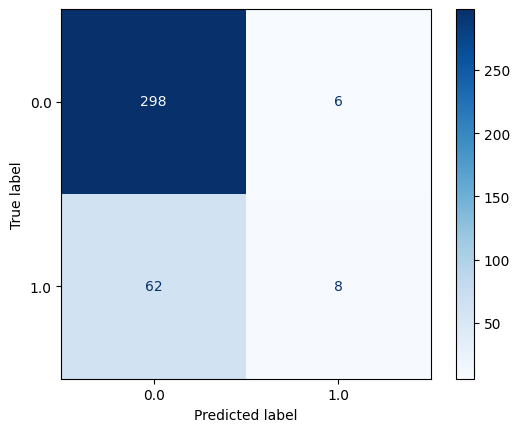

classification_report
              precision    recall  f1-score   support

         0.0       0.83      0.98      0.90       304
         1.0       0.57      0.11      0.19        70

    accuracy                           0.82       374
   macro avg       0.70      0.55      0.54       374
weighted avg       0.78      0.82      0.77       374


Train_Set
--------------------------------------


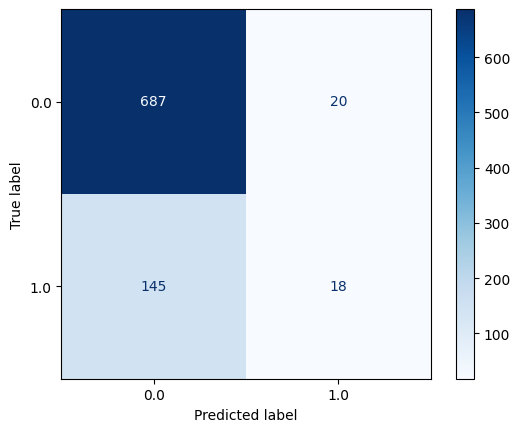

classification_report
              precision    recall  f1-score   support

         0.0       0.83      0.97      0.89       707
         1.0       0.47      0.11      0.18       163

    accuracy                           0.81       870
   macro avg       0.65      0.54      0.54       870
weighted avg       0.76      0.81      0.76       870



In [432]:
# initialize logisitic regression
lr = LogisticRegression(random_state=42)

# fit on training data
lr.fit(X_train_phase1, y_train)

eval_metric(lr, X_train_phase1, y_train, X_test_phase1, y_test)

In [433]:
# create dataframe to hold model evaluation results
results = metric_df(lr, X_train_phase1, y_train, X_test_phase1, y_test, 'Logistic Regression - 1')
results.T

,accuracy,precision,recall,f1,auc,True Negative Rate,False Positive Rate,False Negative Rate,True Positive Rate
Logistic Regression - 1,0.82,0.57,0.11,0.19,0.75,0.98,0.02,0.89,0.11


We want to be able to minimize our false negatives. False negatives mean that we are unable to identify those patients at risk for sarcopenia. Therefore, we need to fine tune our models to minimize the false negative rate. The Logistic Regression model returns good accuracy and AUC scores, but is favoring the majority/negative class. Next method is to try GridSearchCV to test parameters for the logistic regression model and see if there are parameters that may return better scores than default.

### <span style="color:#55c667ff">Logistic Regression Model 2</span>

In [434]:
# logistic regression with gridsearch for best parameters
param_grid = [
    {'penalty':['l1','l2','elasticnet','none'],
    'C' : [100, 10, 1.0, 0.1, 0.01],
    'solver': ['lbfgs','newton-cg','liblinear'],
    'class_weight': ['balanced', None]
    }
]

clf = GridSearchCV(lr, param_grid, cv=5, verbose=1, n_jobs=-1, scoring='f1')
best_clf = clf.fit(X_train_phase1, y_train)
best_clf.best_estimator_

Fitting 5 folds for each of 120 candidates, totalling 600 fits


LogisticRegression(C=0.01, class_weight='balanced', random_state=42)

Test_Set
--------------------------------------


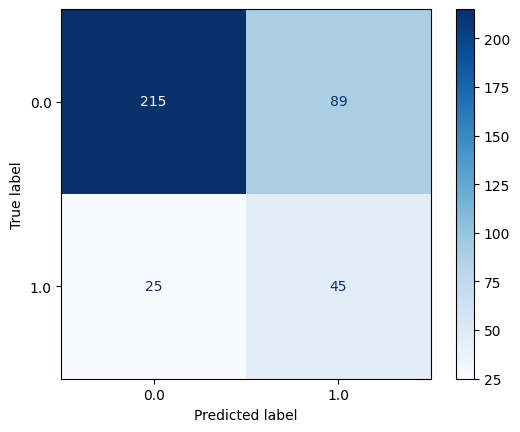

classification_report
              precision    recall  f1-score   support

         0.0       0.90      0.71      0.79       304
         1.0       0.34      0.64      0.44        70

    accuracy                           0.70       374
   macro avg       0.62      0.68      0.62       374
weighted avg       0.79      0.70      0.73       374


Train_Set
--------------------------------------


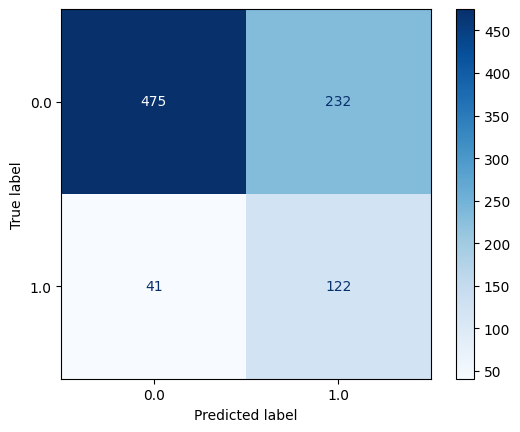

classification_report
              precision    recall  f1-score   support

         0.0       0.92      0.67      0.78       707
         1.0       0.34      0.75      0.47       163

    accuracy                           0.69       870
   macro avg       0.63      0.71      0.62       870
weighted avg       0.81      0.69      0.72       870



In [435]:
# apply best_estimators_ model
lr2 = LogisticRegression(C=0.01, class_weight='balanced', random_state=42)
   
# fit on training data
lr2.fit(X_train_phase1, y_train)

# get evaluation metrics
eval_metric(lr2, X_train_phase1, y_train, X_test_phase1, y_test)

In [436]:
# save results to dataframe
results2 = metric_df(lr2, X_train_phase1, y_train, X_test_phase1, y_test, 'Logistic Regression - 2')

results = pd.concat([results, results2], axis=1, ignore_index=False)

results.T

,accuracy,precision,recall,f1,auc,True Negative Rate,False Positive Rate,False Negative Rate,True Positive Rate
Logistic Regression - 1,0.82,0.57,0.11,0.19,0.75,0.98,0.02,0.89,0.11
Logistic Regression - 2,0.70,0.34,0.64,0.44,0.75,0.71,0.29,0.36,0.64


After GridSearchCV parameters are applied, we see an increase  in F1 score as well as recall. While preliminary results are promising, there are more complex models to try to see if we can increase our evaluation metrics to better identify risk of sarcopenia. Overall, model 2 for Logistic Regression provides better results as the false negative rate has decreased and true positive rate has increased.

### <span style="color:#55c667ff">Random Forest Model 1</span>

Test_Set
--------------------------------------


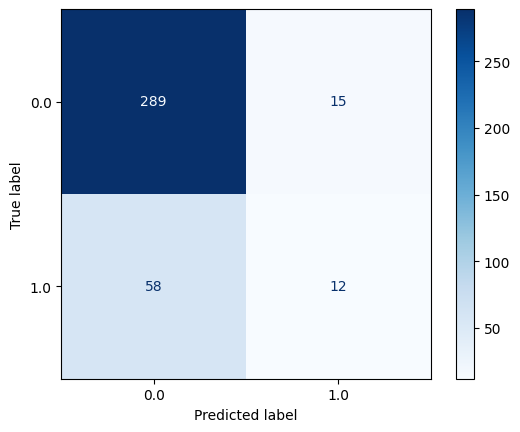

classification_report
              precision    recall  f1-score   support

         0.0       0.83      0.95      0.89       304
         1.0       0.44      0.17      0.25        70

    accuracy                           0.80       374
   macro avg       0.64      0.56      0.57       374
weighted avg       0.76      0.80      0.77       374


Train_Set
--------------------------------------


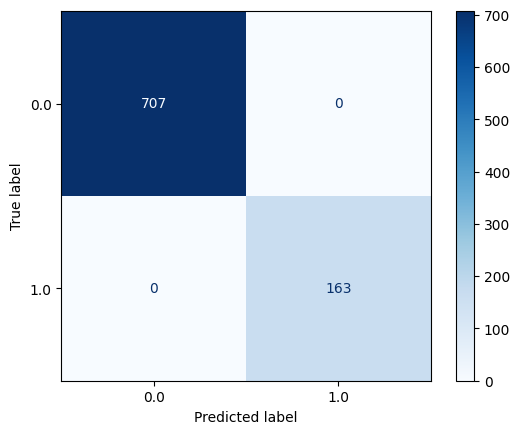

classification_report
              precision    recall  f1-score   support

         0.0       1.00      1.00      1.00       707
         1.0       1.00      1.00      1.00       163

    accuracy                           1.00       870
   macro avg       1.00      1.00      1.00       870
weighted avg       1.00      1.00      1.00       870



In [437]:
# random forest model with default parameters
rf1 = RandomForestClassifier(random_state=42)

# fit to training data
rf1.fit(X_train_phase1, y_train)

# get evaluation metrics
eval_metric(rf1, X_train_phase1, y_train, X_test_phase1, y_test)

Random Forest with default parameters is overfitting. We see perfect outcome for training data, but significant decrease in performance on test data. Fine-tuning is needed to prevent overfitting.

In [438]:
# saving results
results3 = metric_df(rf1, X_train_phase1, y_train, X_test_phase1, y_test, 'Random Forest - 1')

results = pd.concat([results, results3], axis=1, ignore_index=False)

results.T

,accuracy,precision,recall,f1,auc,True Negative Rate,False Positive Rate,False Negative Rate,True Positive Rate
Logistic Regression - 1,0.82,0.57,0.11,0.19,0.75,0.98,0.02,0.89,0.11
Logistic Regression - 2,0.70,0.34,0.64,0.44,0.75,0.71,0.29,0.36,0.64
Random Forest - 1,0.80,0.44,0.17,0.25,0.69,0.95,0.05,0.83,0.17


### <span style="color:#55c667ff">Random Forest Model 2</span>

In [439]:
# define parameters for grid search
param_grid = {
    'n_estimators': [50,100,200],
    'criterion': ['gini', 'entropy', 'log_loss'],
    'max_depth': [3, 5, 7, None],
    'max_features': [1,3,5],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 3, 4],
    'class_weight': ['balanced', 'balanced_subsample', None]
}

# initialize random forest
rf = RandomForestClassifier(random_state=42)

# run grid search
grid_search = GridSearchCV(
    estimator=rf,
    param_grid=param_grid,
    scoring='f1',
    cv=5, n_jobs=-1)

best_rf = grid_search.fit(X_train_phase1, y_train)
best_rf.best_estimator_

RandomForestClassifier(class_weight='balanced_subsample', criterion='entropy',
                       max_depth=3, max_features=5, min_samples_leaf=4,
                       random_state=42)

Test_Set
--------------------------------------


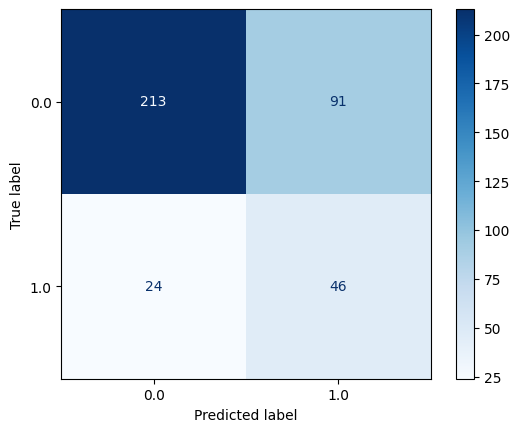

classification_report
              precision    recall  f1-score   support

         0.0       0.90      0.70      0.79       304
         1.0       0.34      0.66      0.44        70

    accuracy                           0.69       374
   macro avg       0.62      0.68      0.62       374
weighted avg       0.79      0.69      0.72       374


Train_Set
--------------------------------------


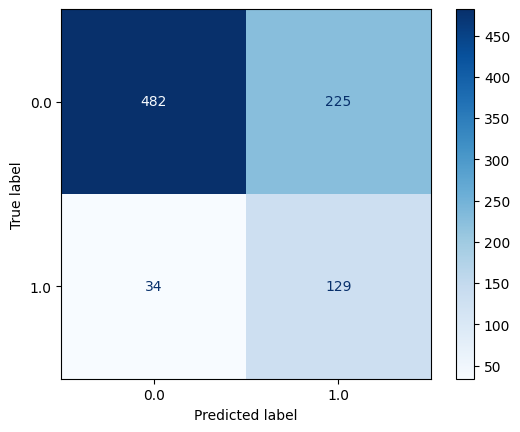

classification_report
              precision    recall  f1-score   support

         0.0       0.93      0.68      0.79       707
         1.0       0.36      0.79      0.50       163

    accuracy                           0.70       870
   macro avg       0.65      0.74      0.64       870
weighted avg       0.83      0.70      0.73       870



In [440]:
# applying best parameters
rf2 = RandomForestClassifier(class_weight='balanced_subsample', criterion='entropy',
                       max_depth=3, max_features=5, min_samples_leaf=4,
                       random_state=42)
            
# fit 
rf2.fit(X_train_phase1, y_train)

# get evaluation metrics
eval_metric(rf2, X_train_phase1, y_train, X_test_phase1, y_test)

In [441]:
# saving results
results4 = metric_df(rf2, X_train_phase1, y_train, X_test_phase1, y_test, 'Random Forest - 2')

results = pd.concat([results, results4], axis=1, ignore_index=False)

results.T

,accuracy,precision,recall,f1,auc,True Negative Rate,False Positive Rate,False Negative Rate,True Positive Rate
Logistic Regression - 1,0.82,0.57,0.11,0.19,0.75,0.98,0.02,0.89,0.11
Logistic Regression - 2,0.70,0.34,0.64,0.44,0.75,0.71,0.29,0.36,0.64
Random Forest - 1,0.80,0.44,0.17,0.25,0.69,0.95,0.05,0.83,0.17
Random Forest - 2,0.69,0.34,0.66,0.44,0.73,0.70,0.30,0.34,0.66


LR2 and RF2 return similar scores. Either model is going to return similar results. However, due to the complexity of Random Forest versus Logistic Regression, LR2 will remain as the current best model for phase 1.

### <span style="color:#55c667ff">KNN Model 1</span>

In [442]:
# creating and fitting model with default parameters
knn = KNeighborsClassifier()

knn.fit(X_train_phase1, y_train)

y_pred_knn = knn.predict(X_test_phase1)
y_pred_proba_knn = knn.predict_proba(X_test_phase1)[:,1]

# evaluate results
auc_knn = roc_auc_score(y_test, y_pred_proba_knn)
print(f'AUC score: {auc_knn: .2f}')

f1_knn = f1_score(y_test, y_pred_knn)
print(f'F1 score: {f1_knn: .2f}')

AUC score:  0.63
F1 score:  0.24


Test_Set
--------------------------------------


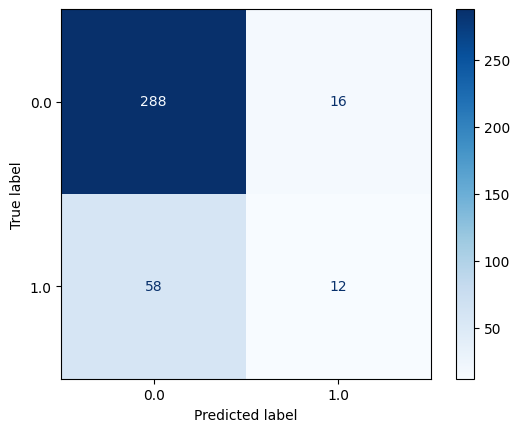

classification_report
              precision    recall  f1-score   support

         0.0       0.83      0.95      0.89       304
         1.0       0.43      0.17      0.24        70

    accuracy                           0.80       374
   macro avg       0.63      0.56      0.57       374
weighted avg       0.76      0.80      0.77       374


Train_Set
--------------------------------------


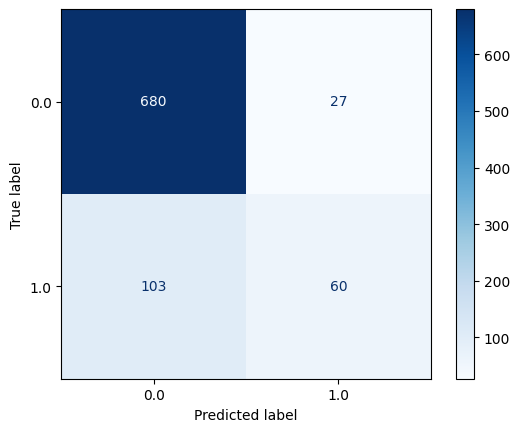

classification_report
              precision    recall  f1-score   support

         0.0       0.87      0.96      0.91       707
         1.0       0.69      0.37      0.48       163

    accuracy                           0.85       870
   macro avg       0.78      0.66      0.70       870
weighted avg       0.83      0.85      0.83       870



In [443]:
# model Evaluation
eval_metric(knn, X_train_phase1, y_train, X_test_phase1, y_test)

In [444]:
# saving results
results5 = metric_df(knn, X_train_phase1, y_train, X_test_phase1, y_test, 'KNN - 1')

results = pd.concat([results, results5], axis=1, ignore_index=False)

results.T

,accuracy,precision,recall,f1,auc,True Negative Rate,False Positive Rate,False Negative Rate,True Positive Rate
Logistic Regression - 1,0.82,0.57,0.11,0.19,0.75,0.98,0.02,0.89,0.11
Logistic Regression - 2,0.70,0.34,0.64,0.44,0.75,0.71,0.29,0.36,0.64
Random Forest - 1,0.80,0.44,0.17,0.25,0.69,0.95,0.05,0.83,0.17
Random Forest - 2,0.69,0.34,0.66,0.44,0.73,0.70,0.30,0.34,0.66
KNN - 1,0.80,0.43,0.17,0.24,0.63,0.95,0.05,0.83,0.17


KNN returns signnificantly lower F1 scores, but could get better with fine tuning.

### <span style="color:#55c667ff"> K-Nearest Neighbors with GridSearchCV </span>
Before using GridSearchCV, the elbow method will be used to determine the optimum value of k.

In [445]:
# evaluating various k values
error_rate = []

for i in range(1,29):
   knn = KNeighborsClassifier(n_neighbors=i)
   knn.fit(X_train_phase1,y_train)
   pred_i = knn.predict(X_test_phase1)
   error_rate.append(np.mean(pred_i != y_test))

Text(0, 0.5, 'Error Rate')

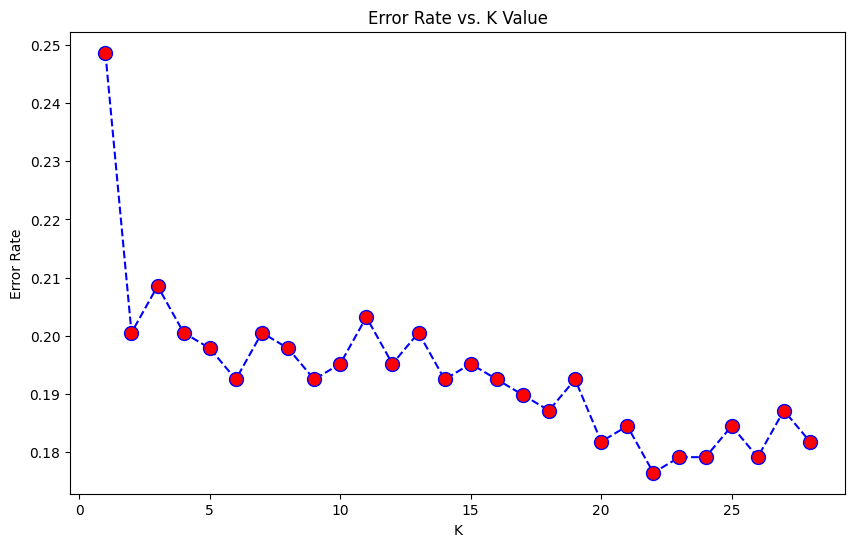

In [446]:
plt.figure(figsize=(10,6))
plt.plot(range(1,29),error_rate,color='blue', linestyle='dashed', marker='o',
 markerfacecolor='red', markersize=10)
plt.title('Error Rate vs. K Value')
plt.xlabel('K')
plt.ylabel('Error Rate')

Based on these results, k = 22 will return the lowest error rate. 

In [447]:
# defining grid of parameters to test
knn_grid = { 'n_neighbors' : [22],
               'weights' : ['uniform','distance', 'balanced'],
               'metric' : ['minkowski','euclidean','manhattan']}

knn_clf = GridSearchCV(knn, param_grid=knn_grid, verbose=1, cv=5)

knn_clf.fit(X_train_phase1, y_train)

knn_clf.best_estimator_

Fitting 5 folds for each of 9 candidates, totalling 45 fits


KNeighborsClassifier(metric='manhattan', n_neighbors=22)

Test_Set
--------------------------------------


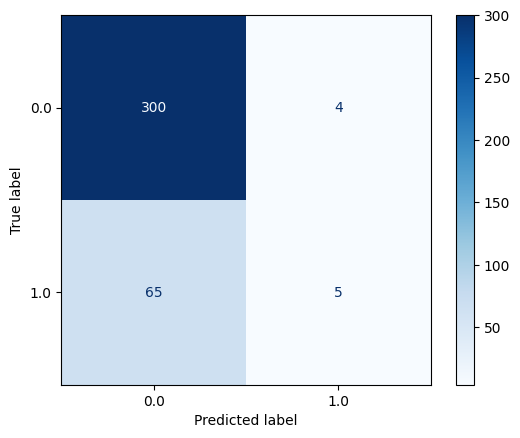

classification_report
              precision    recall  f1-score   support

         0.0       0.82      0.99      0.90       304
         1.0       0.56      0.07      0.13        70

    accuracy                           0.82       374
   macro avg       0.69      0.53      0.51       374
weighted avg       0.77      0.82      0.75       374


Train_Set
--------------------------------------


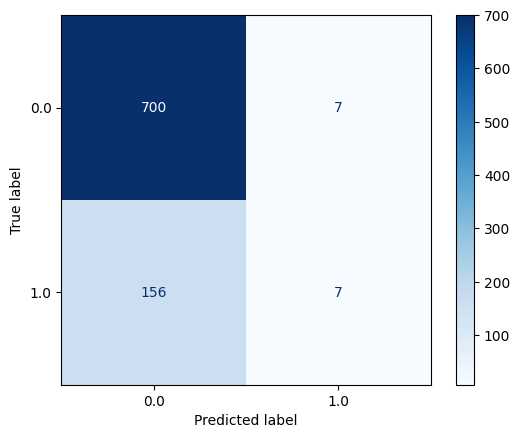

classification_report
              precision    recall  f1-score   support

         0.0       0.82      0.99      0.90       707
         1.0       0.50      0.04      0.08       163

    accuracy                           0.81       870
   macro avg       0.66      0.52      0.49       870
weighted avg       0.76      0.81      0.74       870



In [448]:
knn2 = KNeighborsClassifier(metric='manhattan', n_neighbors=22)
knn2.fit(X_train_phase1, y_train)
eval_metric(knn2, X_train_phase1, y_train, X_test_phase1, y_test)

In [449]:
# saving results
results6 = metric_df(knn2, X_train_phase1, y_train, X_test_phase1, y_test, 'KNN - 2')

results = pd.concat([results, results6], axis=1, ignore_index=False)

results.T

,accuracy,precision,recall,f1,auc,True Negative Rate,False Positive Rate,False Negative Rate,True Positive Rate
Logistic Regression - 1,0.82,0.57,0.11,0.19,0.75,0.98,0.02,0.89,0.11
Logistic Regression - 2,0.70,0.34,0.64,0.44,0.75,0.71,0.29,0.36,0.64
Random Forest - 1,0.80,0.44,0.17,0.25,0.69,0.95,0.05,0.83,0.17
Random Forest - 2,0.69,0.34,0.66,0.44,0.73,0.70,0.30,0.34,0.66
KNN - 1,0.80,0.43,0.17,0.24,0.63,0.95,0.05,0.83,0.17
KNN - 2,0.82,0.56,0.07,0.13,0.69,0.99,0.01,0.93,0.07


KNN with fine tuning returns the lowest scores yet. It is likely that KNN is just not a good model for this data in general and will be excluded from the remaining phases.

### <span style="color:#55c667ff"> AdaBoostClassifier - 1 </span>

In [450]:
# initialize AdaBoostClassifier()
abc = AdaBoostClassifier(random_state=42)
abc.fit(X_train_phase1, y_train)

y_pred_abc = abc.predict(X_test_phase1)
y_pred_proba_abc = abc.predict_proba(X_test_phase1)[:,1]

# evaluate results
auc_abc = roc_auc_score(y_test, y_pred_proba_abc)
print(f'AUC score: {auc_abc: .2f}')

f1_abc = f1_score(y_test, y_pred_abc)
print(f'F1 score: {f1_abc: .2f} ')

AUC score:  0.67
F1 score:  0.22 


Test_Set
--------------------------------------


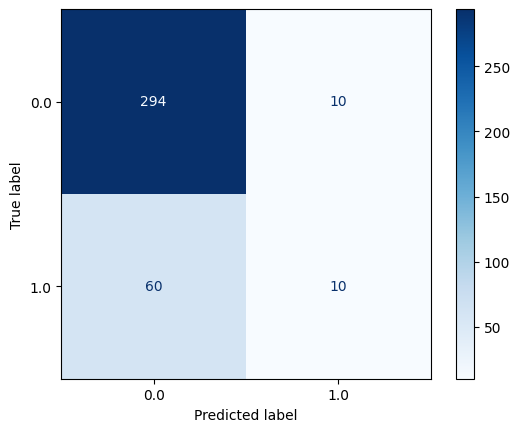

classification_report
              precision    recall  f1-score   support

         0.0       0.83      0.97      0.89       304
         1.0       0.50      0.14      0.22        70

    accuracy                           0.81       374
   macro avg       0.67      0.55      0.56       374
weighted avg       0.77      0.81      0.77       374


Train_Set
--------------------------------------


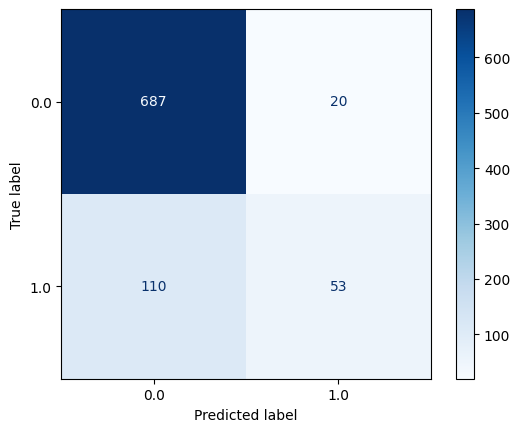

classification_report
              precision    recall  f1-score   support

         0.0       0.86      0.97      0.91       707
         1.0       0.73      0.33      0.45       163

    accuracy                           0.85       870
   macro avg       0.79      0.65      0.68       870
weighted avg       0.84      0.85      0.83       870



In [451]:
eval_metric(abc, X_train_phase1, y_train, X_test_phase1, y_test)

In [452]:
# saving results
results7 = metric_df(abc, X_train_phase1, y_train, X_test_phase1, y_test, 'AdaBoost - 1')

results = pd.concat([results, results7], axis=1, ignore_index=False)

results.T

,accuracy,precision,recall,f1,auc,True Negative Rate,False Positive Rate,False Negative Rate,True Positive Rate
Logistic Regression - 1,0.82,0.57,0.11,0.19,0.75,0.98,0.02,0.89,0.11
Logistic Regression - 2,0.70,0.34,0.64,0.44,0.75,0.71,0.29,0.36,0.64
Random Forest - 1,0.80,0.44,0.17,0.25,0.69,0.95,0.05,0.83,0.17
Random Forest - 2,0.69,0.34,0.66,0.44,0.73,0.70,0.30,0.34,0.66
KNN - 1,0.80,0.43,0.17,0.24,0.63,0.95,0.05,0.83,0.17
KNN - 2,0.82,0.56,0.07,0.13,0.69,0.99,0.01,0.93,0.07
AdaBoost - 1,0.81,0.50,0.14,0.22,0.67,0.97,0.03,0.86,0.14


AdaBoostClassifier with default parameters is performing similar to other models, but fine-tuning may increase scores. 

### <span style="color:#55c667ff"> AdaBoostClassifier - 2 </span>

In [453]:
# define parameters for grid search
param_grid = {
    'n_estimators': [30, 50, 100, 150, 200],
    'learning_rate': [0.97, 0.5, 0.3, 0.1, 0.05, 0.01],
    'algorithm': ['SAMME', 'SAMME.R']  
}

# run grid search
grid_search = GridSearchCV(
    estimator=abc,
    param_grid=param_grid,
    scoring='f1',
    cv=5, n_jobs=-1)

best_abc = grid_search.fit(X_train_phase1, y_train)
best_abc.best_estimator_

AdaBoostClassifier(learning_rate=0.97, n_estimators=30, random_state=42)

Test_Set
--------------------------------------


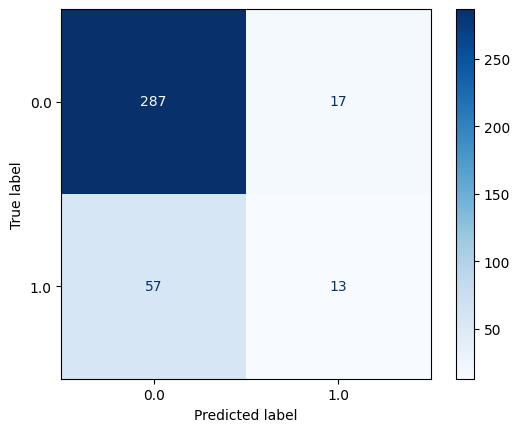

classification_report
              precision    recall  f1-score   support

         0.0       0.83      0.94      0.89       304
         1.0       0.43      0.19      0.26        70

    accuracy                           0.80       374
   macro avg       0.63      0.56      0.57       374
weighted avg       0.76      0.80      0.77       374


Train_Set
--------------------------------------


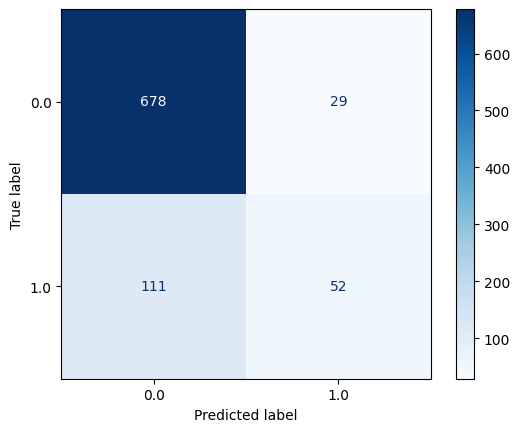

classification_report
              precision    recall  f1-score   support

         0.0       0.86      0.96      0.91       707
         1.0       0.64      0.32      0.43       163

    accuracy                           0.84       870
   macro avg       0.75      0.64      0.67       870
weighted avg       0.82      0.84      0.82       870



In [454]:
# fit best parameters
abc2 = AdaBoostClassifier(learning_rate=0.97, n_estimators=30, random_state=42)

abc2.fit(X_train_phase1, y_train)

eval_metric(abc2, X_train_phase1, y_train, X_test_phase1, y_test)

In [455]:
# saving results
results8 = metric_df(abc2, X_train_phase1, y_train, X_test_phase1, y_test, 'AdaBoost - 2')

results = pd.concat([results, results8], axis=1, ignore_index=False)

results.T

,accuracy,precision,recall,f1,auc,True Negative Rate,False Positive Rate,False Negative Rate,True Positive Rate
Logistic Regression - 1,0.82,0.57,0.11,0.19,0.75,0.98,0.02,0.89,0.11
Logistic Regression - 2,0.70,0.34,0.64,0.44,0.75,0.71,0.29,0.36,0.64
Random Forest - 1,0.80,0.44,0.17,0.25,0.69,0.95,0.05,0.83,0.17
Random Forest - 2,0.69,0.34,0.66,0.44,0.73,0.70,0.30,0.34,0.66
KNN - 1,0.80,0.43,0.17,0.24,0.63,0.95,0.05,0.83,0.17
KNN - 2,0.82,0.56,0.07,0.13,0.69,0.99,0.01,0.93,0.07
AdaBoost - 1,0.81,0.50,0.14,0.22,0.67,0.97,0.03,0.86,0.14
AdaBoost - 2,0.80,0.43,0.19,0.26,0.66,0.94,0.06,0.81,0.19


Best model is still LR2 with the best balance of score between F1, AUC, and recall. 

### <span style="color:#55c667ff"> XGBoostClassifer - 1 </span>

Test_Set
--------------------------------------


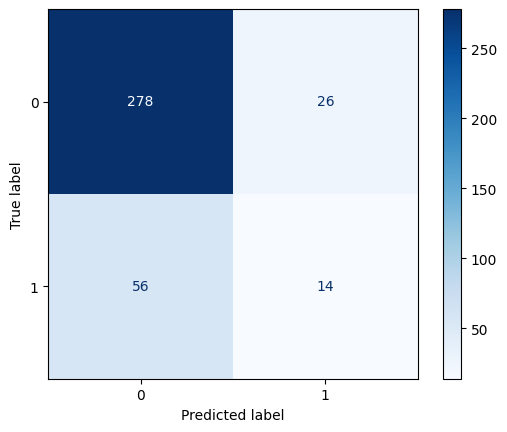

classification_report
              precision    recall  f1-score   support

         0.0       0.83      0.91      0.87       304
         1.0       0.35      0.20      0.25        70

    accuracy                           0.78       374
   macro avg       0.59      0.56      0.56       374
weighted avg       0.74      0.78      0.76       374


Train_Set
--------------------------------------


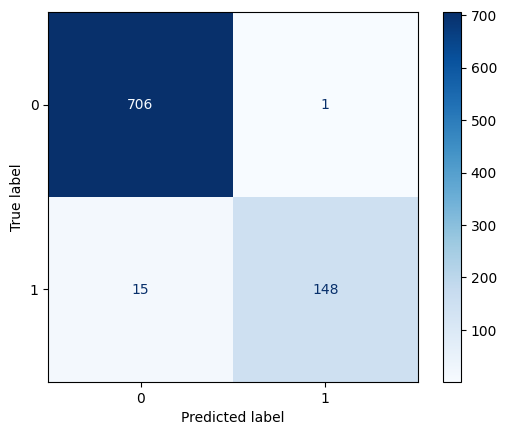

classification_report
              precision    recall  f1-score   support

         0.0       0.98      1.00      0.99       707
         1.0       0.99      0.91      0.95       163

    accuracy                           0.98       870
   macro avg       0.99      0.95      0.97       870
weighted avg       0.98      0.98      0.98       870



In [456]:
# initialize and fit xgboostclassifier
xgb = XGBClassifier(random_state=42)
xgb.fit(X_train_phase1, y_train)

eval_metric(xgb, X_train_phase1, y_train, X_test_phase1, y_test)

In [457]:
# saving results
results9 = metric_df(xgb, X_train_phase1, y_train, X_test_phase1, y_test, 'XGBClassifier - 1')

results = pd.concat([results, results9], axis=1, ignore_index=False)

results.T

,accuracy,precision,recall,f1,auc,True Negative Rate,False Positive Rate,False Negative Rate,True Positive Rate
Logistic Regression - 1,0.82,0.57,0.11,0.19,0.75,0.98,0.02,0.89,0.11
Logistic Regression - 2,0.70,0.34,0.64,0.44,0.75,0.71,0.29,0.36,0.64
Random Forest - 1,0.80,0.44,0.17,0.25,0.69,0.95,0.05,0.83,0.17
Random Forest - 2,0.69,0.34,0.66,0.44,0.73,0.70,0.30,0.34,0.66
KNN - 1,0.80,0.43,0.17,0.24,0.63,0.95,0.05,0.83,0.17
KNN - 2,0.82,0.56,0.07,0.13,0.69,0.99,0.01,0.93,0.07
AdaBoost - 1,0.81,0.50,0.14,0.22,0.67,0.97,0.03,0.86,0.14
AdaBoost - 2,0.80,0.43,0.19,0.26,0.66,0.94,0.06,0.81,0.19
XGBClassifier - 1,0.78,0.35,0.20,0.25,0.66,0.91,0.09,0.80,0.20


XGBoostClassifier with default parameters is highly overfitted returning almost perfect performance on test data, with moderate performance on test data. Finetuning will be used to reduce overfitting and see if there is a better model fit.

### <span style="color:#55c667ff"> XGBoostClassifer - 2 </span>

In [458]:
param_grid = {
    'max_depth': [1, 2, 3, 5, 6],
    'learning_rate': [0.97, 0.5, 0.3, 0.1],
    'n_estimators': [50, 100, 150],
    'subsample': [0.2, 0.3, 0.5, 1],
    'gamma': [0, 0.1, 0.3, 0.5]
    }

grid_search = GridSearchCV(
    estimator=xgb,
    param_grid=param_grid,
    scoring='f1',
    cv=5,
    n_jobs=-1
)

best_xgb = grid_search.fit(X_train_phase1, y_train)

best_xgb.best_params_

{'gamma': 0.5,
 'learning_rate': 0.3,
 'max_depth': 2,
 'n_estimators': 150,
 'subsample': 0.2}

Test_Set
--------------------------------------


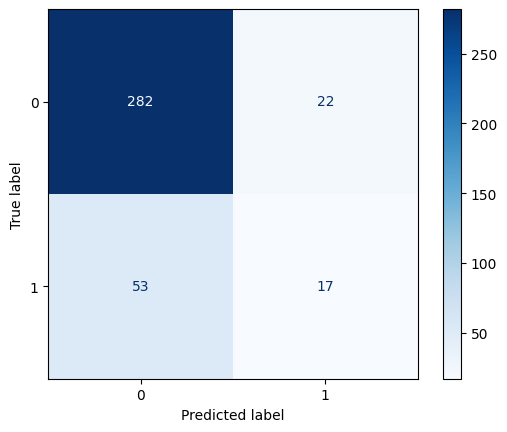

classification_report
              precision    recall  f1-score   support

         0.0       0.84      0.93      0.88       304
         1.0       0.44      0.24      0.31        70

    accuracy                           0.80       374
   macro avg       0.64      0.59      0.60       374
weighted avg       0.77      0.80      0.78       374


Train_Set
--------------------------------------


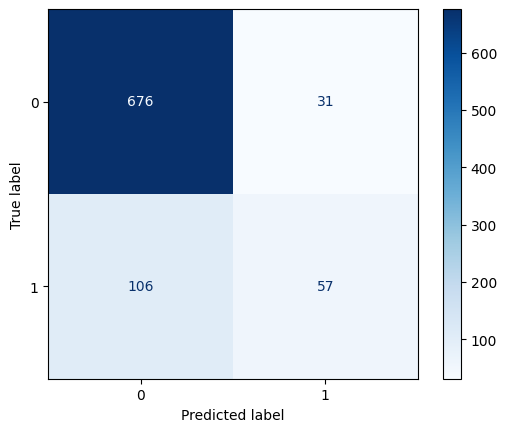

classification_report
              precision    recall  f1-score   support

         0.0       0.86      0.96      0.91       707
         1.0       0.65      0.35      0.45       163

    accuracy                           0.84       870
   macro avg       0.76      0.65      0.68       870
weighted avg       0.82      0.84      0.82       870



In [459]:
xgb2 = XGBClassifier(gamma=0.5, learning_rate=0.3, max_depth=2, subsample=0.2, random_state=42)

xgb2.fit(X_train_phase1, y_train)

eval_metric(xgb2, X_train_phase1, y_train, X_test_phase1, y_test)

In [460]:
# saving results
results10 = metric_df(xgb2, X_train_phase1, y_train, X_test_phase1, y_test, 'XGBClassifier - 2')

results = pd.concat([results, results10], axis=1, ignore_index=False)

results.T

,accuracy,precision,recall,f1,auc,True Negative Rate,False Positive Rate,False Negative Rate,True Positive Rate
Logistic Regression - 1,0.82,0.57,0.11,0.19,0.75,0.98,0.02,0.89,0.11
Logistic Regression - 2,0.70,0.34,0.64,0.44,0.75,0.71,0.29,0.36,0.64
Random Forest - 1,0.80,0.44,0.17,0.25,0.69,0.95,0.05,0.83,0.17
Random Forest - 2,0.69,0.34,0.66,0.44,0.73,0.70,0.30,0.34,0.66
KNN - 1,0.80,0.43,0.17,0.24,0.63,0.95,0.05,0.83,0.17
KNN - 2,0.82,0.56,0.07,0.13,0.69,0.99,0.01,0.93,0.07
AdaBoost - 1,0.81,0.50,0.14,0.22,0.67,0.97,0.03,0.86,0.14
AdaBoost - 2,0.80,0.43,0.19,0.26,0.66,0.94,0.06,0.81,0.19
XGBClassifier - 1,0.78,0.35,0.20,0.25,0.66,0.91,0.09,0.80,0.20
XGBClassifier - 2,0.80,0.44,0.24,0.31,0.67,0.93,0.07,0.76,0.24


At this point we can determine that the LR2 model is still providing the best results. The next step is to utilize the prediction probability and set thresholds to classify patients into three categories: those at risk, those not at risk, and those with inconclusive results. Those patients which are determined to be within the inconclusive class, will be passed on to Phase 2.

## <span style="color:#287D8EFF">6.2 Visualizing Phase 1 Model Results</span> 

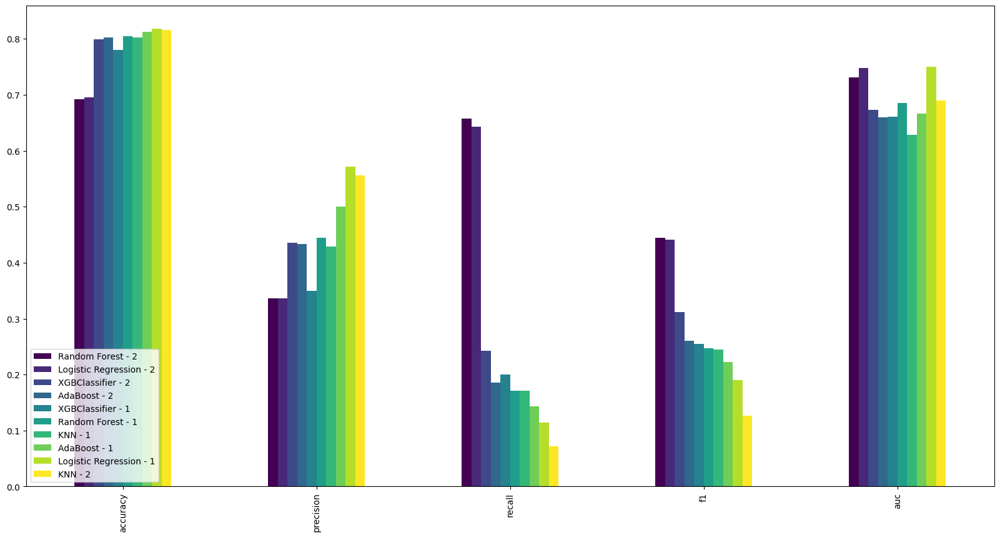

In [461]:
# Plotting Model Results for Comparison
results[:5].sort_values(by='f1', axis=1, ascending=False).plot.bar(figsize = (20,10), cmap="viridis")
plt.legend(loc="lower left")
plt.show()

The main scoring metric for this project is F1 as it provides the best balance between precision and recall scores.  Since we are trying to determine those patients which have inconclusive results to pass on to the next phase of screening, we want to make sure we can see some accuracy in determining no/low risk vs. high risk potential. That being said, it is more costly to the project to have false negatives than it is false positive. If a patient receives a false positive they would seek treatment or evaluation for sarcopenia. If they are deemed as a false negative then the disease is not detected and preventative measures or treatment will not take place. So, recall is also a good evaluation metric for our purposes. Let's take a closer look at each of these measures individually. 

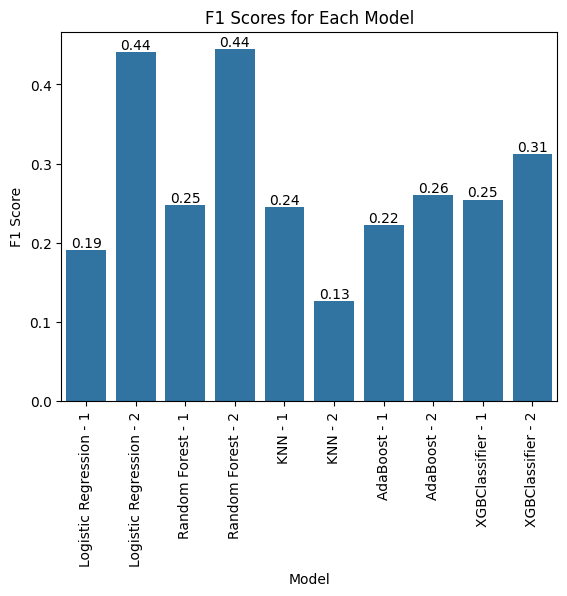

In [462]:
# comparing f1 scores
f1_scores = results.loc['f1']
sns.barplot(x=f1_scores.index, y=f1_scores.values)
plt.title('F1 Scores for Each Model')
plt.xlabel('Model')
plt.xticks(rotation=90)
plt.ylabel('F1 Score')
bar_labels = [f'{value:.2f}' for value in f1_scores]
plt.bar_label(plt.gca().containers[0], labels=bar_labels)
plt.show()

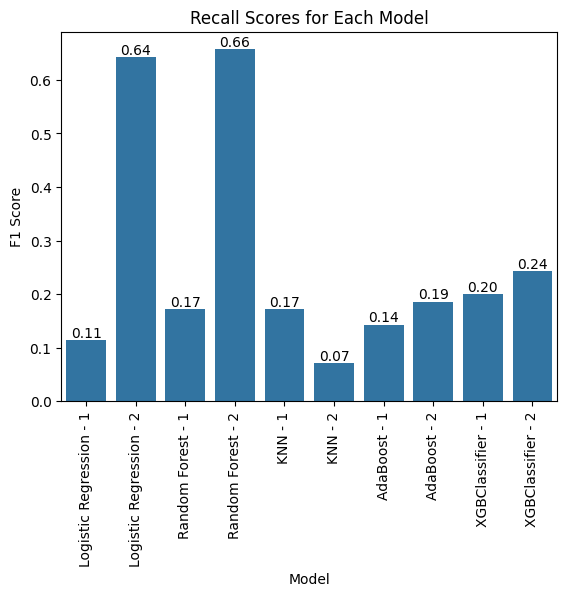

In [463]:
# comparing f1 scores
recall_scores = results.loc['recall']
sns.barplot(x=recall_scores.index, y=recall_scores.values)
plt.title('Recall Scores for Each Model')
plt.xlabel('Model')
plt.xticks(rotation=90)
plt.ylabel('F1 Score')
bar_labels = [f'{value:.2f}' for value in recall_scores]
plt.bar_label(plt.gca().containers[0], labels=bar_labels)
plt.show()

After reviewing all models, we can see that Logistic Regression model 2 and Random Forest Model 2 are outperforming all other models with the highest F1, AUC, and Recall scores. However, since Logistic Regression is the simplest route to these scores, it will be the best model for phase 1. 

## <span style="color:#287D8EFF">6.3 Feature Importance Phase 1</span>

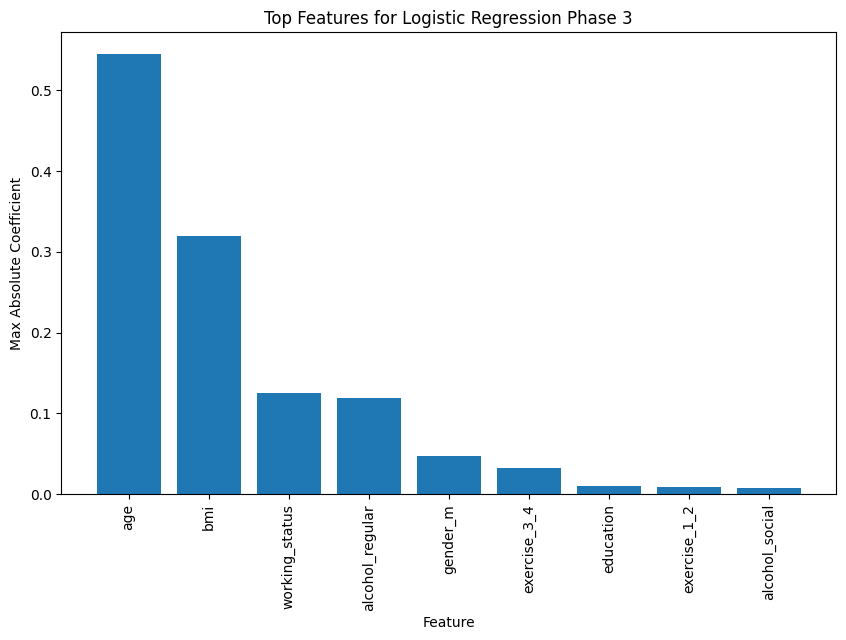

In [464]:
# get the coefficients for all classes
coefficients = lr2.coef_

# create a dataframe for each class's coefficients
feature_importance = pd.DataFrame(coefficients.T, columns=[f'Class_{i}' for i in range(coefficients.shape[0])])
feature_importance['Feature'] = X_train_phase1.columns

# calculate the overall importance using max absolute coefficient across classes
feature_importance['Max_Abs_Coefficient'] = np.max(np.abs(coefficients), axis=0)

# sort by overall importance
feature_importance = feature_importance.sort_values(by='Max_Abs_Coefficient', ascending=False)

# select features with non-zero coefficients for any class
selected_features = feature_importance[
    (feature_importance.iloc[:, :-2] != 0).any(axis=1)
]

# plot top 10 features
plt.figure(figsize=(10, 6))
plt.bar(selected_features['Feature'], selected_features['Max_Abs_Coefficient'])
plt.xlabel('Feature')
plt.ylabel('Max Absolute Coefficient')
plt.xticks(rotation=90)
plt.title('Top Features for Logistic Regression Phase 3')
plt.show()

Key indicators from phase 1 are:  
* age
* bmi
* working_status
* alcohol_regular

In [590]:
# create final X_train_phase1
p1_keep = ['age', 'bmi', 'working_status', 'alcohol_regular']
X_train_phase1 = X_train[p1_keep]
X_test_phase1 = X_test[p1_keep]

In [591]:
# scale data and save scaler
# establish which features are numerical vs. categorical
p1_numerical = ['age', 'bmi']

p1_categorical = ['working_status', 'alcohol_regular']
                                                   
# create preprocessor
p1_preprocessor = ColumnTransformer(
    transformers=[
        ('num', StandardScaler(), p1_numerical),
        ('cat', 'passthrough', p1_categorical)
    ]
)

# fit preprocessor on training data
p1_preprocessor.fit(X_train_phase1)

# transform train and test data
X_train_phase1 = p1_preprocessor.transform(X_train_phase1)
X_test_phase1 = p1_preprocessor.transform(X_test_phase1)

In [593]:
# converting back to dataframe for filtering and evaluation methods after modeling
X_train_phase1 = pd.DataFrame(X_train_phase1, columns=p1_keep)
X_test_phase1 = pd.DataFrame(X_test_phase1, columns=p1_keep)

In [594]:
# refit lr2 on reduced features and check scores
lr2.fit(X_train_phase1, y_train)
lr2_scores = metric_df(lr2, X_train_phase1, y_train, X_test_phase1, y_test, 'LR2 - reduced')
lr2_scores.T

,accuracy,precision,recall,f1,auc,True Negative Rate,False Positive Rate,False Negative Rate,True Positive Rate
LR2 - reduced,0.70,0.35,0.70,0.47,0.75,0.70,0.30,0.30,0.70


In [467]:
# compare to previous version with more variables
results['Logistic Regression - 2']

accuracy              0.70
precision             0.34
recall                0.64
f1                    0.44
auc                   0.75
True Negative Rate    0.71
False Positive Rate   0.29
False Negative Rate   0.36
True Positive Rate    0.64
Name: Logistic Regression - 2, dtype: float64

After refitting the LR2 model on the reduced features, the model has a slight increase in precision, recall and f1 scores. The reduced feature model will be saved as the final model for phase 1 - prescreening.

## <span style="color:#287D8EFF">6.4 Saving Phase 1: Prescreening Model</span> 
Now that the best model for our at home prescreening phase has been identified, we can save the model for later use and filter our patients which are inconclusive to pass on to phase 2. Before saving, we need to refit the StandardScaler() on only those variables we are keeping so that we can save the scaler object for use during deployment.

In [595]:
from pickle import dump

# save lr2 as phase1 model
dump(lr2, open('sarcopenia_phase1.pkl', 'wb'))

# save preprocessor 
dump(p1_preprocessor, open('sarcopenia_p1_preprocessor.pkl', 'wb'))

## <span style="color:#287D8EFF">6.5 Using Phase 1 Model to Filter Patients</span>

### <span style="color:#55c667ff"> Determining Thresholds for Inconclusive Results </span>
To determine a good threshold for passing on patients to the next phase, we will take a look at the probability distribution for correct predictions. Base on where the majority of accurate predictions are, upper and lower threshold limits will be established. It is important to be conservative as falsely clearing a patient could be costly.

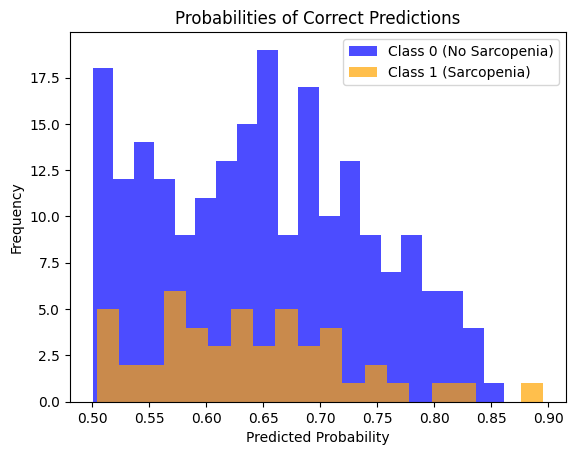

In [596]:
# extracting probabilities for lr2 model phase 1
phase1_probabilities = lr2.predict_proba(X_test_phase1)

# getting predicted classes
phase1_predictions = lr2.predict(X_test_phase1)

# getting correct predictions
phase1_correct = (phase1_predictions == y_test)

# filtering probabilities where predictions were correct
correct_probs = phase1_probabilities[phase1_correct]

# probabilities for each class
correct_probs_0 = correct_probs[y_test[phase1_correct] == 0, 0]
correct_probs_1 = correct_probs[y_test[phase1_correct] == 1, 1]

# visualize probabilities for correct predictions to determine thresholds
plt.hist(correct_probs_0, bins=20, alpha=0.7, label='Class 0 (No Sarcopenia)', color='blue')
plt.hist(correct_probs_1, bins=20, alpha=0.7, label='Class 1 (Sarcopenia)', color='orange')

plt.xlabel("Predicted Probability")
plt.ylabel("Frequency")
plt.title("Probabilities of Correct Predictions")
plt.legend()
plt.show()

Based off of the probabilities for correct predictions, thresholds will be set as follows:  
* If predicted probability for sarcopenia was > 0.85 classify as high and remove from test set.
* If predicted probability for sarcopenia was < .25 classify as low and remove from test set.

Those patients outside of these parameters are deemed inconclusive and will be passed to phase 2.

### <span style="color:#55c667ff"> Filtering Patients to Phase 2: </span>

In [597]:
# get probabilities for positive class
probabilities = lr2.predict_proba(X_test_phase1)[:,1]

# add predicted probabilities to the DataFrame for tracking
X_test_phase1 = X_test_phase1.copy()
X_test_phase1['predicted_probability'] = probabilities

# create label for patient risk
X_test_phase1['risk_label'] = X_test_phase1['predicted_probability'].apply(
    lambda prob: 'low' if prob < 0.25 else 'high' if prob > 0.85 else 'inconclusive'
)

In [598]:
# check distribution of risk labels
print(X_test_phase1['risk_label'].value_counts())

# view a few rows of the labeled DataFrame
print(X_test_phase1[['predicted_probability', 'risk_label']].head())

risk_label
inconclusive    340
low              33
high              1
Name: count, dtype: int64
   predicted_probability    risk_label
0                   0.53  inconclusive
1                   0.31  inconclusive
2                   0.53  inconclusive
3                   0.17           low
4                   0.39  inconclusive


In [599]:
# add patient_id back for patient tracking
X_test_phase1['patient_id'] = X_test['patient_id']

# filter inconclusive patients
phase2_data = X_test_phase1[X_test_phase1['risk_label'] == 'inconclusive']

In [600]:
phase2_data['risk_label'].value_counts()

risk_label
inconclusive    340
Name: count, dtype: int64

# <span style="color:#29AF7FFF">7. Phase 2: Intermediate Screening</span>

<a id="7"></a>
<a href="#toc" class="btn btn-primary btn-sm" role="button" aria-pressed="true"
style="color:blue; background-color:#d9dddc" data-toggle="popover">Content</a> 

In Phase 2 all variables except for clinical tests: mmse, cst, grip strength, and gait speed will be used. This is a more indepth intermediate screening to determine if patients should seek out clinical evaluation for sarcopenia. note: 'weight', 'height' will also be excluded as they are used for the calculation of bmi and provide redundant information.

### <span style="color:#55c667ff"> Setting up Train and Test Data for Phase 2: </span>

In [613]:
# variables to exclude
p2_exclude = ['mmse', 'low_cst', 'gait_speed', 'low_grip_strength', 'weight', 'height']

# create phase 2 train and test sets
X_train_phase2 = X_train.drop(p2_exclude, axis=1)

X_test_phase2 = X_test.drop(p2_exclude, axis=1)

print('Shape of phase 1 train: ', X_train_phase2.shape)
print('Shape of phase 1 test: ', X_test_phase2.shape)

Shape of phase 1 train:  (870, 26)
Shape of phase 1 test:  (374, 26)


In [614]:
# using phase2_patient_ids to filter X_test and y_test for phase 2
X_test_phase2 = X_test_phase2[X_test_phase2['patient_id'].isin(phase2_data['patient_id'])]
y_test_phase2 = y_test.loc[y_test.index.isin(X_test_phase2.index)]

In [615]:
phase2_vars = ['age', 'waist', 'hip', 'smoking_packs_per_yr', 'dm_duration',
       'dyslipidemia_duration', 'kah_duration', 'ht_duration', 'education', 'bmi',
       'insulin', 'hipotiroidi', 'astim', 'koah', 'op', 
        'working_status', 'dm_meds', 'dyslipidemia_meds', 'ht_meds', 
        'additional_illness', 'alcohol_regular', 'alcohol_social',
        'exercise_1_2', 'exercise_3_4', 'gender_m']

In [616]:
# removing 'patient_id' for scaling and modeling
X_train_phase2.drop('patient_id', axis=1, inplace=True)
X_test_phase2.drop('patient_id', axis=1, inplace=True)

In [617]:
# establish with features are numerical vs. categorical
p2_numerical = ['age', 'waist', 'hip', 'smoking_packs_per_yr', 'dm_duration',
       'dyslipidemia_duration', 'kah_duration', 'ht_duration', 'education', 'bmi']


p2_categorical = ['insulin', 'hipotiroidi', 'astim', 'koah', 'op', 
                  'working_status', 'dm_meds', 'dyslipidemia_meds', 'ht_meds', 
                  'additional_illness', 'alcohol_regular', 'alcohol_social', 
                  'exercise_1_2', 'exercise_3_4', 'gender_m']

# create preprocessor
p2_preprocessor = ColumnTransformer(
    transformers=[
        ('num', StandardScaler(), p2_numerical),
        ('cat', 'passthrough', p2_categorical)
    ]
)

# fit preprocessor on training data
p2_preprocessor.fit(X_train_phase2)

# transform train and test data
X_train_phase2 = p2_preprocessor.transform(X_train_phase2)
X_test_phase2 = p2_preprocessor.transform(X_test_phase2)

In [618]:
# converting back to dataframe for filtering and evaluation methods after modeling
X_train_phase2 = pd.DataFrame(X_train_phase2, columns=phase2_vars)
X_test_phase2 = pd.DataFrame(X_test_phase2, columns=phase2_vars)

## <span style="color:#287D8EFF">7.1 Phase 2: Models</span> 
### <span style="color:#55c667ff"> Logistic Regression - 1 (phase 2) </span>

Test_Set
--------------------------------------


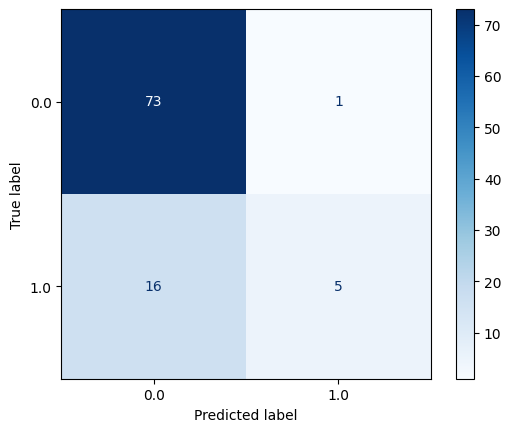

classification_report
              precision    recall  f1-score   support

         0.0       0.82      0.99      0.90        74
         1.0       0.83      0.24      0.37        21

    accuracy                           0.82        95
   macro avg       0.83      0.61      0.63        95
weighted avg       0.82      0.82      0.78        95


Train_Set
--------------------------------------


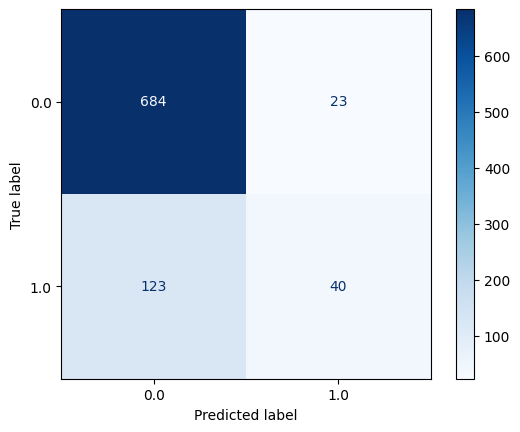

classification_report
              precision    recall  f1-score   support

         0.0       0.85      0.97      0.90       707
         1.0       0.63      0.25      0.35       163

    accuracy                           0.83       870
   macro avg       0.74      0.61      0.63       870
weighted avg       0.81      0.83      0.80       870



In [619]:
# initialize logisitic regression
lr = LogisticRegression(random_state=42)

# fit on training data
lr.fit(X_train_phase2, y_train)

eval_metric(lr, X_train_phase2, y_train, X_test_phase2, y_test_phase2)

In [620]:
# create dataframe to hold model evaluation results
p2_results = metric_df(lr, X_train_phase2, y_train, X_test_phase2, y_test_phase2, 'Logistic Regression - 1')
p2_results.T

,accuracy,precision,recall,f1,auc,True Negative Rate,False Positive Rate,False Negative Rate,True Positive Rate
Logistic Regression - 1,0.82,0.83,0.24,0.37,0.78,0.99,0.01,0.76,0.24


First model results return low f1.

### <span style="color:#55c667ff"> Logistic Regression - 2 (phase 2) </span>

In [609]:
# logistic regression with gridsearch for best parameters
param_grid = [
    {'penalty':['l1','l2','elasticnet','none'],
    'C' : [100, 10, 1.0, 0.1, 0.01],
    'solver': ['lbfgs','newton-cg','liblinear'],
    'class_weight': ['balanced', None]
    }
]

clf = GridSearchCV(lr, param_grid, cv=5, verbose=1, n_jobs=-1, scoring='f1')
best_clf = clf.fit(X_train_phase2, y_train)
best_clf.best_estimator_

Fitting 5 folds for each of 120 candidates, totalling 600 fits


LogisticRegression(C=10, class_weight='balanced', penalty='l1', random_state=42,
                   solver='liblinear')

Test_Set
--------------------------------------


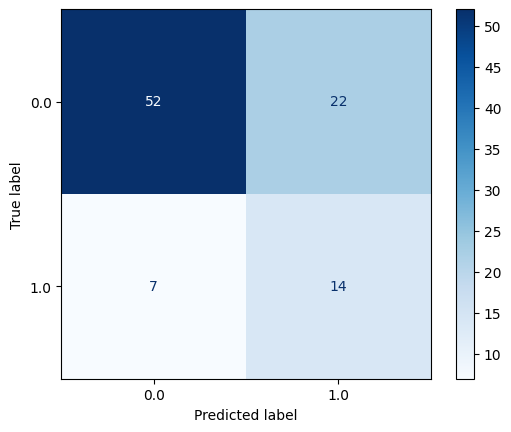

classification_report
              precision    recall  f1-score   support

         0.0       0.88      0.70      0.78        74
         1.0       0.39      0.67      0.49        21

    accuracy                           0.69        95
   macro avg       0.64      0.68      0.64        95
weighted avg       0.77      0.69      0.72        95


Train_Set
--------------------------------------


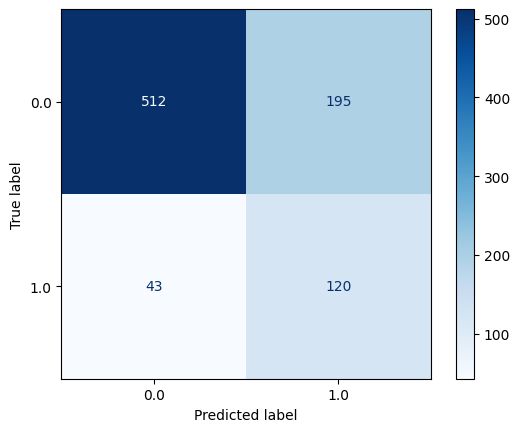

classification_report
              precision    recall  f1-score   support

         0.0       0.92      0.72      0.81       707
         1.0       0.38      0.74      0.50       163

    accuracy                           0.73       870
   macro avg       0.65      0.73      0.66       870
weighted avg       0.82      0.73      0.75       870



In [621]:
# fitting best parameters
lr3 = LogisticRegression(C=10, class_weight='balanced', penalty='l1', random_state=42,
                   solver='liblinear')
lr3.fit(X_train_phase2, y_train)
eval_metric(lr3, X_train_phase2, y_train, X_test_phase2, y_test_phase2)

In [622]:
# saving results
p2_results2 = metric_df(lr3, X_train_phase2, y_train, X_test_phase2, y_test_phase2, 'Logistic Regression - 2')
p2_results = pd.concat([p2_results, p2_results2], axis=1, ignore_index=False)
p2_results.T

,accuracy,precision,recall,f1,auc,True Negative Rate,False Positive Rate,False Negative Rate,True Positive Rate
Logistic Regression - 1,0.82,0.83,0.24,0.37,0.78,0.99,0.01,0.76,0.24
Logistic Regression - 2,0.69,0.39,0.67,0.49,0.77,0.70,0.30,0.33,0.67


LR3 model provides best results for logistic regression phase 2 with a higher f1 and recall than the first model.

### <span style="color:#55c667ff"> Random Forest - 1 (phase 2) </span>

Test_Set
--------------------------------------


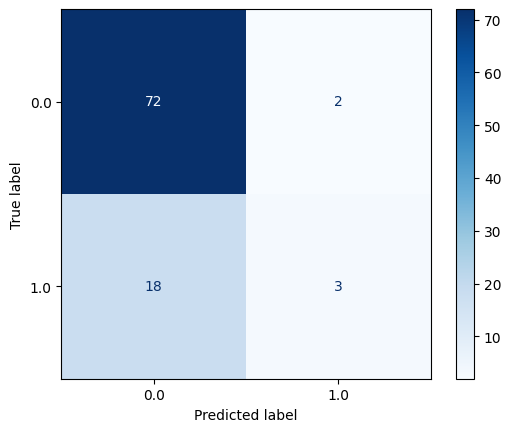

classification_report
              precision    recall  f1-score   support

         0.0       0.80      0.97      0.88        74
         1.0       0.60      0.14      0.23        21

    accuracy                           0.79        95
   macro avg       0.70      0.56      0.55        95
weighted avg       0.76      0.79      0.73        95


Train_Set
--------------------------------------


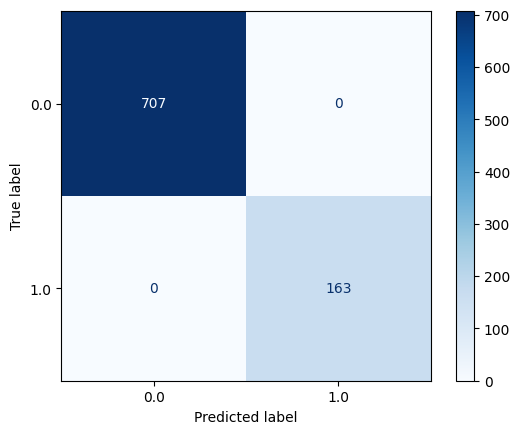

classification_report
              precision    recall  f1-score   support

         0.0       1.00      1.00      1.00       707
         1.0       1.00      1.00      1.00       163

    accuracy                           1.00       870
   macro avg       1.00      1.00      1.00       870
weighted avg       1.00      1.00      1.00       870



In [623]:
# random forest model with default parameters
rf = RandomForestClassifier(random_state=42)

# fit to training data
rf.fit(X_train_phase2, y_train)

# get evaluation metrics
eval_metric(rf, X_train_phase2, y_train, X_test_phase2, y_test_phase2)

In [624]:
# saving results
p2_results3 = metric_df(rf, X_train_phase2, y_train, X_test_phase2, y_test_phase2, 'Random Forest - 1')
p2_results = pd.concat([p2_results, p2_results3], axis=1, ignore_index=False)
p2_results.T

,accuracy,precision,recall,f1,auc,True Negative Rate,False Positive Rate,False Negative Rate,True Positive Rate
Logistic Regression - 1,0.82,0.83,0.24,0.37,0.78,0.99,0.01,0.76,0.24
Logistic Regression - 2,0.69,0.39,0.67,0.49,0.77,0.70,0.30,0.33,0.67
Random Forest - 1,0.79,0.60,0.14,0.23,0.75,0.97,0.03,0.86,0.14


Random Forest with default parameters is overfitting. Finetuning should eliminate the issue and hopefully increase F1 and recall as well.

### <span style="color:#55c667ff"> Random Forest - 2 (phase 2) </span>

In [530]:
# define parameters for grid search
param_grid = {
    'n_estimators': [50,100,200],
    'criterion': ['gini', 'entropy', 'log_loss'],
    'max_depth': [3, 5, 7, None],
    'max_features': [1,3,5],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 3, 4],
    'class_weight': ['balanced', 'balanced_subsample', None]
}

# initialize random forest
rf = RandomForestClassifier(random_state=42)

# run grid search
grid_search = GridSearchCV(
    estimator=rf,
    param_grid=param_grid,
    scoring='f1',
    cv=5, n_jobs=-1)

best_rf = grid_search.fit(X_train_phase2, y_train)
best_rf.best_estimator_

RandomForestClassifier(class_weight='balanced_subsample', max_depth=5,
                       max_features=5, min_samples_leaf=4, min_samples_split=10,
                       n_estimators=50, random_state=42)

Test_Set
--------------------------------------


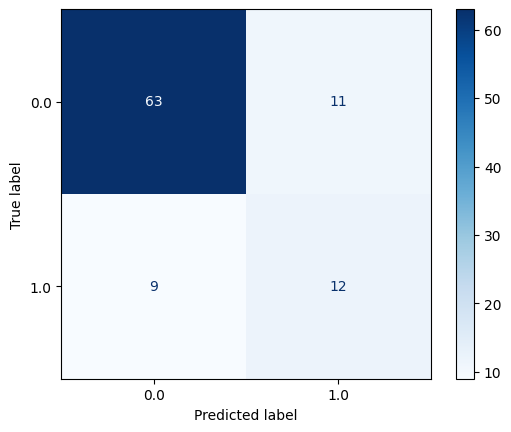

classification_report
              precision    recall  f1-score   support

         0.0       0.88      0.85      0.86        74
         1.0       0.52      0.57      0.55        21

    accuracy                           0.79        95
   macro avg       0.70      0.71      0.70        95
weighted avg       0.80      0.79      0.79        95


Train_Set
--------------------------------------


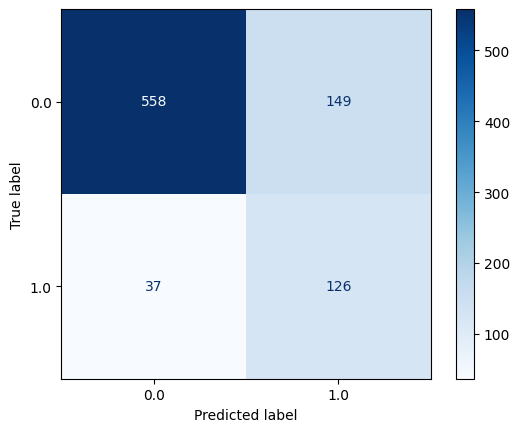

classification_report
              precision    recall  f1-score   support

         0.0       0.94      0.79      0.86       707
         1.0       0.46      0.77      0.58       163

    accuracy                           0.79       870
   macro avg       0.70      0.78      0.72       870
weighted avg       0.85      0.79      0.80       870



In [625]:
# apply best parameters
rf3 = RandomForestClassifier(class_weight='balanced_subsample', max_depth=5,
                       max_features=5, min_samples_leaf=4, min_samples_split=10,
                       n_estimators=50, random_state=42)

rf3.fit(X_train_phase2, y_train)
eval_metric(rf3, X_train_phase2, y_train, X_test_phase2, y_test_phase2)

In [626]:
# saving results
p2_results4 = metric_df(rf3, X_train_phase2, y_train, X_test_phase2, y_test_phase2, 'Random Forest - 2')
p2_results = pd.concat([p2_results, p2_results4], axis=1, ignore_index=False)
p2_results.T

,accuracy,precision,recall,f1,auc,True Negative Rate,False Positive Rate,False Negative Rate,True Positive Rate
Logistic Regression - 1,0.82,0.83,0.24,0.37,0.78,0.99,0.01,0.76,0.24
Logistic Regression - 2,0.69,0.39,0.67,0.49,0.77,0.70,0.30,0.33,0.67
Random Forest - 1,0.79,0.60,0.14,0.23,0.75,0.97,0.03,0.86,0.14
Random Forest - 2,0.79,0.52,0.57,0.55,0.76,0.85,0.15,0.43,0.57


The second Random Forest Model is returning the highest f1 score with a good balance between precision and recall, but has a lower AUC and recall. We see a decrease in true positives and an increase in false negatives, which is not ideal for our purposes. In addition, logistic regression provides similar results with less complexity. So, it will remain the current best model for phase 2.

### <span style="color:#55c667ff"> AdaBoost - 1 (phase 2) </span>

Test_Set
--------------------------------------


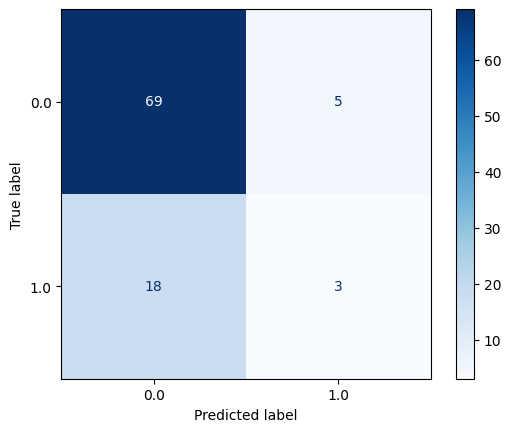

classification_report
              precision    recall  f1-score   support

         0.0       0.79      0.93      0.86        74
         1.0       0.38      0.14      0.21        21

    accuracy                           0.76        95
   macro avg       0.58      0.54      0.53        95
weighted avg       0.70      0.76      0.71        95


Train_Set
--------------------------------------


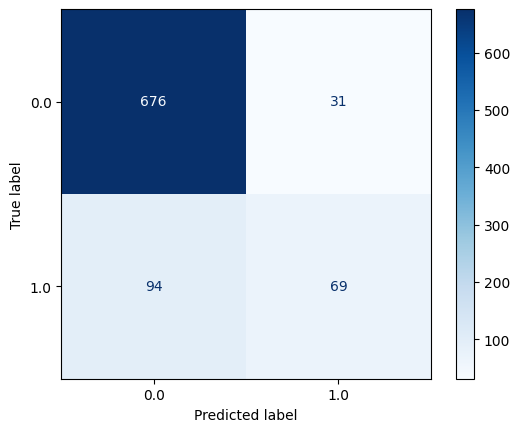

classification_report
              precision    recall  f1-score   support

         0.0       0.88      0.96      0.92       707
         1.0       0.69      0.42      0.52       163

    accuracy                           0.86       870
   macro avg       0.78      0.69      0.72       870
weighted avg       0.84      0.86      0.84       870



In [627]:
# initialize AdaBoostClassifier()
abc = AdaBoostClassifier(random_state=42)
abc.fit(X_train_phase2, y_train)

eval_metric(abc, X_train_phase2, y_train, X_test_phase2, y_test_phase2)

In [628]:
# saving results
p2_results5 = metric_df(abc, X_train_phase2, y_train, X_test_phase2, y_test_phase2, 'AdaBoost - 1')
p2_results = pd.concat([p2_results, p2_results5], axis=1, ignore_index=False)
p2_results.T

,accuracy,precision,recall,f1,auc,True Negative Rate,False Positive Rate,False Negative Rate,True Positive Rate
Logistic Regression - 1,0.82,0.83,0.24,0.37,0.78,0.99,0.01,0.76,0.24
Logistic Regression - 2,0.69,0.39,0.67,0.49,0.77,0.70,0.30,0.33,0.67
Random Forest - 1,0.79,0.60,0.14,0.23,0.75,0.97,0.03,0.86,0.14
Random Forest - 2,0.79,0.52,0.57,0.55,0.76,0.85,0.15,0.43,0.57
AdaBoost - 1,0.76,0.38,0.14,0.21,0.62,0.93,0.07,0.86,0.14


AdaBoostClassifier with default parameters is not returning good results compared to other models. 

### <span style="color:#55c667ff"> AdaBoost - 2 (phase 2) </span>

In [554]:
# define parameters for grid search
from sklearn.tree import DecisionTreeClassifier
param_grid = {
    'n_estimators': [50, 100, 200, 300, 500],
    'learning_rate': [0.97, 0.5, 0.3, 0.1, 0.05, 0.01],
    'algorithm': ['SAMME', 'SAMME.R'],
}

# run grid search
grid_search = GridSearchCV(
    estimator=abc,
    param_grid=param_grid,
    scoring='f1',
    cv=5, n_jobs=-1)

best_abc = grid_search.fit(X_train_phase2, y_train)
best_abc.best_estimator_

AdaBoostClassifier(learning_rate=0.5, n_estimators=500, random_state=42)

Test_Set
--------------------------------------


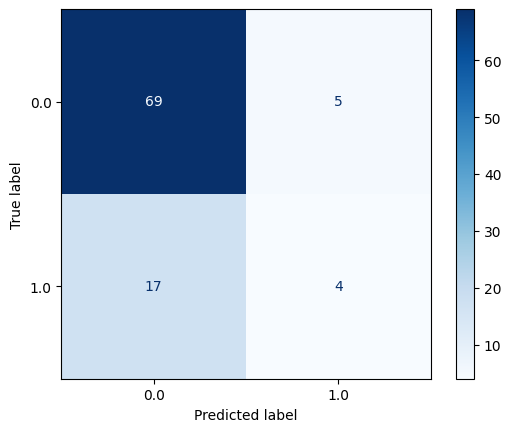

classification_report
              precision    recall  f1-score   support

         0.0       0.80      0.93      0.86        74
         1.0       0.44      0.19      0.27        21

    accuracy                           0.77        95
   macro avg       0.62      0.56      0.56        95
weighted avg       0.72      0.77      0.73        95


Train_Set
--------------------------------------


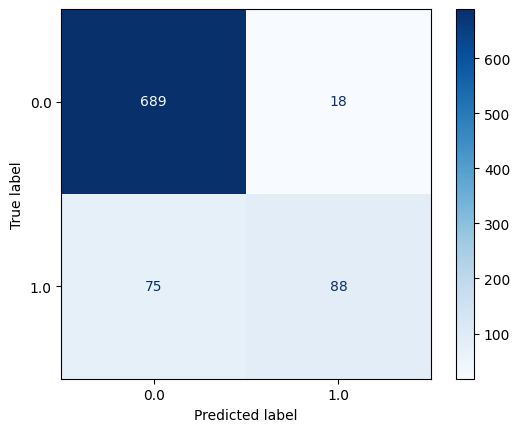

classification_report
              precision    recall  f1-score   support

         0.0       0.90      0.97      0.94       707
         1.0       0.83      0.54      0.65       163

    accuracy                           0.89       870
   macro avg       0.87      0.76      0.80       870
weighted avg       0.89      0.89      0.88       870



In [629]:
# fitting best parameters
abc3 = AdaBoostClassifier(learning_rate=0.5, n_estimators=500, random_state=42)

abc3.fit(X_train_phase2, y_train)
eval_metric(abc3, X_train_phase2, y_train, X_test_phase2, y_test_phase2)

In [630]:
# saving results
p2_results6 = metric_df(abc3, X_train_phase2, y_train, X_test_phase2, y_test_phase2, 'AdaBoost - 2')
p2_results = pd.concat([p2_results, p2_results6], axis=1, ignore_index=False)
p2_results.T

,accuracy,precision,recall,f1,auc,True Negative Rate,False Positive Rate,False Negative Rate,True Positive Rate
Logistic Regression - 1,0.82,0.83,0.24,0.37,0.78,0.99,0.01,0.76,0.24
Logistic Regression - 2,0.69,0.39,0.67,0.49,0.77,0.70,0.30,0.33,0.67
Random Forest - 1,0.79,0.60,0.14,0.23,0.75,0.97,0.03,0.86,0.14
Random Forest - 2,0.79,0.52,0.57,0.55,0.76,0.85,0.15,0.43,0.57
AdaBoost - 1,0.76,0.38,0.14,0.21,0.62,0.93,0.07,0.86,0.14
AdaBoost - 2,0.77,0.44,0.19,0.27,0.61,0.93,0.07,0.81,0.19


Second logistic regression model is still providing the best scores for phase 2. 

### <span style="color:#55c667ff"> XGBoost - 1 (phase 2) </span>

Test_Set
--------------------------------------


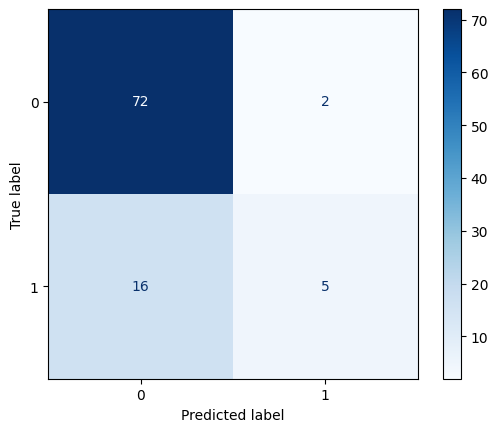

classification_report
              precision    recall  f1-score   support

         0.0       0.82      0.97      0.89        74
         1.0       0.71      0.24      0.36        21

    accuracy                           0.81        95
   macro avg       0.77      0.61      0.62        95
weighted avg       0.80      0.81      0.77        95


Train_Set
--------------------------------------


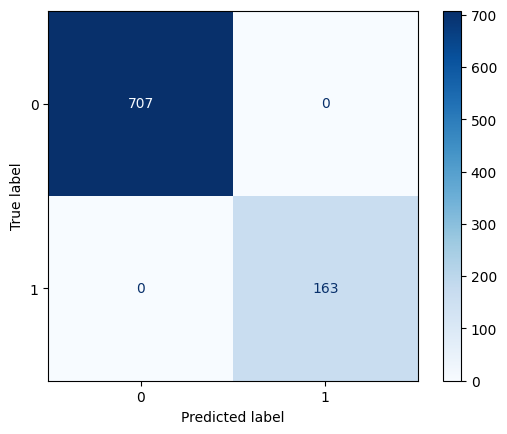

classification_report
              precision    recall  f1-score   support

         0.0       1.00      1.00      1.00       707
         1.0       1.00      1.00      1.00       163

    accuracy                           1.00       870
   macro avg       1.00      1.00      1.00       870
weighted avg       1.00      1.00      1.00       870



In [631]:
# initialize and fit xgboostclassifier
xgb = XGBClassifier(random_state=42)
xgb.fit(X_train_phase2, y_train)

eval_metric(xgb, X_train_phase2, y_train, X_test_phase2, y_test_phase2)

XGBoost with default parameters overfits on the data. 

In [632]:
# saving results
p2_results7 = metric_df(xgb, X_train_phase2, y_train, X_test_phase2, y_test_phase2, 'XGBoost - 1')
p2_results = pd.concat([p2_results, p2_results7], axis=1, ignore_index=False)
p2_results.T

,accuracy,precision,recall,f1,auc,True Negative Rate,False Positive Rate,False Negative Rate,True Positive Rate
Logistic Regression - 1,0.82,0.83,0.24,0.37,0.78,0.99,0.01,0.76,0.24
Logistic Regression - 2,0.69,0.39,0.67,0.49,0.77,0.70,0.30,0.33,0.67
Random Forest - 1,0.79,0.60,0.14,0.23,0.75,0.97,0.03,0.86,0.14
Random Forest - 2,0.79,0.52,0.57,0.55,0.76,0.85,0.15,0.43,0.57
AdaBoost - 1,0.76,0.38,0.14,0.21,0.62,0.93,0.07,0.86,0.14
AdaBoost - 2,0.77,0.44,0.19,0.27,0.61,0.93,0.07,0.81,0.19
XGBoost - 1,0.81,0.71,0.24,0.36,0.72,0.97,0.03,0.76,0.24


### <span style="color:#55c667ff"> XGBoost - 2 (phase 2) </span>

In [567]:
param_grid = {
    'max_depth': [1, 2, 3, 5],
    'learning_rate': [0.97, 0.5, 0.3, 0.1],
    'subsample': [0.1, 0.2, 0.3, 0.5],
    'gamma': [0.1, 0.3, 0.5]
    }

grid_search = GridSearchCV(
    estimator=xgb,
    param_grid=param_grid,
    scoring='f1',
    cv=5,
    n_jobs=-1
)

best_xgb = grid_search.fit(X_train_phase2, y_train)

best_xgb.best_params_

{'gamma': 0.1, 'learning_rate': 0.5, 'max_depth': 3, 'subsample': 0.2}

Test_Set
--------------------------------------


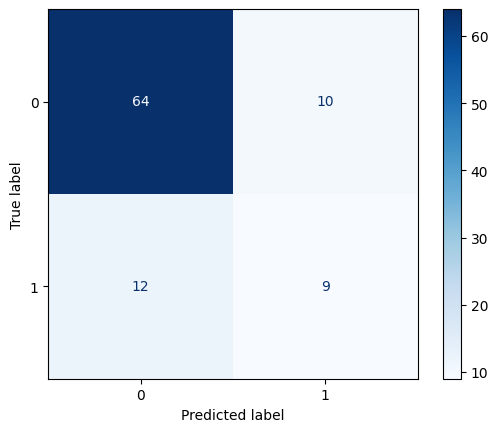

classification_report
              precision    recall  f1-score   support

         0.0       0.84      0.86      0.85        74
         1.0       0.47      0.43      0.45        21

    accuracy                           0.77        95
   macro avg       0.66      0.65      0.65        95
weighted avg       0.76      0.77      0.76        95


Train_Set
--------------------------------------


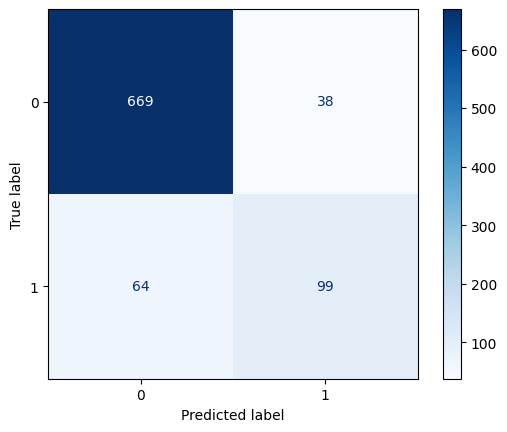

classification_report
              precision    recall  f1-score   support

         0.0       0.91      0.95      0.93       707
         1.0       0.72      0.61      0.66       163

    accuracy                           0.88       870
   macro avg       0.82      0.78      0.79       870
weighted avg       0.88      0.88      0.88       870



In [633]:
# fit best parameters
xgb3 = XGBClassifier(gamma=0.1, learning_rate=0.5, max_depth = 3, subsample = 0.2, random_state=42)
xgb3.fit(X_train_phase2, y_train)
eval_metric(xgb3, X_train_phase2, y_train, X_test_phase2, y_test_phase2)

In [634]:
# saving results
p2_results8 = metric_df(xgb3, X_train_phase2, y_train, X_test_phase2, y_test_phase2, 'XGBoost - 2')
p2_results = pd.concat([p2_results, p2_results8], axis=1, ignore_index=False)
p2_results.T

,accuracy,precision,recall,f1,auc,True Negative Rate,False Positive Rate,False Negative Rate,True Positive Rate
Logistic Regression - 1,0.82,0.83,0.24,0.37,0.78,0.99,0.01,0.76,0.24
Logistic Regression - 2,0.69,0.39,0.67,0.49,0.77,0.70,0.30,0.33,0.67
Random Forest - 1,0.79,0.60,0.14,0.23,0.75,0.97,0.03,0.86,0.14
Random Forest - 2,0.79,0.52,0.57,0.55,0.76,0.85,0.15,0.43,0.57
AdaBoost - 1,0.76,0.38,0.14,0.21,0.62,0.93,0.07,0.86,0.14
AdaBoost - 2,0.77,0.44,0.19,0.27,0.61,0.93,0.07,0.81,0.19
XGBoost - 1,0.81,0.71,0.24,0.36,0.72,0.97,0.03,0.76,0.24
XGBoost - 2,0.77,0.47,0.43,0.45,0.69,0.86,0.14,0.57,0.43


Right now, the second logisitc regression model has the best balance of scores for phase 2. Since false negatives are much more costly to the purpose of this project, LR3/Logistic Regression Model 2 will likely be the best model for phase 2 even though F1 is highest on Random Forest 2. Let's visualize the results to see how the scores compare.

## <span style="color:#287D8EFF">7.2 Phase 2: Visualizing Model Results</span> 

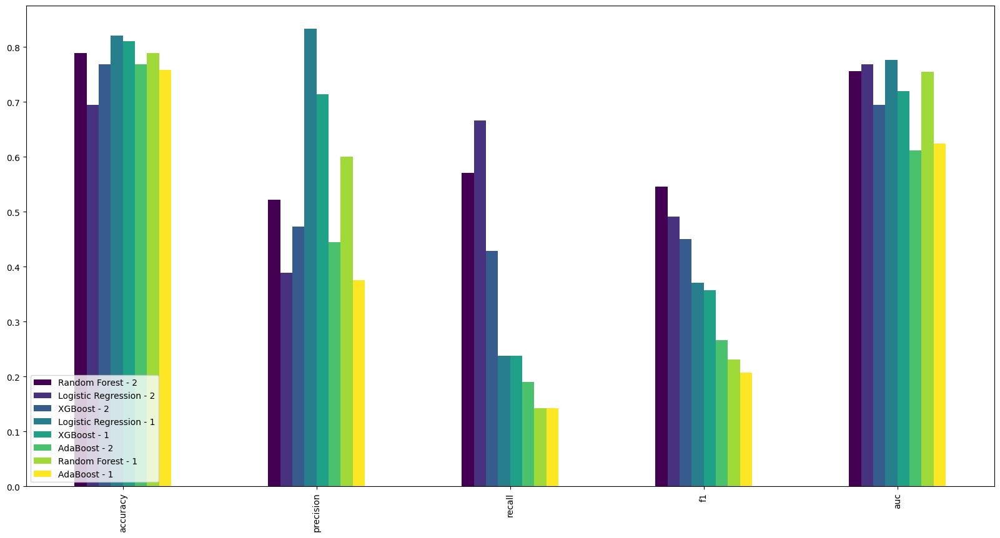

In [635]:
# Plotting Model Results for Comparison
p2_results[:5].sort_values(by='f1', axis=1, ascending=False).plot.bar(figsize = (20,10), cmap="viridis")
plt.legend(loc="lower left")
plt.show()

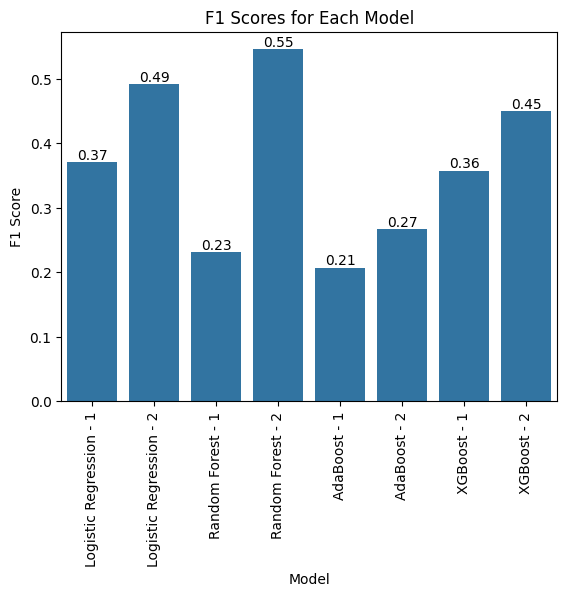

In [636]:
# comparing f1 scores
f1_scores = p2_results.loc['f1']
sns.barplot(x=f1_scores.index, y=f1_scores.values)
plt.title('F1 Scores for Each Model')
plt.xlabel('Model')
plt.xticks(rotation=90)
plt.ylabel('F1 Score')
bar_labels = [f'{value:.2f}' for value in f1_scores]
plt.bar_label(plt.gca().containers[0], labels=bar_labels)
plt.show()

RF2 has the highest F1 score of all models in phase 2.

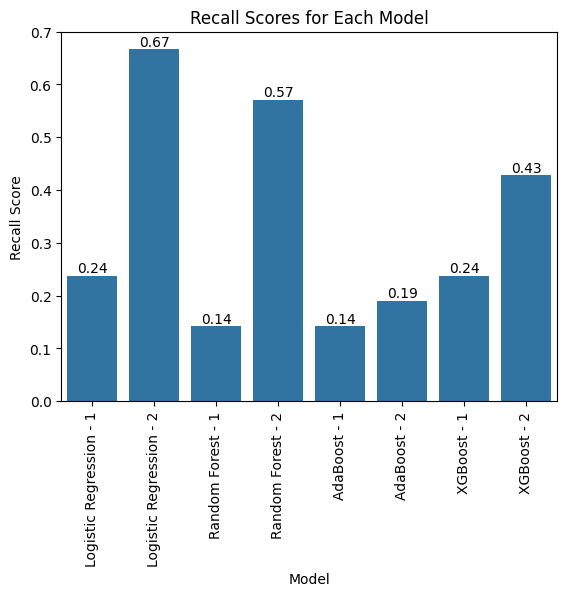

In [637]:
# comparing recall scores
recall_scores = p2_results.loc['recall']
sns.barplot(x=recall_scores.index, y=recall_scores.values)
plt.title('Recall Scores for Each Model')
plt.xlabel('Model')
plt.xticks(rotation=90)
plt.ylabel('Recall Score')
bar_labels = [f'{value:.2f}' for value in recall_scores]
plt.bar_label(plt.gca().containers[0], labels=bar_labels)
plt.show()

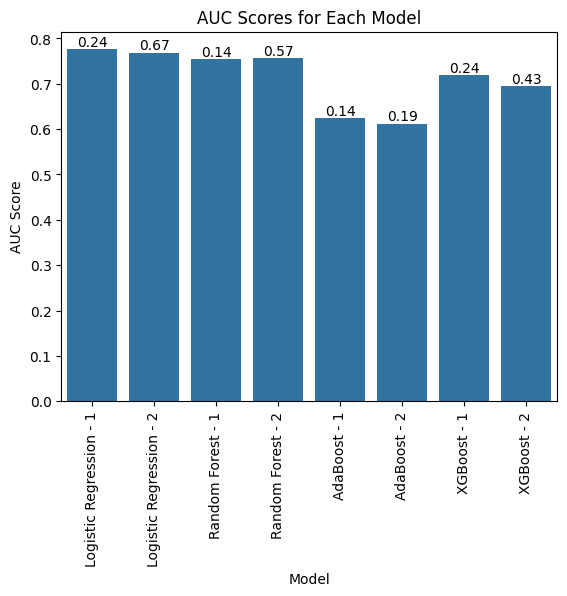

In [638]:
# comparing auc scores
auc_scores = p2_results.loc['auc']
sns.barplot(x=auc_scores.index, y=auc_scores.values)
plt.title('AUC Scores for Each Model')
plt.xlabel('Model')
plt.xticks(rotation=90)
plt.ylabel('AUC Score')
bar_labels = [f'{value:.2f}' for value in recall_scores]
plt.bar_label(plt.gca().containers[0], labels=bar_labels)
plt.show()

LR3/Logistic Regression Model 2 - Phase 2 is the best overall model for phase 2.  

## <span style="color:#287D8EFF">7.3 Phase 2: Feature Importance</span> 

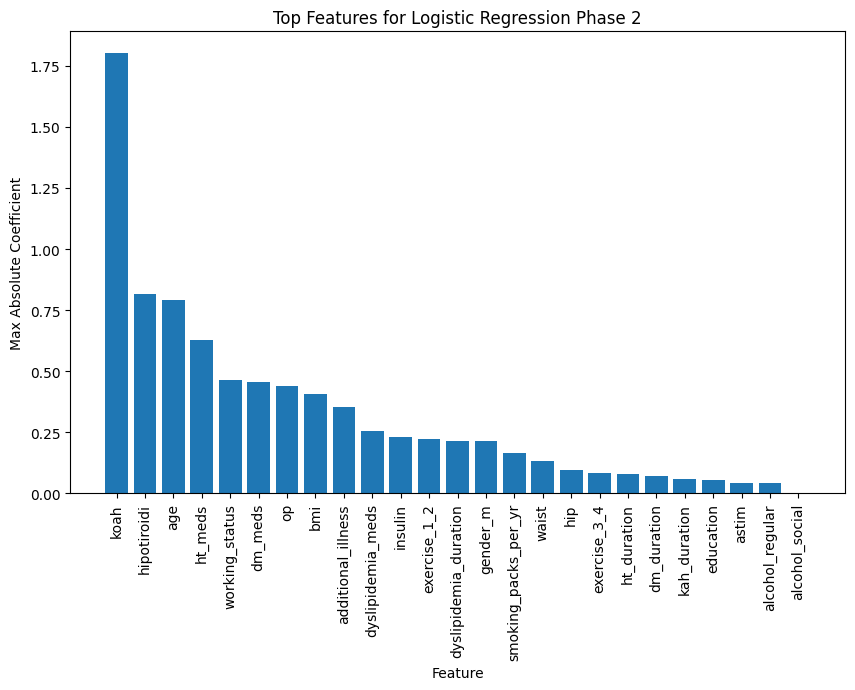

In [639]:
# get the coefficients for all classes
coefficients = lr3.coef_

# create a dataframe for each class's coefficients
feature_importance = pd.DataFrame(coefficients.T, columns=[f'Class_{i}' for i in range(coefficients.shape[0])])
feature_importance['Feature'] = X_train_phase2.columns

# calculate the overall importance using max absolute coefficient across classes
feature_importance['Max_Abs_Coefficient'] = np.max(np.abs(coefficients), axis=0)

# sort by overall importance
feature_importance = feature_importance.sort_values(by='Max_Abs_Coefficient', ascending=False)

# select features with non-zero coefficients for any class
selected_features = feature_importance[
    (feature_importance.iloc[:, :-2] != 0).any(axis=1)
]

# plot top 10 features
plt.figure(figsize=(10, 6))
plt.bar(selected_features['Feature'], selected_features['Max_Abs_Coefficient'])
plt.xlabel('Feature')
plt.ylabel('Max Absolute Coefficient')
plt.xticks(rotation=90)
plt.title('Top Features for Logistic Regression Phase 2')
plt.show()

Top 10 features will be saved and used for the final version of phase 2 logistic regression model.

In [643]:
# create model with top 10 features
p2_keep = ['koah', 'hipotiroidi', 'age', 'ht_meds', 'working_status', 'dm_meds', 
           'op', 'bmi', 'additional_illness', 'dyslipidemia_meds', 'patient_id']

# create final X_train_phase2
X_train_phase2 = X_train[p2_keep]
X_test_phase2 = X_test[p2_keep]

# refilter X_test_phase2 for inconclusive patients from phase 1
X_test_phase2 = X_test_phase2[X_test_phase2['patient_id'].isin(phase2_data['patient_id'])]

In [644]:
# drop patient_id
X_train_phase2.drop('patient_id', axis=1, inplace=True)
X_test_phase2.drop('patient_id', axis=1, inplace=True)

In [645]:
# scale data and save scaler
# establish which features are numerical vs. categorical
p2_numerical = ['age', 'bmi']

p2_categorical = ['koah', 'hipotiroidi', 'ht_meds', 'working_status', 'dm_meds',
 'op', 'additional_illness', 'dyslipidemia_meds']
                                                   
# create preprocessor
p2_preprocessor = ColumnTransformer(
    transformers=[
        ('num', StandardScaler(), p2_numerical),
        ('cat', 'passthrough', p2_categorical)
    ]
)

# fit preprocessor on training data
p2_preprocessor.fit(X_train_phase2)

# transform train and test data
X_train_phase2 = p2_preprocessor.transform(X_train_phase2)
X_test_phase2 = p2_preprocessor.transform(X_test_phase2)

In [647]:
# converting back to dataframe for filtering and evaluation methods after modeling
p2_cols = ['koah', 'hipotiroidi', 'age', 'ht_meds', 'working_status', 'dm_meds',
 'op', 'bmi', 'additional_illness', 'dyslipidemia_meds']

X_train_phase2 = pd.DataFrame(X_train_phase2, columns=p2_cols)
X_test_phase2 = pd.DataFrame(X_test_phase2, columns=p2_cols)

In [650]:
# refit lr3 on X_train_phase2 with reduced features
lr3.fit(X_train_phase2, y_train)
phase2_scores = metric_df(lr3, X_train_phase2, y_train, X_test_phase2, y_test_phase2, 'P2 - Results')
phase2_scores.T

,accuracy,precision,recall,f1,auc,True Negative Rate,False Positive Rate,False Negative Rate,True Positive Rate
P2 - Results,0.72,0.41,0.67,0.51,0.75,0.73,0.27,0.33,0.67


## <span style="color:#287D8EFF">7.4 Saving Phase 2 Model and Filtering Patients</span> 

### <span style="color:#55c667ff"> Pickle Phase 2 Model </span>

In [651]:
# save lr3 as phase1 model
dump(lr3, open('sarcopenia_phase2.pkl', 'wb'))

# save preprocessor 
dump(p2_preprocessor, open('sarcopenia_p2_preprocessor.pkl', 'wb'))

### <span style="color:#55c667ff"> Filtering Patients to Phase 3 </span>

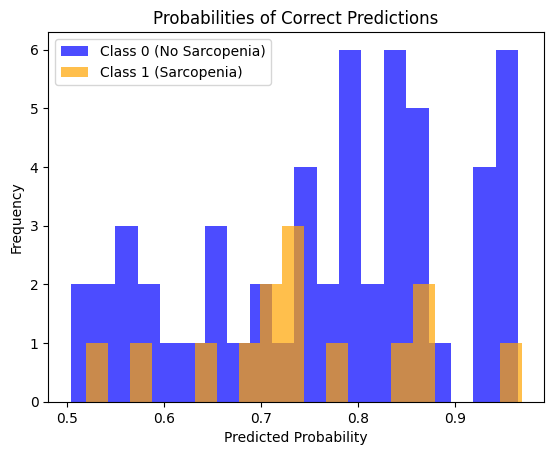

In [652]:
# extracting probabilities for lr3 model phase 2
phase2_probabilities = lr3.predict_proba(X_test_phase2)

# getting predicted classes
phase2_predictions = lr3.predict(X_test_phase2)

# getting correct predictions
phase2_correct = (phase2_predictions == y_test_phase2)

# filtering probabilities where predictions were correct
correct_probs = phase2_probabilities[phase2_correct]

# probabilities for each class
correct_probs_0 = correct_probs[y_test_phase2[phase2_correct] == 0, 0]
correct_probs_1 = correct_probs[y_test_phase2[phase2_correct] == 1, 1]

# visualize probabilities for correct predictions to determine thresholds
plt.hist(correct_probs_0, bins=20, alpha=0.7, label='Class 0 (No Sarcopenia)', color='blue')
plt.hist(correct_probs_1, bins=20, alpha=0.7, label='Class 1 (Sarcopenia)', color='orange')

plt.xlabel("Predicted Probability")
plt.ylabel("Frequency")
plt.title("Probabilities of Correct Predictions")
plt.legend()
plt.show()

Thresholds will be set as follows: if prob > 0.85 = high risk do not pass to phase 2, if prob < 0.25 low risk do not pass to phase 3. 

In [653]:
# get probabilities for positive class
probabilities = lr3.predict_proba(X_test_phase2)[:,1]

# add predicted probabilities to the DataFrame for tracking
X_test_phase2['predicted_probability'] = probabilities

# create label for patient risk
X_test_phase2['risk_label'] = X_test_phase2['predicted_probability'].apply(
    lambda prob: 'low' if prob < 0.20 else 'high' if prob > 0.85 else 'inconclusive'
)

In [654]:
# check distribution of risk labels
print(X_test_phase2['risk_label'].value_counts())

# view a few rows of the labeled DataFrame
print(X_test_phase2[['predicted_probability', 'risk_label']].head())

risk_label
inconclusive    63
low             27
high             5
Name: count, dtype: int64
   predicted_probability    risk_label
0                   0.60  inconclusive
1                   0.03           low
2                   0.16           low
3                   0.41  inconclusive
4                   0.21  inconclusive


In [655]:
# add patient_id back for patient tracking
X_test_phase2['patient_id'] = phase2_data['patient_id']

# filter inconclusive patients
phase3_data = X_test_phase2[X_test_phase2['risk_label'] == 'inconclusive']

In [ ]:
# using phase2_patient_ids to filter X_test and y_test for phase 2
X_test_phase2 = X_test_phase2[X_test_phase2['patient_id'].isin(phase2_data['patient_id'])]
y_test_phase2 = y_test.loc[y_test.index.isin(X_test_phase2.index)]

# <span style="color:#29AF7FFF">8. Phase 3: Clinical Evaluation</span>

<a id="8"></a>
<a href="#toc" class="btn btn-primary btn-sm" role="button" aria-pressed="true"
style="color:blue; background-color:#d9dddc" data-toggle="popover">Content</a> 

Phase 3 is the final phase of screening patients. In this phase we will phase 2 variables with 4 clinical exam results:  
* MMSE - Mini Mental State Exam which tests for cognitive function.
* CST - Chair Sit Test in which the patient is asked to fold their arms across their chest, sit in a chair, and stand 5 times. The result is the number of seconds this action took where results > 11 are considered 'low_cst' score in which it is assumed this is in excess of the normal time it should take to perform this task.
* Gait Speed - In which the patient is asked to walk a predefined distance for time. Higher times mean physical capacity deficit. 
* Grip Strength Test - In which grip strength is measured and if grip strength is <= 31, patient is categorized as having 'low_grip_strength'.

## <span style="color:#287D8EFF">8.1 Phase 3: Models</span> 

### <span style="color:#55c667ff"> Setting up Train and Test Data for Phase 3: </span>

In [658]:
# create phase 3 train and test sets
p3_vars = ['koah', 'hipotiroidi', 'age', 'ht_meds', 'working_status', 'dm_meds',
 'op', 'bmi', 'additional_illness', 'dyslipidemia_meds', 'mmse', 'low_cst',
 'low_grip_strength', 'gait_speed', 'patient_id']

X_train_phase3 = X_train[p3_vars]
X_test_phase3 = X_test[p3_vars]

In [659]:
# using phase3_data to filter X_test and y_test for phase 3
X_test_phase3 = X_test_phase3[X_test_phase3['patient_id'].isin(phase3_data['patient_id'])]
y_test_phase3 = y_test.loc[y_test.index.isin(X_test_phase3.index)]

In [660]:
# drop patient_id
X_train_phase3.drop('patient_id', axis=1, inplace=True)
X_test_phase3.drop('patient_id', axis=1, inplace=True)

In [661]:
# scale data and save scaler
# establish which features are numerical vs. categorical
p3_numerical = ['age', 'bmi', 'mmse', 'gait_speed']

p3_categorical = ['koah', 'hipotiroidi', 'ht_meds', 'working_status', 'dm_meds',
 'op', 'additional_illness', 'dyslipidemia_meds', 'low_cst', 'low_grip_strength']
                                                   
# create preprocessor
p3_preprocessor = ColumnTransformer(
    transformers=[
        ('num', StandardScaler(), p3_numerical),
        ('cat', 'passthrough', p3_categorical)
    ]
)

# fit preprocessor on training data
p3_preprocessor.fit(X_train_phase3)

# transform train and test data
X_train_phase3 = p3_preprocessor.transform(X_train_phase3)
X_test_phase3 = p3_preprocessor.transform(X_test_phase3)

In [662]:
# converting back to dataframe for filtering and evaluation methods after modeling
p3_cols = ['koah', 'hipotiroidi', 'age', 'ht_meds', 'working_status', 'dm_meds',
 'op', 'bmi', 'additional_illness', 'dyslipidemia_meds', 'mmse', 'low_cst',
 'low_grip_strength', 'gait_speed']

X_train_phase3 = pd.DataFrame(X_train_phase3, columns=p3_cols)
X_test_phase3 = pd.DataFrame(X_test_phase3, columns=p3_cols)

### <span style="color:#55c667ff"> Logistic Regression - 1 (phase 3) </span>

Test_Set
--------------------------------------


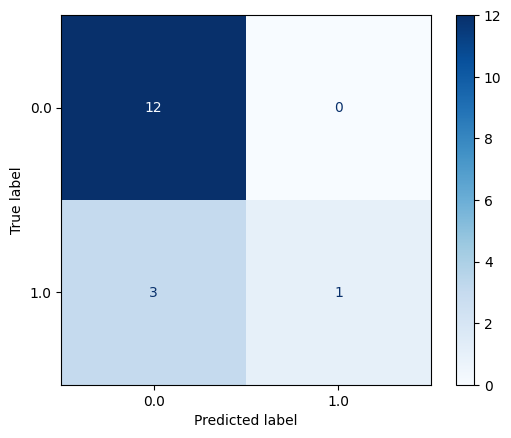

classification_report
              precision    recall  f1-score   support

         0.0       0.80      1.00      0.89        12
         1.0       1.00      0.25      0.40         4

    accuracy                           0.81        16
   macro avg       0.90      0.62      0.64        16
weighted avg       0.85      0.81      0.77        16


Train_Set
--------------------------------------


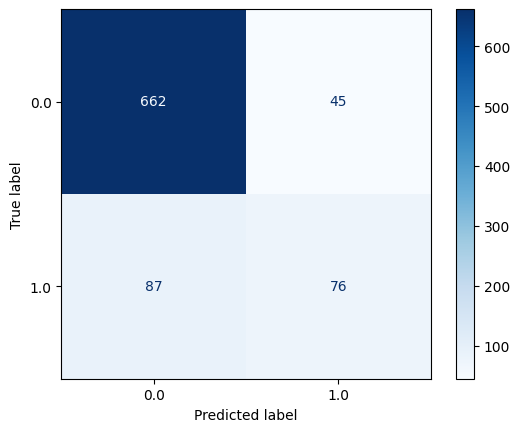

classification_report
              precision    recall  f1-score   support

         0.0       0.88      0.94      0.91       707
         1.0       0.63      0.47      0.54       163

    accuracy                           0.85       870
   macro avg       0.76      0.70      0.72       870
weighted avg       0.84      0.85      0.84       870



In [663]:
# fit default lr model
lr.fit(X_train_phase3, y_train)
eval_metric(lr, X_train_phase3, y_train, X_test_phase3, y_test_phase3)

In [664]:
p3_results = metric_df(lr, X_train_phase3, y_train, X_test_phase3, y_test_phase3, 'LR1 - P3')
p3_results.T

,accuracy,precision,recall,f1,auc,True Negative Rate,False Positive Rate,False Negative Rate,True Positive Rate
LR1 - P3,0.81,1.00,0.25,0.40,0.90,1.00,0.00,0.75,0.25


LR with default parameters is resulting in low F1 score.

### <span style="color:#55c667ff"> Logistic Regression - w/ GridSearchCV (phase 3) </span>

In [665]:
# logistic regression with gridsearch for best parameters
param_grid = [
    {'penalty':['l1','l2','elasticnet','none'],
    'C' : [0.9, 0.75, 0.3, 0.1, 0.01],
    'solver': ['lbfgs','newton-cg','liblinear'],
    'class_weight': ['balanced', None]
    }
]

clf = GridSearchCV(lr, param_grid, cv=5, verbose=1, n_jobs=-1, scoring='f1')
best_clf = clf.fit(X_train_phase3, y_train)
best_clf.best_estimator_

Fitting 5 folds for each of 120 candidates, totalling 600 fits


LogisticRegression(C=0.75, class_weight='balanced', random_state=42)

Test_Set
--------------------------------------


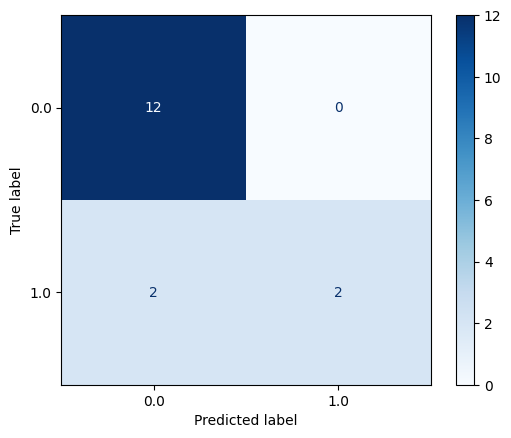

classification_report
              precision    recall  f1-score   support

         0.0       0.86      1.00      0.92        12
         1.0       1.00      0.50      0.67         4

    accuracy                           0.88        16
   macro avg       0.93      0.75      0.79        16
weighted avg       0.89      0.88      0.86        16


Train_Set
--------------------------------------


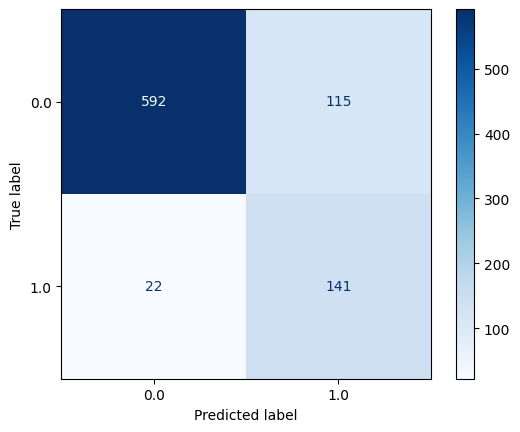

classification_report
              precision    recall  f1-score   support

         0.0       0.96      0.84      0.90       707
         1.0       0.55      0.87      0.67       163

    accuracy                           0.84       870
   macro avg       0.76      0.85      0.78       870
weighted avg       0.89      0.84      0.85       870



In [666]:
# applying best parameters
lr4 = LogisticRegression(C=0.75, class_weight='balanced', random_state=42)

lr4.fit(X_train_phase3, y_train)
eval_metric(lr4, X_train_phase3, y_train, X_test_phase3, y_test_phase3)

In [667]:
p3_results2 = metric_df(lr4, X_train_phase3, y_train, X_test_phase3, y_test_phase3, 'LR4 - P3')
p3_results = pd.concat([p3_results, p3_results2], axis=1, ignore_index=False)
p3_results.T

,accuracy,precision,recall,f1,auc,True Negative Rate,False Positive Rate,False Negative Rate,True Positive Rate
LR1 - P3,0.81,1.00,0.25,0.40,0.90,1.00,0.00,0.75,0.25
LR4 - P3,0.88,1.00,0.50,0.67,0.88,1.00,0.00,0.50,0.50


After fitting on best parameters, F1 increases significantly. 

### <span style="color:#55c667ff"> Random Forest - 1 (phase 3) </span>

Test_Set
--------------------------------------


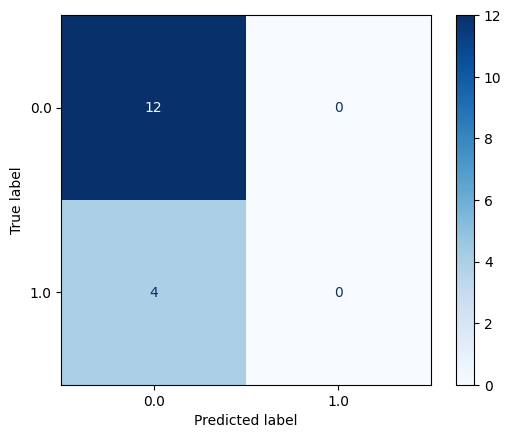

classification_report
              precision    recall  f1-score   support

         0.0       0.75      1.00      0.86        12
         1.0       0.00      0.00      0.00         4

    accuracy                           0.75        16
   macro avg       0.38      0.50      0.43        16
weighted avg       0.56      0.75      0.64        16


Train_Set
--------------------------------------


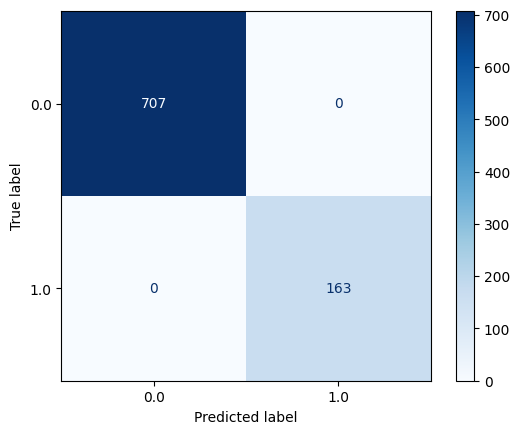

classification_report
              precision    recall  f1-score   support

         0.0       1.00      1.00      1.00       707
         1.0       1.00      1.00      1.00       163

    accuracy                           1.00       870
   macro avg       1.00      1.00      1.00       870
weighted avg       1.00      1.00      1.00       870



In [668]:
# fit to training data
rf.fit(X_train_phase3, y_train)

# get evaluation metrics
eval_metric(rf, X_train_phase3, y_train, X_test_phase3, y_test_phase3)

In [669]:
p3_results3 = metric_df(rf, X_train_phase3, y_train, X_test_phase3, y_test_phase3, 'RF - P3')
p3_results = pd.concat([p3_results, p3_results3], axis=1, ignore_index=False)
p3_results.T

,accuracy,precision,recall,f1,auc,True Negative Rate,False Positive Rate,False Negative Rate,True Positive Rate
LR1 - P3,0.81,1.00,0.25,0.40,0.90,1.00,0.00,0.75,0.25
LR4 - P3,0.88,1.00,0.50,0.67,0.88,1.00,0.00,0.50,0.50
RF - P3,0.75,0.00,0.00,0.00,0.84,1.00,0.00,1.00,0.00


Random Forest with default parameters is overfitting on the data. Fine tuning should elimate this issue and hopefully increase overall model scores. 

### <span style="color:#55c667ff"> Random Forest - w/ GridSearchCV (phase 3) </span>

In [670]:
# define parameters for grid search
param_grid = {
    'n_estimators': [30, 50,100,200],
    'criterion': ['gini', 'entropy', 'log_loss'],
    'max_depth': [1, 2, 3, 5, 7, None],
    'max_features': [1,3,5],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 3, 4],
    'class_weight': ['balanced', 'balanced_subsample', None]
}


# run grid search
grid_search = GridSearchCV(
    estimator=rf,
    param_grid=param_grid,
    scoring='f1',
    cv=5, n_jobs=-1)

best_rf = grid_search.fit(X_train_phase3, y_train)
best_rf.best_estimator_

RandomForestClassifier(class_weight='balanced_subsample', criterion='entropy',
                       max_depth=5, max_features=3, min_samples_split=5,
                       n_estimators=50, random_state=42)

Test_Set
--------------------------------------


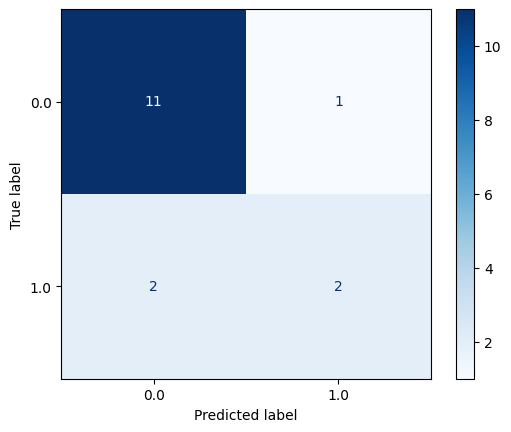

classification_report
              precision    recall  f1-score   support

         0.0       0.85      0.92      0.88        12
         1.0       0.67      0.50      0.57         4

    accuracy                           0.81        16
   macro avg       0.76      0.71      0.73        16
weighted avg       0.80      0.81      0.80        16


Train_Set
--------------------------------------


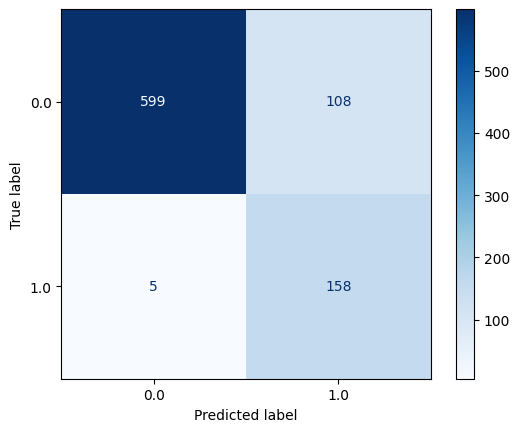

classification_report
              precision    recall  f1-score   support

         0.0       0.99      0.85      0.91       707
         1.0       0.59      0.97      0.74       163

    accuracy                           0.87       870
   macro avg       0.79      0.91      0.83       870
weighted avg       0.92      0.87      0.88       870



In [671]:
# fitting best parameters
rf5 = RandomForestClassifier(class_weight='balanced_subsample', criterion='entropy',
                       max_depth=5, max_features=3, min_samples_split=5,
                       n_estimators=50, random_state=42)

rf5.fit(X_train_phase3, y_train)
eval_metric(rf5, X_train_phase3, y_train, X_test_phase3, y_test_phase3)

In [672]:
# saving model results to df for evaluation
p3_results4 = metric_df(rf5, X_train_phase3, y_train, X_test_phase3, y_test_phase3, 'RF5 - P3')
p3_results = pd.concat([p3_results, p3_results4], axis=1, ignore_index=False)
p3_results.T

,accuracy,precision,recall,f1,auc,True Negative Rate,False Positive Rate,False Negative Rate,True Positive Rate
LR1 - P3,0.81,1.00,0.25,0.40,0.90,1.00,0.00,0.75,0.25
LR4 - P3,0.88,1.00,0.50,0.67,0.88,1.00,0.00,0.50,0.50
RF - P3,0.75,0.00,0.00,0.00,0.84,1.00,0.00,1.00,0.00
RF5 - P3,0.81,0.67,0.50,0.57,0.88,0.92,0.08,0.50,0.50


LR4 currently has the best scores in phase 3.

### <span style="color:#55c667ff"> AdaBoost w/ Default Parameters (phase 3) </span>

Test_Set
--------------------------------------


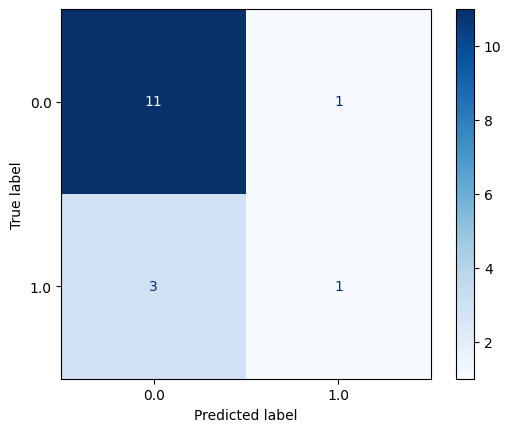

classification_report
              precision    recall  f1-score   support

         0.0       0.79      0.92      0.85        12
         1.0       0.50      0.25      0.33         4

    accuracy                           0.75        16
   macro avg       0.64      0.58      0.59        16
weighted avg       0.71      0.75      0.72        16


Train_Set
--------------------------------------


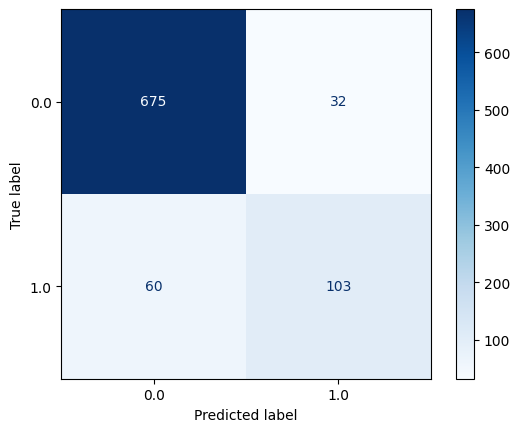

classification_report
              precision    recall  f1-score   support

         0.0       0.92      0.95      0.94       707
         1.0       0.76      0.63      0.69       163

    accuracy                           0.89       870
   macro avg       0.84      0.79      0.81       870
weighted avg       0.89      0.89      0.89       870



In [674]:
# initialize AdaBoostClassifier()
abc = AdaBoostClassifier(random_state=42)
abc.fit(X_train_phase3, y_train)

eval_metric(abc, X_train_phase3, y_train, X_test_phase3, y_test_phase3)

In [675]:
# saving model results to df for evaluation
p3_results5 = metric_df(abc, X_train_phase3, y_train, X_test_phase3, y_test_phase3, 'ABC 1 - P3')
p3_results = pd.concat([p3_results, p3_results5], axis=1, ignore_index=False)
p3_results.T

,accuracy,precision,recall,f1,auc,True Negative Rate,False Positive Rate,False Negative Rate,True Positive Rate
LR1 - P3,0.81,1.00,0.25,0.40,0.90,1.00,0.00,0.75,0.25
LR4 - P3,0.88,1.00,0.50,0.67,0.88,1.00,0.00,0.50,0.50
RF - P3,0.75,0.00,0.00,0.00,0.84,1.00,0.00,1.00,0.00
RF5 - P3,0.81,0.67,0.50,0.57,0.88,0.92,0.08,0.50,0.50
ABC 1 - P3,0.75,0.50,0.25,0.33,0.88,0.92,0.08,0.75,0.25


AdaBoostClassifier with default parameters returns lowest F1 score of all models in phase 3 and is not a good fit.

### <span style="color:#55c667ff"> AdaBoost w/ GridSearchCV (phase 3) </span>

In [676]:
# define parameters for grid search
param_grid = {
    'n_estimators': [30, 50, 100, 150, 200],
    'learning_rate': [0.97, 0.5, 0.3, 0.1, 0.05, 0.01],
    'algorithm': ['SAMME', 'SAMME.R']  
}

# run grid search
grid_search = GridSearchCV(
    estimator=abc,
    param_grid=param_grid,
    scoring='f1',
    cv=5, n_jobs=-1)

best_abc = grid_search.fit(X_train_phase3, y_train)
best_abc.best_estimator_

AdaBoostClassifier(learning_rate=0.97, n_estimators=30, random_state=42)

Test_Set
--------------------------------------


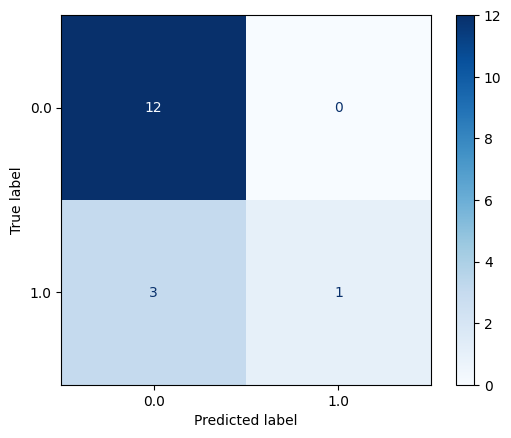

classification_report
              precision    recall  f1-score   support

         0.0       0.80      1.00      0.89        12
         1.0       1.00      0.25      0.40         4

    accuracy                           0.81        16
   macro avg       0.90      0.62      0.64        16
weighted avg       0.85      0.81      0.77        16


Train_Set
--------------------------------------


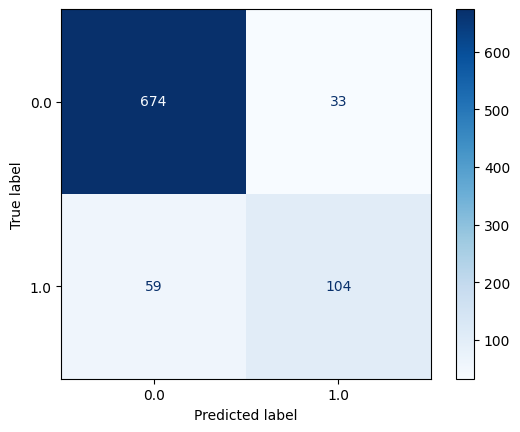

classification_report
              precision    recall  f1-score   support

         0.0       0.92      0.95      0.94       707
         1.0       0.76      0.64      0.69       163

    accuracy                           0.89       870
   macro avg       0.84      0.80      0.81       870
weighted avg       0.89      0.89      0.89       870



In [681]:
# fitting best parameters
abc4 = AdaBoostClassifier(learning_rate=0.97, n_estimators=150, random_state=42)
abc4.fit(X_train_phase3, y_train)

eval_metric(abc4, X_train_phase3, y_train, X_test_phase3, y_test_phase3)

In [682]:
# saving model results to df for evaluation
p3_results6 = metric_df(abc4, X_train_phase3, y_train, X_test_phase3, y_test_phase3, 'ABC 2 - P3')
p3_results = pd.concat([p3_results, p3_results6], axis=1, ignore_index=False)
p3_results.T

,accuracy,precision,recall,f1,auc,True Negative Rate,False Positive Rate,False Negative Rate,True Positive Rate
LR1 - P3,0.81,1.00,0.25,0.40,0.90,1.00,0.00,0.75,0.25
LR4 - P3,0.88,1.00,0.50,0.67,0.88,1.00,0.00,0.50,0.50
RF - P3,0.75,0.00,0.00,0.00,0.84,1.00,0.00,1.00,0.00
RF5 - P3,0.81,0.67,0.50,0.57,0.88,0.92,0.08,0.50,0.50
ABC 1 - P3,0.75,0.50,0.25,0.33,0.88,0.92,0.08,0.75,0.25
ABC 2 - P3,0.81,1.00,0.25,0.40,0.88,1.00,0.00,0.75,0.25


The parameters returned by grid search overfit on the model. So, the n_estimators was manually tuned, but results are still not as good as the LR4 model.

### <span style="color:#55c667ff"> XGBoost w/ Default Parameters (phase 3) </span>

Test_Set
--------------------------------------


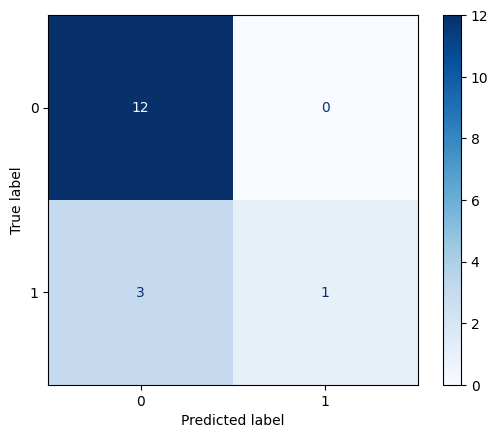

classification_report
              precision    recall  f1-score   support

         0.0       0.80      1.00      0.89        12
         1.0       1.00      0.25      0.40         4

    accuracy                           0.81        16
   macro avg       0.90      0.62      0.64        16
weighted avg       0.85      0.81      0.77        16


Train_Set
--------------------------------------


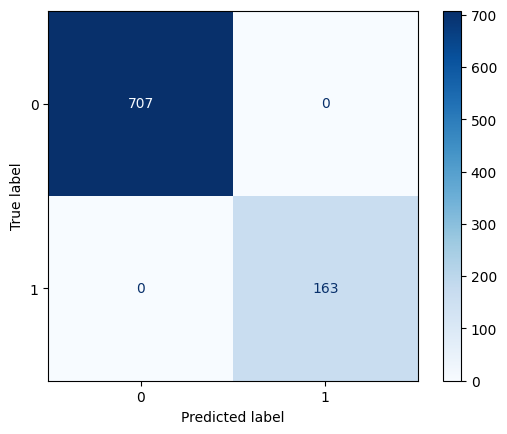

classification_report
              precision    recall  f1-score   support

         0.0       1.00      1.00      1.00       707
         1.0       1.00      1.00      1.00       163

    accuracy                           1.00       870
   macro avg       1.00      1.00      1.00       870
weighted avg       1.00      1.00      1.00       870



In [683]:
# fit xgb on phase 3 data
xgb.fit(X_train_phase3, y_train)

# get evaluation metrics
eval_metric(xgb, X_train_phase3, y_train, X_test_phase3, y_test_phase3)

Default parameters are overfitting. Finetuning is needed to determine XGBoost is viable for this data.

In [684]:
# saving model results to df for evaluation
p3_results7 = metric_df(xgb, X_train_phase3, y_train, X_test_phase3, y_test_phase3, 'XGB 1 - P3')
p3_results = pd.concat([p3_results, p3_results7], axis=1, ignore_index=False)
p3_results.T

,accuracy,precision,recall,f1,auc,True Negative Rate,False Positive Rate,False Negative Rate,True Positive Rate
LR1 - P3,0.81,1.00,0.25,0.40,0.90,1.00,0.00,0.75,0.25
LR4 - P3,0.88,1.00,0.50,0.67,0.88,1.00,0.00,0.50,0.50
RF - P3,0.75,0.00,0.00,0.00,0.84,1.00,0.00,1.00,0.00
RF5 - P3,0.81,0.67,0.50,0.57,0.88,0.92,0.08,0.50,0.50
ABC 1 - P3,0.75,0.50,0.25,0.33,0.88,0.92,0.08,0.75,0.25
ABC 2 - P3,0.81,1.00,0.25,0.40,0.88,1.00,0.00,0.75,0.25
XGB 1 - P3,0.81,1.00,0.25,0.40,0.85,1.00,0.00,0.75,0.25


### <span style="color:#55c667ff"> XGBoost w/ GridSearchCV (phase 3) </span>

In [685]:
param_grid = {
    'max_depth': [1, 2, 3, 5],
    'learning_rate': [0.97, 0.5, 0.3, 0.1],
    'subsample': [0.1, 0.2, 0.3, 0.5],
    'gamma': [0.1, 0.3, 0.5]
    }

grid_search = GridSearchCV(
    estimator=xgb,
    param_grid=param_grid,
    scoring='f1',
    cv=5,
    n_jobs=-1
    )

best_xgb = grid_search.fit(X_train_phase3, y_train)

best_xgb.best_params_

{'gamma': 0.1, 'learning_rate': 0.5, 'max_depth': 1, 'subsample': 0.5}

Test_Set
--------------------------------------


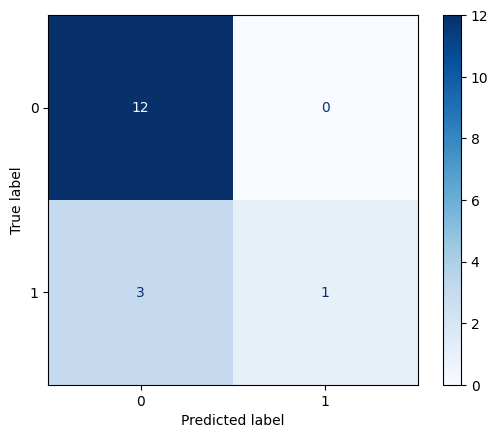

classification_report
              precision    recall  f1-score   support

         0.0       0.80      1.00      0.89        12
         1.0       1.00      0.25      0.40         4

    accuracy                           0.81        16
   macro avg       0.90      0.62      0.64        16
weighted avg       0.85      0.81      0.77        16


Train_Set
--------------------------------------


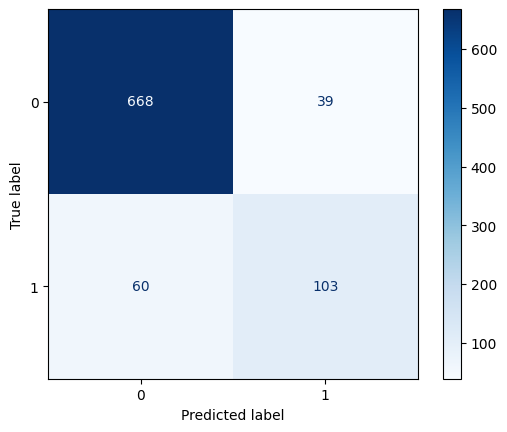

classification_report
              precision    recall  f1-score   support

         0.0       0.92      0.94      0.93       707
         1.0       0.73      0.63      0.68       163

    accuracy                           0.89       870
   macro avg       0.82      0.79      0.80       870
weighted avg       0.88      0.89      0.88       870



In [686]:
# fitting best parameters
xgb4 = XGBClassifier(gamma=0.1, learning_rate= 0.5, max_depth=1, subsample=0.5, random_state=42)
xgb4.fit(X_train_phase3, y_train)
eval_metric(xgb4, X_train_phase3, y_train, X_test_phase3, y_test_phase3)

In [687]:
# saving model results to df for evaluation
p3_results8 = metric_df(xgb4, X_train_phase3, y_train, X_test_phase3, y_test_phase3, 'XGB 2 - P3')
p3_results = pd.concat([p3_results, p3_results8], axis=1, ignore_index=False)
p3_results.T

,accuracy,precision,recall,f1,auc,True Negative Rate,False Positive Rate,False Negative Rate,True Positive Rate
LR1 - P3,0.81,1.00,0.25,0.40,0.90,1.00,0.00,0.75,0.25
LR4 - P3,0.88,1.00,0.50,0.67,0.88,1.00,0.00,0.50,0.50
RF - P3,0.75,0.00,0.00,0.00,0.84,1.00,0.00,1.00,0.00
RF5 - P3,0.81,0.67,0.50,0.57,0.88,0.92,0.08,0.50,0.50
ABC 1 - P3,0.75,0.50,0.25,0.33,0.88,0.92,0.08,0.75,0.25
ABC 2 - P3,0.81,1.00,0.25,0.40,0.88,1.00,0.00,0.75,0.25
XGB 1 - P3,0.81,1.00,0.25,0.40,0.85,1.00,0.00,0.75,0.25
XGB 2 - P3,0.81,1.00,0.25,0.40,0.88,1.00,0.00,0.75,0.25


As of right now it seems as though LR4 is providing the best model for phase 3. 

## <span style="color:#287D8EFF">8.2 Phase 3: Visualizing Model Results</span> 

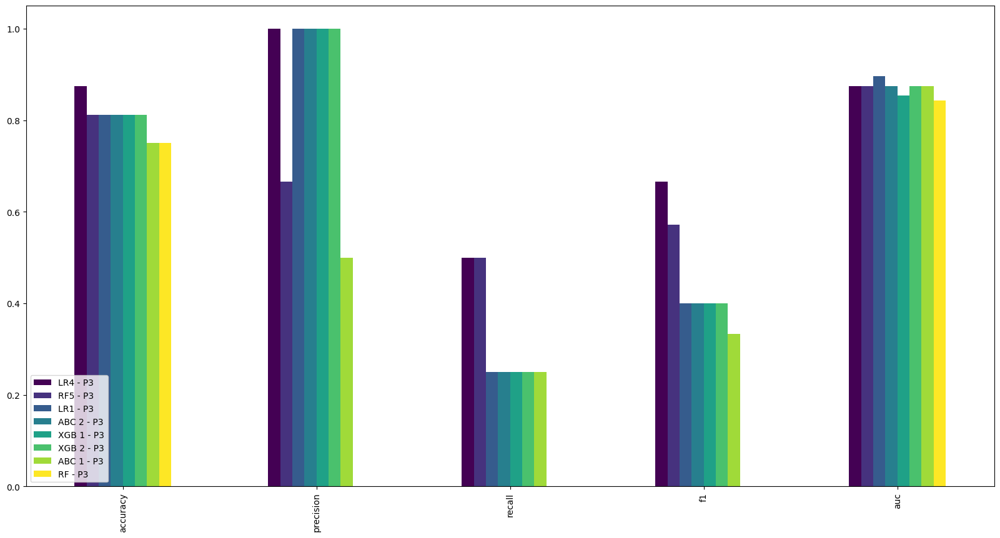

In [688]:
# Plotting Model Results for Comparison
p3_results[:5].sort_values(by='f1', axis=1, ascending=False).plot.bar(figsize = (20,10), cmap="viridis")
plt.legend(loc="lower left")
plt.show()

After testing several models, LR4 and RF5 still produce the best results in phase 3. 

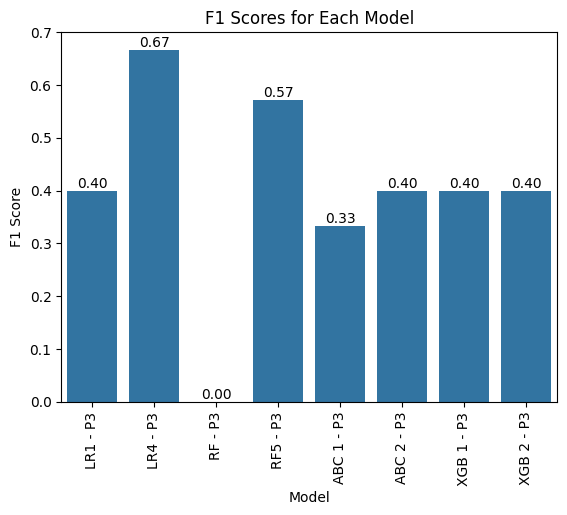

In [689]:
# comparing f1 scores
f1_scores = p3_results.loc['f1']
sns.barplot(x=f1_scores.index, y=f1_scores.values)
plt.title('F1 Scores for Each Model')
plt.xlabel('Model')
plt.xticks(rotation=90)
plt.ylabel('F1 Score')
bar_labels = [f'{value:.2f}' for value in f1_scores]
plt.bar_label(plt.gca().containers[0], labels=bar_labels)
plt.show()

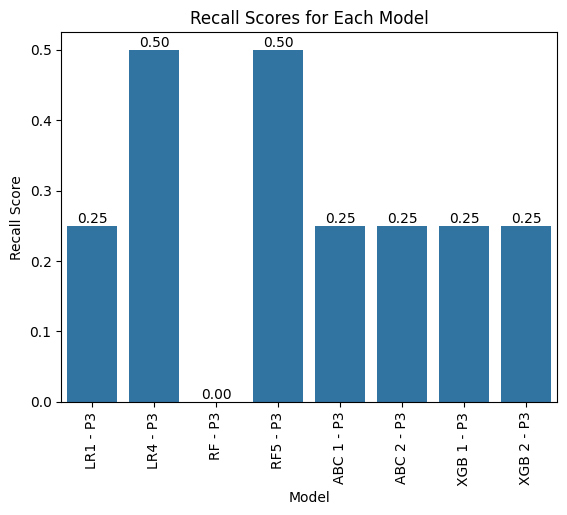

In [690]:
# comparing recall scores
recall_scores = p3_results.loc['recall']
sns.barplot(x=recall_scores.index, y=recall_scores.values)
plt.title('Recall Scores for Each Model')
plt.xlabel('Model')
plt.xticks(rotation=90)
plt.ylabel('Recall Score')
bar_labels = [f'{value:.2f}' for value in recall_scores]
plt.bar_label(plt.gca().containers[0], labels=bar_labels)
plt.show()

LR4 is the best model with the highest F1, AUC, and Recall scores for all models in phase 2.

## <span style="color:#287D8EFF">8.3 Phase 3: Feature Importance</span> 

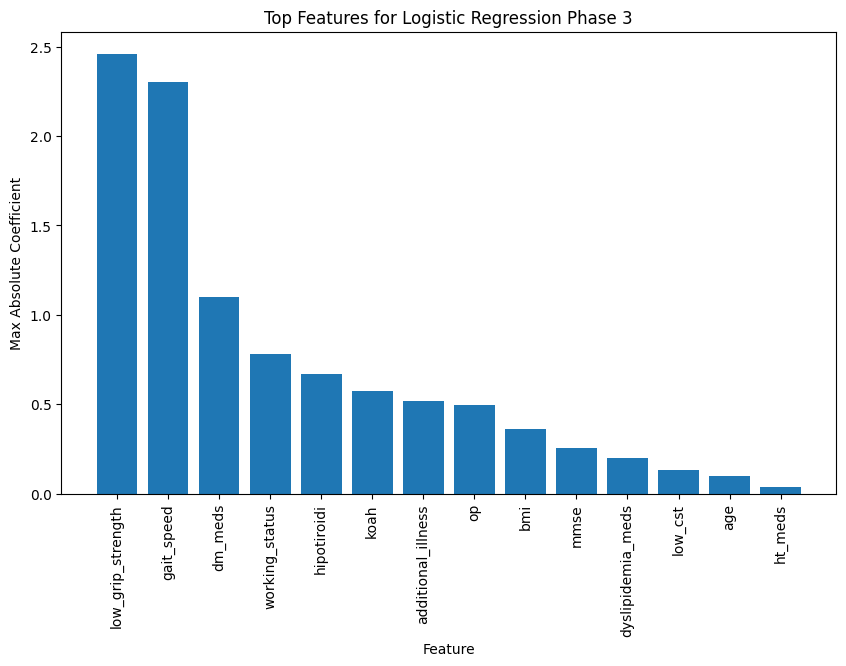

In [692]:
# get the coefficients for all classes
coefficients = lr4.coef_

# create a dataframe for each class's coefficients
feature_importance = pd.DataFrame(coefficients.T, columns=[f'Class_{i}' for i in range(coefficients.shape[0])])
feature_importance['Feature'] = X_train_phase3.columns

# calculate the overall importance using max absolute coefficient across classes
feature_importance['Max_Abs_Coefficient'] = np.max(np.abs(coefficients), axis=0)

# sort by overall importance
feature_importance = feature_importance.sort_values(by='Max_Abs_Coefficient', ascending=False)

# select features with non-zero coefficients for any class
selected_features = feature_importance[
    (feature_importance.iloc[:, :-2] != 0).any(axis=1)
]

# plot top 10 features
plt.figure(figsize=(10, 6))
plt.bar(selected_features['Feature'], selected_features['Max_Abs_Coefficient'])
plt.xlabel('Feature')
plt.ylabel('Max Absolute Coefficient')
plt.xticks(rotation=90)
plt.title('Top Features for Logistic Regression Phase 3')
plt.show()

Features for phase 3 will not be reduced. Variables from phase 2 were enough to indicate the patient needed further testing. When adding in the clinical exam results, we see an increase in scoring metrics for the Logistic Regression Model. LR4 will be saved as the phase 3 model.

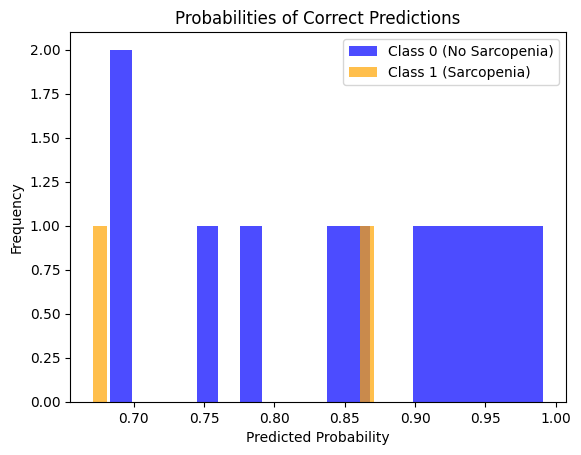

In [694]:
# extracting probabilities for lr4 model phase 3
phase3_probabilities = lr4.predict_proba(X_test_phase3)

# getting predicted classes
phase3_predictions = lr4.predict(X_test_phase3)

# getting correct predictions
phase3_correct = (phase3_predictions == y_test_phase3)

# filtering probabilities where predictions were correct
correct_probs = phase3_probabilities[phase3_correct]

# probabilities for each class
correct_probs_0 = correct_probs[y_test_phase3[phase3_correct] == 0, 0]
correct_probs_1 = correct_probs[y_test_phase3[phase3_correct] == 1, 1]

# visualize probabilities for correct predictions to determine thresholds
plt.hist(correct_probs_0, bins=20, alpha=0.7, label='Class 0 (No Sarcopenia)', color='blue')
plt.hist(correct_probs_1, bins=20, alpha=0.7, label='Class 1 (Sarcopenia)', color='orange')

plt.xlabel("Predicted Probability")
plt.ylabel("Frequency")
plt.title("Probabilities of Correct Predictions")
plt.legend()
plt.show()

## <span style="color:#287D8EFF">8.4 Saving Phase 3 Model and Preprocessor</span> 

In [693]:
# saving phase 3 model
dump(lr4, open('sarcopenia_phase3.pkl', 'wb'))

# save preprocessor 
dump(p3_preprocessor, open('sarcopenia_p3_preprocessor.pkl', 'wb'))

# <span style="color:#29AF7FFF">9. Conclusion</span>

<a id="9"></a>
<a href="#toc" class="btn btn-primary btn-sm" role="button" aria-pressed="true"
style="color:blue; background-color:#d9dddc" data-toggle="popover">Content</a>

## <span style="color:#287d8eff">Summary of Findings</span>

With the final model we will be able to say confidently that the patient likely has sarcopenia based on the selected features. If a patient passes through all 3 phases we then confirm with STAR. If patient is inconclusive in Phase 2, but results as no sarcopenia in phase 3, suggest preventative measures to prevent progression of or existence of sarcopenia.